# getting dataset


In [ ]:
!git clone 'https://github.com/timqqt/pytorch-zoom-in-network.git'

fatal: destination path 'pytorch-zoom-in-network' already exists and is not an empty directory.


In [ ]:
!git clone 'https://github.com/MuniNihitha/cancer-detection.git'

fatal: destination path 'cancer-detection' already exists and is not an empty directory.


In [ ]:
import os
import math
import torch
from torch import nn
from torch.nn import functional as F
from IPython.display import display
import cv2 as cv

In [ ]:
folders = sorted(os.listdir('/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Classification/'))
if '.DS_Store' in folders:
    folders.remove('.DS_Store')
print(folders[:3])

['img1', 'img10', 'img100']


creating a list of location of images to be used later

In [ ]:
images_list = ['/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Classification/'+img+'/'+img+".bmp" for img in folders]
print(images_list[:3])

['/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Classification/img1/img1.bmp', '/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Classification/img10/img10.bmp', '/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Classification/img100/img100.bmp']


In [ ]:
!pip install openslide-python

In [ ]:
!pip install progress

# Model/Code

##Dataset

### colon_cancer_dataset

In [ ]:
from torchvision import transforms, datasets
from cv2 import imread, imwrite, resize, INTER_LINEAR
from skimage.io import imsave
from skimage.draw import polygon as ski_polygon
from sklearn.metrics import roc_auc_score
from skimage.filters import threshold_otsu
from itertools import zip_longest
from math import floor
# import openslide as ops
import warnings as ws
import numpy as np
import random
import torch
import h5py
import math
import cv2
import os
import time
import csv
import logging
import os
import xml.etree.ElementTree as Xml
from collections import OrderedDict, defaultdict, namedtuple
from typing import Sequence, Any, Tuple

import fnmatch
import logging
import os
from collections import namedtuple
from typing import Dict

from PIL import Image
from PIL import ImageDraw
from progress.bar import IncrementalBar

# import openslide
from PIL import Image
class OpenHisto:
    '''
    Read one histopathology image
    '''
    def __init__(self, directory,
                 data_transform=transforms.Compose([
                                transforms.ToPILImage(),
                                transforms.ToTensor(),
                            ])):
        idx = folders.index(directory.split('/')[-1][:-4])
        directory = images_list[idx]
        self.d = directory
        self.img = np.asarray(imread(directory))
        self.data_transform = data_transform

    def read_region(self, pos, level, size):
        '''
        x, y are the cardinality axis: x for column and y for rows
        :param x: x location
        :param y: y location
        :param level: the view we are looking right now
        :param size: size of patch
        :return:
        '''
        x, y = pos
        factor = np.around(2 ** level)
        y1_, y2_ = max(y, 0), min(self.img.shape[0]-1, y+int(size[1]*factor))
        x1_, x2_ = max(x, 0), min(self.img.shape[1]-1, x+int(size[0]*factor))
        # print("in read_region", self.img.shape)
        patch = self.img[max(y, 0) : min(self.img.shape[0]-1, y+int(size[1]*factor)),
                         max(x, 0) : min(self.img.shape[1]-1, x+int(size[0]*factor)), :]
        # print("in read_region patch 1", patch.shape)
        if patch.shape != size:
            patch = np.pad(patch, ((max(0-y, 0), max(min(y+int(size[1]*factor)+1-self.img.shape[0], int(size[1]*factor)), 0)),
                                   (max(0-x, 0), max(min(x+int(size[0]*factor)+1-self.img.shape[1], int(size[0]*factor)), 0)), (0, 0)))
            # y1_, y2_ = max(0-y, 0), max(min(y+int(size[1]*factor)+1-self.img.shape[0], int(size[1]*factor)), 0)
            # x1_, x2_ = max(0-x, 0), max(min(x+int(size[0]*factor)+1-self.img.shape[1], int(size[0]*factor)), 0)
        if level != 0:
            patch = resize(patch, (int(patch.shape[0]//factor), int(patch.shape[1]//factor)), INTER_LINEAR)
            # PATCHES_['LEVEL_non_0'].append((y1_, y2_, x1_, x2_, patch))
        # else:
        #   PATCHES_['LEVEL_0'].append((y1_, y2_, x1_, x2_, patch))
        # print("in read_region", patch.shape)
        return patch

    def extract_patches(self, x, y, level=0, size=(50, 50), show_mode='channel_first'):
        '''
        Read patches from one gigapixel image
        Should read the patches from the center
        :return:
        '''
        '''
        return img.read_region((int(x), int(y)), level, size)
        '''

        this_patch = np.asarray(self.read_region((int(x), int(y)), level, size))[:, :, :3].astype(np.uint8)
        if self.data_transform is not None:
            this_patch = self.data_transform(this_patch)
        return this_patch


    def get_mask(self, level=0):
        assert False, "get pixel-level annotationsn is not implemented"
        return

    def get_patches(self, x, y, level=0, size=(0, 0), show_mode='channel_first'):
        '''
        :param x: a list of x-axis for patches. (batch_dim, [num_of_patches for one image])
        :param y: a list of y-axis for patches. (batch_dim, [num_of_patches for one image])
        :param level:
        :param size:
        :return:
        '''
        return self.extract_patches(x, y, level=level, size=size, show_mode=show_mode)

    def get_size(self):
        # display("open_histo ->get_size1", self.d, self.img.shape)
        return self.img.shape

class HistoPatchwiseReader:
    '''
    Reading NCAM Images by Fanjie Kong
    '''
    # Now we only support batch size 1 just for simplicity
    def __init__(self, directory, annotation_name='annotations.csv', batch_size=1, train=False):
        self.batch_size = batch_size
        self.directory = directory
        self.annotations = os.path.join(directory, annotation_name)
        self.cur_batch = None
        self.__cur_name = None
        self.train = train
        self.img_gen = self.generator()
        self.data_list = self._get_data()


    def __len__(self): return int(len(self.data_list)//self.batch_size)

    def _get_data(self):

        data_list = []
        annotations = np.loadtxt(self.annotations, delimiter=None, dtype=str)
        for e_ann in annotations:
            img_dir, label = e_ann.split(',')
            data_list.append((img_dir, int(label)))
        return data_list

    def _batcher(self, inputs, batch_size=1, fillvalue=None):
        inputs = iter(inputs)
        args = [iter(inputs)] * batch_size
        return zip_longest(fillvalue=fillvalue, *args)

    def _get_cur_name(self):
        return self.__cur_name

    def generator(self):
        if self.train:
            np.random.shuffle(self.data_list)
        dataGenerator = self._batcher(self.data_list, self.batch_size)
        while dataGenerator:
            try:
                self.cur_batch = next(dataGenerator)
                self.__cur_name = self.cur_batch[0][0]
                self.cur_batch = self._DataPathtoData(self.cur_batch)
                yield self.cur_batch
            except StopIteration:
                print('Finished this epoch')
                break

    def _DataPathtoData(self, batch):
        '''
        :param batch:
        :return: reading data from the file path in batch
        '''
        new_batch = []
        #print(os.path.join(self.directory, batch[0][0]))
        for e_b in batch:
            if e_b is not None:
                new_batch.append((OpenHisto(os.path.join(self.directory, e_b[0])), e_b[1]))
        return new_batch

### custom_dataset

In [ ]:
from torchvision import transforms, datasets
from cv2 import imread, imwrite, resize, INTER_LINEAR
from skimage.io import imsave
from skimage.draw import polygon as ski_polygon
from sklearn.metrics import roc_auc_score
from skimage.filters import threshold_otsu
from itertools import zip_longest
from math import floor
# import openslide as ops
import warnings as ws
import numpy as np
import random
import torch
import h5py
import math
import cv2
import os
import time
import csv
import logging
import os
import xml.etree.ElementTree as Xml
from collections import OrderedDict, defaultdict, namedtuple
from typing import Sequence, Any, Tuple

import fnmatch
import logging
import os
from collections import namedtuple
from typing import Dict

from PIL import Image
from PIL import ImageDraw
from progress.bar import IncrementalBar

# import openslide
from PIL import Image
class OpenImage:
    '''
    Read one histopathology image
    '''
    def __init__(self, directory,
                 data_transform=transforms.Compose([
                                transforms.ToPILImage(),
                                transforms.ToTensor(),
                            ])):
        self.img = np.asarray(imread(directory))
        self.data_transform = data_transform

    def read_region(self, pos, level, size):
        '''
        x, y are the cardinality axis: x for column and y for rows
        :param x: x location
        :param y: y location
        :param level: the view we are looking right now
        :param size: size of patch
        :return:
        '''
        x, y = pos
        factor = np.around(2 ** level)
        #print("in read_region", self.img.shape)
        patch = self.img[max(y, 0) : min(self.img.shape[0]-1, y+int(size[1]*factor)),
                         max(x, 0) : min(self.img.shape[1]-1, x+int(size[0]*factor)), :]
        #print("in read_region patch 1", patch.shape)
        if patch.shape != size:
            patch = np.pad(patch, ((max(0-y, 0), max(min(y+int(size[1]*factor)+1-self.img.shape[0], int(size[1]*factor)), 0)),
                                   (max(0-x, 0), max(min(x+int(size[0]*factor)+1-self.img.shape[1], int(size[0]*factor)), 0)), (0, 0)))
        if level != 0:
            patch = resize(patch, (int(patch.shape[0]//factor), int(patch.shape[1]//factor)), INTER_LINEAR)
        #print("in read_region", patch.shape)
        return patch

    def extract_patches(self, x, y, level=0, size=(50, 50), show_mode='channel_first'):
        '''
        Read patches from one gigapixel image
        Should read the patches from the center
        :return:
        '''
        '''
        return img.read_region((int(x), int(y)), level, size)
        '''

        this_patch = np.asarray(self.read_region((int(x), int(y)), level, size))[:, :, :3].astype(np.uint8)
        if self.data_transform is not None:
            this_patch = self.data_transform(this_patch)
        return this_patch


    def get_mask(self, level=0):
        assert False, "get pixel-level annotationsn is not implemented"
        return

    def get_patches(self, x, y, level=0, size=(0, 0), show_mode='channel_first'):
        '''
        :param x: a list of x-axis for patches. (batch_dim, [num_of_patches for one image])
        :param y: a list of y-axis for patches. (batch_dim, [num_of_patches for one image])
        :param level:
        :param size:
        :return:
        '''
        return self.extract_patches(x, y, level=level, size=size, show_mode=show_mode)

    def get_size(self):
        return self.img.shape

class OpenGigapixel:
    '''
    Read one Camelyon16 reader
    '''
    def __init__(self, directory,
                 data_transform=transforms.Compose([
                                transforms.ToPILImage(),
                                transforms.ToTensor(),
                            ])):
        self.img = ops.OpenSlide(os.path.join(directory))
        self.cur_name = directory
        self.data_transform = data_transform

    def extract_patches(self, x, y, level=0, size=(50, 50), show_mode='channel_first'):
        '''
        Read patches from one gigapixel image
        Should read the patches from the center
        :return:
        '''
        '''
        return img.read_region((int(x), int(y)), level, size)
        '''

        this_patch = np.asarray(self.img.read_region((int(x), int(y)), level, size))[:, :, :3].astype(np.uint8)
        if self.data_transform is not None:
            this_patch = self.data_transform(this_patch)
        return this_patch


    def get_mask(self, level=0):
        assert False, "get pixel-level annotationsn is not implemented"
        return

    def get_patches(self, x, y, level=0, size=(0, 0), show_mode='channel_first'):
        '''
        :param x: a list of x-axis for patches. (batch_dim, [num_of_patches for one image])
        :param y: a list of y-axis for patches. (batch_dim, [num_of_patches for one image])
        :param level:
        :param size:
        :return:
        '''
        return self.extract_patches(x, y, level=level, size=size, show_mode=show_mode)

    def get_size(self):
        return self.img.dimensions

    def _get_cur_name(self):
        return self.cur_name

    def find_roi_normal(self, rgb_image):
        # self.mask = cv2.cvtColor(self.mask, cv2.CV_32SC1)
        hsv = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2HSV)
        # [20, 20, 20]
        lower_red = np.array([30, 30, 30])
        # [255, 255, 255]
        upper_red = np.array([200, 200, 200])
        mask = cv2.inRange(hsv, lower_red, upper_red)
        res = cv2.bitwise_and(rgb_image, rgb_image, mask=mask)

        # (50, 50)
        close_kernel = np.ones((50, 50), dtype=np.uint8)
        #close_kernel_tmp = np.ones((30, 30), dtype=np.uint8)
        image_close = Image.fromarray(cv2.morphologyEx(np.array(mask), cv2.MORPH_CLOSE, close_kernel))
        # (30, 30)
        open_kernel = np.ones((30, 30), dtype=np.uint8)
        image_open = Image.fromarray(cv2.morphologyEx(np.array(image_close), cv2.MORPH_OPEN, open_kernel))
        return image_open

    def get_preprocessed_locations_v2(self, frame_size, mask_level=4):
        '''
        :param frame_size: size of one frame
        :param mask_level:  the shrink level of the binary mask
        :return:
        '''
        # Binary the map
        # Get the location
        name = self._get_cur_name()
        binary_mask_dir = os.path.join(self._get_cur_name().replace('.tif', 'frame_size_'+str(frame_size[0])+'level_'+str(mask_level)+'_binary.png'))

        if os.path.isfile(binary_mask_dir):
            b_mask =  np.asarray(imread(binary_mask_dir))
        else:
            img = self.img
            lowimg = np.asarray(img.read_region((int(0), int(0)), mask_level, img.level_dimensions[mask_level]))
            mask = np.asarray(self.find_roi_normal(lowimg))
            imsave(binary_mask_dir, mask.astype(np.int), check_contrast=False)
            b_mask = mask
        size_img = self.get_size()
        x = np.arange(0, size_img[0], frame_size[0])
        y = np.arange(0, size_img[1], frame_size[1])
        xx, yy = np.meshgrid(x, y)
        loc_list = [(xx.flatten()[i], yy.flatten()[i]) for i in range(len(xx.flatten()[:]))]
        locs_array = np.array(loc_list)
        # filter
        filtered_locs_array = []
        for each_loc in locs_array:
            mapped_loc = np.floor(each_loc // 2**mask_level)
            ROI_exist = b_mask[int(mapped_loc[1]): int(mapped_loc[1])+int(np.floor(frame_size[0] // 2**mask_level)) - 1,
            int(mapped_loc[0]): int(mapped_loc[0]) + int(np.floor(frame_size[1] // 2**mask_level)) - 1].sum() > 0
            if ROI_exist:
                filtered_locs_array.append(each_loc)
        filtered_locs_array = np.array(filtered_locs_array)
        return filtered_locs_array

class CustomDataReader:
    '''

    '''
    # Now we only support batch size 1 just for simplicity
    def __init__(self, directory, annotation_name='annotations.csv', batch_size=1, train=False, reader_type=None):
        self.batch_size = batch_size
        self.directory = directory
        self.annotations = os.path.join(directory, annotation_name)
        self.cur_batch = None
        self.__cur_name = None
        self.train = train
        self.reader = OpenImage if reader_type is None else OpenGigapixel
        self.img_gen = self.generator()
        self.data_list = self._get_data()


    def __len__(self): return int(len(self.data_list)//self.batch_size)

    def _get_data(self):

        data_list = []
        annotations = np.loadtxt(self.annotations, delimiter='\n', dtype=str)
        for e_ann in annotations:
            img_dir, label = e_ann.split(',')
            data_list.append((img_dir, int(label)))
        return data_list

    def _batcher(self, inputs, batch_size=1, fillvalue=None):
        inputs = iter(inputs)
        args = [iter(inputs)] * batch_size
        return zip_longest(fillvalue=fillvalue, *args)

    def _get_cur_name(self):
        return self.__cur_name

    def generator(self):
        if self.train:
            np.random.shuffle(self.data_list)
        dataGenerator = self._batcher(self.data_list, self.batch_size)
        while dataGenerator:
            try:
                self.cur_batch = next(dataGenerator)
                self.__cur_name = self.cur_batch[0][0]
                self.cur_batch = self._DataPathtoData(self.cur_batch)
                yield self.cur_batch
            except StopIteration:
                print('Finished this epoch')
                break

    def _DataPathtoData(self, batch):
        '''
        :param batch:
        :return: reading data from the file path in batch
        '''
        new_batch = []
        #print(os.path.join(self.directory, batch[0][0]))
        for e_b in batch:
            if e_b is not None:
                new_batch.append((OpenHisto(os.path.join(self.directory, e_b[0])), e_b[1]))
        return new_batch

## Models

### attention_models

In [ ]:
import math
import torch
from torch import nn
from torch.nn import functional as F

padding = 0
class Attention(torch.nn.Sequential):
    def __init__(self, no_softmax=False):
        super(Attention, self).__init__()
        # self.unet_1 = UNet(n_class=3, in_ch=3)
        # self.unet_2 = UNet(n_class=3, in_ch=1)
        # self.padding = 2
        self.no_softmax = no_softmax
        self.layers = \
            torch.nn.Sequential(
                torch.nn.Conv2d(3, 8, kernel_size=3, padding=(1, 1)),
                torch.nn.ReLU(inplace=True),
                torch.nn.Conv2d(8, 8, kernel_size=3, padding=(1, 1)),
                torch.nn.ReLU(inplace=True),
                torch.nn.Conv2d(8, 1, kernel_size=3, padding=(1, 1)),
            )
        self.layers2 = \
            torch.nn.Sequential(
                torch.nn.Conv2d(1, 8, kernel_size=3, padding=(1, 1)),
                torch.nn.ReLU(inplace=True),
                torch.nn.Conv2d(8, 8, kernel_size=3, padding=(1, 1)),
                torch.nn.ReLU(inplace=True),
                torch.nn.Conv2d(8, 1, kernel_size=3, padding=(1, 1)),
            )

    def forward(self, x):
        if x.shape[1] == 3:
            x = self.layers(x)
        elif x.shape[1] == 1:
            x = self.layers2(x)
        xs = x.shape
        if self.no_softmax:
            return x.view(xs)
        else:
            x = F.softmax(x.view(x.shape[0], -1), dim=1)
            return x.view(xs)




class AttentionOnAttention(torch.nn.Sequential):
    def __init__(self):
        super(AttentionOnAttention, self).__init__()
        self.layers1 = \
            torch.nn.Sequential(
                torch.nn.Conv2d(3, 8, kernel_size=3, padding=(1, 1)),
                torch.nn.ReLU(),
                torch.nn.Conv2d(8, 8, kernel_size=3, padding=(1, 1)),
                torch.nn.ReLU(),
                torch.nn.Conv2d(8, 1, kernel_size=3, padding=(1, 1)),
            )


    def forward(self, x):

        x = self.layers1(x)
        x = F.adaptive_avg_pool2d(x, (1, 1))
        x = x.squeeze(1).squeeze(1).squeeze(1)
        return x

### classifier

In [ ]:
import torch
import torch.nn as nn
from torch.nn import functional as F

class Classifier(torch.nn.Sequential):
    def __init__(self, num_classes=10):
        super(Classifier, self).__init__()
        self.layers = \
            torch.nn.Sequential(
            torch.nn.Linear(48, num_classes)
            )

    def forward(self, x):
        x = self.layers(x)
        prediction = F.softmax(x)
        return x, prediction

### Feature extractor

In [ ]:
import math
import torch
from torch import nn
from torch.nn import functional as F

padding = 0

def conv_layer(in_channels, out_channels, kernel, strides, padding=1):
    return nn.Conv2d(in_channels, out_channels, kernel_size=kernel, stride=strides, padding_mode="zeros", bias=False,
                     padding=padding)


def batch_norm(filters):
    return nn.BatchNorm2d(filters)


def relu():
    return nn.ReLU()

class Block(nn.Module):

    def __init__(self, in_channels, out_channels, stride, kernel_size, short):
        super(Block, self).__init__()

        self.short = short
        self.bn1 = batch_norm(in_channels)
        self.relu1 = relu()
        self.conv1 = conv_layer(in_channels, out_channels, 1, stride, padding=0)

        self.conv2 = conv_layer(in_channels, out_channels, kernel_size, stride)
        self.bn2 = batch_norm(out_channels)
        self.relu2 = relu()
        self.conv3 = conv_layer(out_channels, out_channels, kernel_size, 1)

    def forward(self, x):
        x = self.bn1(x)
        x = self.relu1(x)

        x_short = x
        if self.short:
            x_short = self.conv1(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu2(x)
        x = self.conv3(x)

        out = x + x_short
        return out

class FeatureModelResNet(nn.Module):

    def __init__(self, in_channels, strides=[1, 2, 2, 2], filters=[48, 48, 48, 48]):
        super(FeatureModelResNet, self).__init__()

        stride_prev = strides.pop(0)
        filters_prev = filters.pop(0)

        self.conv1 = conv_layer(in_channels, filters_prev, 3, stride_prev)

        module_list = nn.ModuleList()
        for s, f in zip(strides, filters):
            module_list.append(Block(filters_prev, f, s, 3, s != 1 or f != filters_prev))

            stride_prev = s
            filters_prev = f

        self.module_list = nn.Sequential(*module_list)

        self.bn1 = batch_norm(filters_prev)
        self.relu1 = relu()

    def forward(self, x):
        out = self.conv1(x)
        out = self.module_list(out)
        out = self.bn1(out)
        out = self.relu1(out)
        out = F.adaptive_avg_pool2d(out, (1, 1))
        out = out.view(out.shape[0], out.shape[1])
        out = F.normalize(out, p=2, dim=-1)
        return out




class FeatureExtractor(torch.nn.Sequential):
    def __init__(self):
        super(FeatureExtractor, self).__init__()
        self.layers = \
            torch.nn.Sequential(
                torch.nn.Conv2d(3, 36, kernel_size=5, padding=(2, 2)),
                torch.nn.ReLU(inplace=True),
                torch.nn.MaxPool2d(kernel_size=2, stride=2),
                torch.nn.Conv2d(36, 48, kernel_size=5, padding=(2, 2)),
                torch.nn.ReLU(inplace=True),
                torch.nn.MaxPool2d(kernel_size=2, stride=2),
            )
        self.layers2 = \
            torch.nn.Sequential(
                torch.nn.Conv2d(1, 36, kernel_size=5, padding=(2, 2)),
                torch.nn.ReLU(inplace=True),
                torch.nn.MaxPool2d(kernel_size=2, stride=2),
                torch.nn.Conv2d(36, 48, kernel_size=3, padding=(1, 1)),
                torch.nn.ReLU(inplace=True),
                torch.nn.MaxPool2d(kernel_size=2, stride=2),
            )
    def forward(self, x):
        if x.shape[1] == 3:
            x = self.layers(x)
        elif x.shape[1] == 1:
            x = self.layers2(x)

        x = F.adaptive_avg_pool2d(x, (1, 1))
        x = x.view(x.shape[0], -1)
        x = F.normalize(x, p=2, dim=1) # force the features have the same L2 norm.
        return x


class Classifier(torch.nn.Sequential):
    def __init__(self, output_num=2):
        super(Classifier, self).__init__()
        self.layers = \
            torch.nn.Sequential(
                torch.nn.Linear(48, 512),
                torch.nn.ReLU(inplace=True),
                torch.nn.Dropout(0.5),
                torch.nn.Linear(512, 512),
                torch.nn.ReLU(inplace=True),
                torch.nn.Dropout(0.5),
                torch.nn.Linear(512, output_num),
            )

    def forward(self, x):
        x = self.layers(x)
        prediction = F.softmax(x)
        return x, prediction



class Bottleneck(nn.Module):
    expansion = 4

    def __init__(self, inplanes, planes, stride=1, downsample=None,
                 norm=lambda x: nn.InstanceNorm2d(x, affine=True),
                 kernel_size=1, dropout=False, compensate=False):
        super(Bottleneck, self).__init__()
        mid_planes = planes
        if compensate:
            mid_planes = int(2.5 * planes)

        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False)
        self.bn1 = norm(planes)

        self.conv2 = nn.Conv2d(planes, mid_planes, kernel_size=kernel_size,
                               stride=stride,
                               padding=(kernel_size - 1) // 2,  # used to be 0
                               bias=False)  # changed padding from (kernel_size - 1) // 2
        self.bn2 = norm(mid_planes)

        self.drop = nn.Dropout2d(p=0.2) if dropout else lambda x: x
        self.conv3 = nn.Conv2d(mid_planes, planes * 4, kernel_size=1, bias=False)
        self.bn3 = norm(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x, **kwargs):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.drop(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        if residual.size(-1) != out.size(-1):
            diff = residual.size(-1) - out.size(-1)
            residual = residual[:, :, :-diff, :-diff]

        out += residual
        out = self.relu(out)

        return out


class BagNetEncoder(nn.Module):
    norms = {
        'in_aff': lambda x: nn.InstanceNorm2d(x, affine=True),
        'in': nn.InstanceNorm2d,
        'bn': nn.BatchNorm2d
    }

    def __init__(self, block, layers, strides=[1, 2, 2, 2], wide_factor=1,
                 kernel3=[0, 0, 0, 0], dropout=False, inp_channels=3,
                 compensate=False, norm='in_aff'):
        self.planes = int(64 * wide_factor)
        self.inplanes = int(64 * wide_factor)
        self.compensate = compensate
        self.dropout = dropout
        self.norm = norm
        super(BagNetEncoder, self).__init__()
        self.conv1 = nn.Conv2d(inp_channels, self.planes, kernel_size=1,
                               stride=1, padding=0, bias=False)
        self.conv2 = nn.Conv2d(self.planes, self.planes, kernel_size=3,
                               stride=1, padding=0, bias=False)
        self.bn1 = self.norms[self.norm](self.planes)
        self.relu = nn.ReLU(inplace=True)
        self.layer1 = self._make_layer(block, self.planes, layers[0],
                                       stride=strides[0], kernel3=kernel3[0],
                                       prefix='layer1')
        self.layer2 = self._make_layer(block, self.planes * 2, layers[1],
                                       stride=strides[1], kernel3=kernel3[1],
                                       prefix='layer2')
        self.layer3 = self._make_layer(block, self.planes * 4, layers[2],
                                       stride=strides[2], kernel3=kernel3[2],
                                       prefix='layer3')
        self.layer4 = self._make_layer(block, self.planes * 8, layers[3],
                                       stride=strides[3], kernel3=kernel3[3],
                                       prefix='layer4')
        self.block = block

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.InstanceNorm2d) and self.norm == 'in_aff':
                m.weight.data.fill_(1)
                m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def _make_layer(self, block, planes, blocks, stride=1, kernel3=0,
                    prefix=''):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                self.norms[self.norm](planes * block.expansion),
            )

        layers = []
        kernel = 1 if kernel3 == 0 else 3
        layers.append(block(self.inplanes, planes, stride, downsample,
                            kernel_size=kernel, dropout=self.dropout,
                            norm=self.norms[self.norm],
                            compensate=(self.compensate and kernel == 1)))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            kernel = 1 if kernel3 <= i else 3
            layers.append(block(self.inplanes, planes, kernel_size=kernel,
                                norm=self.norms[self.norm],
                                compensate=(self.compensate and kernel == 1)))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        return x


## Utils

### datset_util

In [ ]:
import os
import numpy as np

def load_annotations(data_dir):
    '''
    load the path of annotations
    '''
    at_dirs = np.load(os.path.join(data_dir, 'annotation_names.npy'))
    train_at, valid_at, test_at = at_dirs[0], at_dirs[1], at_dirs[2]
    return train_at, valid_at, test_at

### utils

In [ ]:
import torch.nn as nn
# Need kind of clean up my code
import torch
import os
import time
import torch
import random
import shutil
import argparse
import warnings
import numpy as np
import pandas as pd
from math import floor, sqrt
from skimage.io import imsave
from torch.nn import functional as F
from torch.distributions import Multinomial

import six
import torch
import pandas as pd
import torch.nn as nn
import seaborn as sns
from itertools import chain
import matplotlib.pyplot as plt
import torch.nn as nn
from torch.nn import Linear, Identity
import torch.optim as optim
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from collections import Counter, OrderedDict
# Save and Load Functions
device = 'cuda' if torch.cuda.is_available() else 'cpu'
torch.set_default_tensor_type('torch.cuda.FloatTensor')
np.random.seed(1)
torch.manual_seed(1)


def get_optim(model, args):
    if args.optimizer == "adam":
        optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=args.lr, weight_decay=args.weight_decay)
    elif args.optimizer == 'sgd':
        optimizer = torch.optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=args.lr, momentum=0.9, weight_decay=args.weight_decay)
    else:
        raise NotImplementedError
    return optimizer


def read_image(nargs):
    img_path, transform, device = nargs
    image = imread(img_path)
    if transform:
        image = transform(image)
    else:
        image = torch.tensor(image, dtype=torch.float, device=device)
        image = image.permute(2, 0, 1)
        image = image.unsqueeze(0)
    return image

def image_path_processor_base(image_paths, source_path = '', transform=None, device="cuda"):
    img_list = []
    for img_path in image_paths:
        image = imread(os.path.join(source_path, img_path))
        if transform:
            image = transform(image)
        else:
            image = torch.tensor(image, dtype=torch.float, device=device)
            image = image.permute(2, 0, 1)
            image = image.unsqueeze(0)
        img_list.append(image)
    img = torch.stack(img_list)
    return img

def image_path_processor_parallizer(image_paths, source_path = '', transform=None, device="cuda", num_of_threads=8):
    image_paths = [(os.path.join(source_path, e_ip), transform, device) for e_ip in image_paths]
    pool = multiprocessing.Pool(num_of_threads)
    img = pool.map(read_image, image_paths)
    pool.close()
    pool.join()
    return img

def save_checkpoint(save_path, model, valid_loss):

    if save_path == None:
        return

    state_dict = {'model_state_dict': model.state_dict(),
                  'valid_loss': valid_loss}

    torch.save(state_dict, save_path)
    print(f'Model saved to ==> {save_path}')

def load_checkpoint(load_path, model):

    if load_path==None:
        return

    state_dict = torch.load(load_path, map_location=device)
    print(f'Model loaded from <== {load_path}')

    model.load_state_dict(state_dict['model_state_dict'])
    return state_dict['valid_loss']


def save_metrics(save_path, train_loss_list, valid_loss_list, global_steps_list, memory_used, time_used):

    if save_path == None:
        return

    state_dict = {'train_loss_list': train_loss_list,
                  'valid_loss_list': valid_loss_list,
                  'global_steps_list': global_steps_list,
                  'memory_used':memory_used,
                  'time_used':time_used}

    torch.save(state_dict, save_path)
    print(f'Model saved to ==> {save_path}')


def load_metrics(load_path):

    if load_path==None:
        return

    state_dict = torch.load(load_path, map_location=device)
    print(f'Model loaded from <== {load_path}')

    return state_dict['train_loss_list'], state_dict['valid_loss_list'], state_dict['global_steps_list']


def get_activation(name, activation):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

/usr/local/lib/python3.10/dist-packages/torch/__init__.py:614: UserWarning: torch.set_default_tensor_type() is deprecated as of PyTorch 2.1, please use torch.set_default_dtype() and torch.set_default_device() as alternatives. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:451.)
  _C._set_default_tensor_type(t)


## Zoom-in

### core_utils

In [ ]:
import numpy as np
import torch

def SamplingPatches(location, frame_location, source_image, sample_space, low_img_level, high_img_level, patch_size):
    '''

    :param location: (x,y)
    :param source_image:
    :param sample_space: shape of attention, like [100, 100]
    :return: shape [bs, C, H, W]
    '''
    # sampled location transform horizon expansion
    if len(location.shape) == 2:
        location = location[0]
    row = np.floor(location // sample_space[1])
    col = location % sample_space[1]
    # location - axis switch！ and linear map back
    x = col * (np.around(2**low_img_level)) + frame_location[0] -int(np.around(2**high_img_level)* patch_size[1]//2)
    y = row * (np.around(2**low_img_level)) + frame_location[1] -int(np.around(2**high_img_level)* patch_size[0]//2)
    patch_list = []
    for idx in range(x.size):
#        LOCATIONS.append((x[idx], y[idx]))
        patch = source_image.extract_patches(x[idx], y[idx], level=high_img_level, size=patch_size, show_mode='channel_first')
        patch_list.append(patch)
    patch_list = torch.stack(patch_list)
    return patch_list

### layers

In [ ]:
from functools import partial

import torch

def mean_forward(accum, sub):
    return accum + sub

def max_forward(accum, sub):
    return torch.where(sub > accum, sub, accum)

def logsumexp_forward(accum, sub):
    return accum + torch.exp(sub)

def torch_exclusive_cumsum_in_dim_1_shape2(x):
    x = torch.cumsum(x, dim=1)
    x = torch.cat((torch.zeros((x.shape[0], 1)), x[:, :-1]), dim=1)
    return x


def torch_exclusive_cumsum_in_dim_1_shape3(x):
    x = torch.cumsum(x, dim=1)
    x = torch.cat((torch.zeros((x.shape[0], 1, x.shape[2])), x[:, :-1, :]), dim=1)
    return x

def to_tensor(x, dtype=torch.int32, device=None):
    """If x is a Tensor return it as is otherwise return a constant tensor of
    type dtype."""
    device = torch.device('cpu') if device is None else device
    if torch.is_tensor(x):
        return x.to(device)

    return torch.tensor(x, dtype=dtype, device=device)


def to_dtype(x, dtype):
    """Cast Tensor x to the dtype """
    return x.type(dtype)


to_float16 = partial(to_dtype, dtype=torch.float16)
to_float32 = partial(to_dtype, dtype=torch.float32)
to_float64 = partial(to_dtype, dtype=torch.float64)
to_double = to_float64
to_int8 = partial(to_dtype, dtype=torch.int8)
to_int16 = partial(to_dtype, dtype=torch.int16)
to_int32 = partial(to_dtype, dtype=torch.int32)
to_int64 = partial(to_dtype, dtype=torch.int64)


def expand_many(x, axes):
    """Call expand_dims many times on x once for each item in axes."""
    for ax in axes:
        x = torch.unsqueeze(x, ax)
    return x

class ExpectationWithoutReplacement(torch.autograd.Function):
    """ Custom pytorch layer for calculating the expectation of the sampled patches
        without replacement.
    """

    @staticmethod
    def forward(ctx, weights, attention, features):
        # Reshape the passed weights and attention in feature compatible shapes
        axes = [-1] * (len(features.shape) - 2)
        wf = expand_many(weights, axes)
        af = expand_many(attention, axes)

        # Compute how much of the probablity mass was available for each sample
        pm = 1 - torch.cumsum(attention, axis=1)
        pmf = expand_many(pm, axes)

        # Compute the features
        Fa = af * features
        Fpm = pmf * features
        Fa_cumsum = torch.cumsum(Fa, axis=1)
        F_estimator = Fa_cumsum + Fpm

        F = torch.sum(wf * F_estimator, axis=1)

        ctx.save_for_backward(weights, attention, features, pm, pmf, Fa, Fpm, Fa_cumsum, F_estimator)

        return F

    @staticmethod
    def backward(ctx, grad_output):
        weights, attention, features, pm, pmf, Fa, Fpm, Fa_cumsum, F_estimator = ctx.saved_tensors
        device = weights.device

        axes = [-1] * (len(features.shape) - 2)
        wf = expand_many(weights, axes)
        af = expand_many(attention, axes)

        N = attention.shape[1]
        probs = attention / pm
        probsf = expand_many(probs, axes)
        grad = torch.unsqueeze(grad_output, 1)

        # Gradient wrt to the attention
        ga1 = F_estimator / probsf
        ga2 = (
                torch.cumsum(features, axis=1) -
                expand_many(to_float32(torch.arange(0, N, device=device)), [0] + axes) * features
        )
        ga = grad * (ga1 + ga2)
        ga = torch.sum(ga, axis=list(range(2, len(ga.shape))))
        ga = ga * weights

        # Gradient wrt to the features
        gf = expand_many(to_float32(torch.arange(N-1, -1, -1, device=device)), [0] + axes)
        gf = pmf + gf * af
        gf = wf * gf
        gf = gf * grad

        return None, ga, gf


class ExpectationWithReplacement(torch.autograd.Function):
    """ Custom pytorch layer for calculating the expectation of the sampled patches
        with replacement.
    """
    @staticmethod
    def forward(ctx, weights, attention, features):

        axes = [-1] * (len(features.shape) - 2)
        wf = expand_many(weights, axes)

        F = torch.sum(wf * features, dim=1)

        ctx.save_for_backward(weights, attention, features, F)
        return F

    @staticmethod
    def backward(ctx, grad_output):
        weights, attention, features, F = ctx.saved_tensors
        axes = [-1] * (len(features.shape) - 2)
        wf = expand_many(weights, axes)

        grad = torch.unsqueeze(grad_output, 1)

        # Gradient wrt to the attention
        ga = grad * features
        ga = torch.sum(ga, axis=list(range(2, len(ga.shape))))
        ga = ga * weights / attention

        # Gradient wrt to the features
        gf = wf * grad

        return None, ga, gf

### regularizer

In [ ]:
import torch

def MultinomialRegularizer(x, strength, eps=1e-6):
    logx = torch.log(x + eps)
    return strength * torch.sum(x * logx) / float(x.shape[0])


### zoom_in

In [ ]:
import torch
import tqdm
import torch.nn as nn
from matplotlib import pyplot as plt
# Need kind of clean up my code
import os
import time
import torch
import random
import shutil
import argparse
import warnings
import numpy as np
import pandas as pd
from cv2 import imread
from math import floor, sqrt
from skimage.io import imsave
from itertools import zip_longest
from torch.nn import functional as F
# from new_utils import SamplingPatchesV2
import torch.distributions as dist
from torch.distributions import Multinomial
# from utils import MultinomialRegularizer, NCAMPatchwiseReader
# from layers import ExpectationWithoutReplacement, ExpectationWithReplacement
# from sampling import _sample_without_replacement, _sample_with_replacement
# from networks import Attention, AttentionOnAttention, FeatureExtractor, Classifier


def attention_inference_weights(attention):
    attention = (attention - attention.min())/attention.max()
    attention[attention < torch.quantile(attention, 0.3, dim=0, keepdim=True, interpolation='lower')] = 0
    return attention


class ZoomInNet(nn.Module):
    '''
    Zoom-in Net in a NN NutShell
    '''
    def __init__(self,
                 attention, aoa, fe, clf,
                 batch_size=32,
                 frame_size= (250, 250),
                 patch_size= (50, 50),
                 low_low_img_level = 2,
                 low_img_level = 1,
                 high_img_level = 0,
                 num_classes=10,
                 reg_strength = 1e-4,
                 n_patches = 15,
                 weights = None,
                 contrasitve_learning=False,
                 device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')):
        super().__init__()
        self.batch_size = batch_size
        self.attention = attention
        self.aoa = aoa
        self.fe = fe
        self.clf = clf
        self.expected_accum = ExpectationWithReplacement.apply
        self.expected = ExpectationWithoutReplacement.apply
        self.low_low_img_level = low_low_img_level
        self.low_img_level = low_img_level
        self.high_img_level = high_img_level
        self.frame_size= frame_size
        self.patch_size= patch_size
        self.device = device
        self.reg_strength = reg_strength
        self.desired_patches = n_patches
        self.contrasitve_learning = contrasitve_learning
        self.weights = weights

    def _sample_with_replacement(self, logits, n_samples=10):
        '''
        Helper function to sample with replacement
        '''
#         distribution = dist.categorical.Categorical(logits=logits)
#         return distribution.sample(sample_shape=torch.Size([n_samples]))
        if self.training:
            return Multinomial(n_samples, logits).sample()
        else:
            #torch.topk(logits, n_samples)
            logits = attention_inference_weights(logits)
            #return torch.floor(n_samples * logits)
            return Multinomial(n_samples, logits).sample()


    def _sample_without_replacement(self, logits, n_samples=10):
        '''
        Helper function to sample without replacement
        '''
        if self.training:
            z = -torch.log(-torch.log(torch.rand_like(logits)))
            return torch.topk(logits+z, k=n_samples)[1]
        else:
            return torch.topk(logits, k=n_samples)[1]

    def _compute_loc_array(self, DataReader):
        '''
        Helper function to sample without replacement
        '''
        # display("_compute_loc_array1", DataReader)
        size_img = DataReader.get_size()
        frame_size = self.frame_size
        patch_size = self.patch_size
        x = np.arange(0, size_img[0], frame_size[0])
        y = np.arange(0, size_img[1], frame_size[1])
        xx, yy = np.meshgrid(x, y)
        low_img_shape = xx.shape
        high_img_shape = size_img
        loc_list = [(xx.flatten()[i], yy.flatten()[i]) for i in range(len(xx.flatten()[:]))]
        locs_array = np.array(loc_list)
        return locs_array

    def _computing_aoa(self, locs_array, dataReader):
        '''
        Helper funcntion to compute the attention-on-attention
        '''
        aoa_list = []
        for idx, loc in enumerate(locs_array):
            ## time - memory trading
            x, y = loc
            sub_image = dataReader.get_patches(x, y, level=self.low_low_img_level,
                                                   size=np.asarray(self.frame_size) // 2 ** self.low_low_img_level,
                                                   show_mode='channel_first')
            sub_image = sub_image.to(self.device)
            sub_image_tensor = torch.Tensor(sub_image).to(self.device)
            sub_image_tensor = sub_image_tensor.unsqueeze(0)
            sub_aoa = self.aoa(sub_image_tensor)
            aoa_list.append(sub_aoa)
        aoa_list = torch.cat(aoa_list)
        aoa_list = F.softmax(aoa_list)
        return aoa_list

    def _computing_attention(self, loc, dataReader):
        x, y = loc
        sub_image = dataReader.get_patches(x, y, level=self.low_img_level,
                                               size=np.asarray(self.frame_size) // 2 ** self.low_img_level,
                                               show_mode='channel_first')
        sub_image = sub_image.to(self.device)
        sub_image_tensor = torch.Tensor(sub_image).to(self.device)
        sub_image_tensor = sub_image_tensor.unsqueeze(0)
        sub_att = self.attention(sub_image_tensor)
        return sub_att

    def _compute_constrastive_predictions(self, x_reader):
        accum_feature_list = []
#         if self.contrasitve_learning:
#             con_accum_feature_list = []
        for e_reader in x_reader:
            now_dataReader = e_reader
            ## compute locs_array
            #free of size
            locs_array = self._compute_loc_array(now_dataReader)
            aoa_list = self._computing_aoa(locs_array, now_dataReader)
            reg_aoa = MultinomialRegularizer(aoa_list, self.reg_strength)
            # Sampling again implementation
            target_samples = self._sample_with_replacement(1 - aoa_list, self.desired_patches)
            target_idx = (target_samples != 0).nonzero()
            num_of_region = target_idx
            target_samples = target_samples[target_idx]
            target_aoa = aoa_list[target_idx].squeeze(dim=1)
            target_locs_array = locs_array[target_idx.cpu().numpy().astype(np.int)].squeeze()
            ##############################
            if len(target_locs_array.shape) == 1:
                # add an axis
                target_locs_array = np.expand_dims(target_locs_array, axis=0)

            expected_sub_features_list = []
            for idx, loc in enumerate(target_locs_array):
                sub_att = self._computing_attention(loc, now_dataReader)
                reg_aoa += MultinomialRegularizer(sub_att.view(-1), self.reg_strength)
                #sub_att = 1 - sub_att
                sampled_location = self._sample_without_replacement(1 - sub_att.view(sub_att.shape[0], -1),
                                                      int(target_samples[idx].cpu().numpy()))
                sampled_attention = sub_att.view(-1)[sampled_location]
                sampled_patches = SamplingPatches(sampled_location.cpu().numpy(), loc,
                                                  now_dataReader, sub_att.shape[2:],
                                                  self.low_img_level, self.high_img_level, self.patch_size)

                sub_feature = self.fe(sampled_patches.to(self.device))
                if self.weights is None:
                    self.weights = torch.ones_like(sampled_attention) / sampled_attention.shape[1]
                expected_sub_feature = self.expected(self.weights, sampled_attention, sub_feature.unsqueeze(0))
                expected_sub_features_list.append(expected_sub_feature.unsqueeze(0))
                # Re-init weights para
                self.weights = None
            # Double expectations
            # Repeat aoa based on the target samples
            expected_sub_feature_list = torch.cat(expected_sub_features_list, dim=1)
            weights_accum_f = target_samples.squeeze(1).unsqueeze(0) / self.desired_patches
            accum_features = self.expected_accum(weights_accum_f, target_aoa.unsqueeze(0), expected_sub_feature_list)
            accum_feature_list.append(accum_features)
        accum_feature_list = torch.cat(accum_feature_list, dim=0)
        con_prediction, _ = self.clf(accum_feature_list.to(self.device))
        return con_prediction, reg_aoa

    def forward(self, x_reader):
        '''
        x_reader : a list of datareader which has a length equal to batch size

        return
            - Predictions
        '''
        accum_feature_list = []
        # print("inside forward->")
        for e_reader in x_reader:
            now_dataReader = e_reader
            ## compute locs_array
            #free of size
            locs_array = self._compute_loc_array(now_dataReader)
            aoa_list = self._computing_aoa(locs_array, now_dataReader)
            reg_aoa = MultinomialRegularizer(aoa_list, self.reg_strength)
            # Sampling again implementation

            #print("forloop->", locs_array, aoa_list, reg_aoa, sep="/n")

            target_samples = self._sample_with_replacement(aoa_list, self.desired_patches)
            #print(target_samples)
            target_idx = (target_samples != 0).nonzero()
            #print(target_idx)
            #print(locs_array.shape)
            num_of_region = target_idx
            target_samples = target_samples[target_idx]
            #print(target_samples)
            target_aoa = aoa_list[target_idx]
            #print(len(locs_array))
            #print(target_idx.cpu().data.numpy())
            target_locs_array = locs_array[target_idx.detach().cpu().numpy().astype(np.int)].squeeze()
            ##############################
            if len(target_locs_array.shape) == 1:
                # add an axis
                target_locs_array = np.expand_dims(target_locs_array, axis=0)

            #print("target_locs_array", target_locs_array)
            expected_sub_features_list = []
            for idx, loc in enumerate(target_locs_array):
                sub_att = self._computing_attention(loc, now_dataReader)
                reg_aoa += MultinomialRegularizer(sub_att.view(-1), self.reg_strength)
                sampled_location = self._sample_without_replacement(sub_att.view(sub_att.shape[0], -1),
                                                      int(target_samples[idx].cpu().numpy()))
                sampled_attention = sub_att.view(-1)[sampled_location]
                sampled_patches = SamplingPatches(sampled_location.cpu().numpy(), loc,
                                                  now_dataReader, sub_att.shape[2:],
                                                  self.low_img_level, self.high_img_level, self.patch_size)
                #display("sampled_patches", sampled_patches)
                # SAMPLED_PATCHES.append(sampled_patches)
                sub_feature = self.fe(sampled_patches.to(self.device))
                # SUB_SAMPLED_PATCHES.append(sub_feature)
                if self.weights is None:
                    self.weights = torch.ones_like(sampled_attention) / sampled_attention.shape[1]
                expected_sub_feature = self.expected(self.weights, sampled_attention, sub_feature.unsqueeze(0))
                expected_sub_features_list.append(expected_sub_feature.unsqueeze(0))
                # Re-init weights para
                self.weights = None
            # Double expectations
            # Repeat aoa based on the target samples
            expected_sub_feature_list = torch.cat(expected_sub_features_list, dim=1)
            weights_accum_f = target_samples.squeeze(1).unsqueeze(0) / self.desired_patches
            accum_features = self.expected_accum(weights_accum_f, target_aoa.unsqueeze(0), expected_sub_feature_list)
            accum_feature_list.append(accum_features)
        accum_feature_list = torch.cat(accum_feature_list, dim=0)
        prediction, _ = self.clf(accum_feature_list.to(self.device))
        return prediction, reg_aoa

##train.py


In [ ]:
import os
import tqdm
import time
import torch
import numpy as np
# from utils.utils import save_checkpoint, load_checkpoint, save_metrics, load_metrics, get_activation


def train(model, train_loader, valid_loader, config):

    optimizer = config['optimizer']
    training_show_every = len(train_loader) * 0.1
    eval_every = len(train_loader) * config['eval_every_epochs']
    device = config['device']
    criterion = config['criterion']
    num_epochs = config['num_epochs']
    scheduler = config['scheduler']
    global_step = 0
    best_ACC = 0.0
    train_acc_list = []
    valid_acc_list = []
    train_loss_list = []
    valid_loss_list = []
    global_steps_list = []
    memory_used = []
    time_used = []
    for epoch in range(config['num_epochs']):
        sample_count = 0.0
        running_acc = 0.0
        running_loss = 0.0
        model.train()
        for train_batch in tqdm.tqdm(train_loader.generator()):
            train_input_reader = [e_reader for e_reader, _ in train_batch]
            labels = torch.stack([torch.Tensor([e_label]) for _, e_label in train_batch]).squeeze(1)
            labels = labels.type(torch.LongTensor).to(device)
            # display("train1->", train_input_reader, labels)
            if config['contrastive_learning'] and epoch >= config['apply_con_epochs'] and torch.sum(labels) > 0:

                pos_reader = np.array(train_input_reader)[labels.data.cpu().numpy() == 1]
                pos_output, pos_sparse_loss = model(pos_reader)

                con_output, con_sparse_loss = model._compute_constrastive_predictions(pos_reader)

                pos_loss = criterion(pos_output, labels[labels == 1]) + pos_sparse_loss
                con_loss = criterion(con_output, torch.zeros_like(labels[labels == 1]).to(device)) + con_sparse_loss

                pos_weight = len(pos_reader)/len(train_input_reader)
                if torch.sum(1-labels) == 0:
                    neg_loss = 0
                    neg_weight = 0
                    neg_output = None
                    output = pos_output
                    labels = labels[labels == 1]
                else:
                    neg_reader = np.array(train_input_reader)[labels.data.cpu().numpy() == 0]
                    neg_output, neg_sparse_loss = model(neg_reader)
                    neg_loss = criterion(neg_output, labels[labels == 0]) + neg_sparse_loss
                    neg_weight = len(neg_reader)/(len(neg_reader) + len(pos_reader))
                    output = torch.cat([pos_output, neg_output], dim=0)
                    labels =  torch.cat([labels[labels == 1], labels[labels == 0]], dim=0)

                loss = pos_weight * pos_loss + (1-pos_weight)* (neg_weight * neg_loss + (1-neg_weight) *con_loss)

            else:
                output, sparse_loss = model(train_input_reader)
                loss = criterion(output, labels) + sparse_loss

            optimizer.zero_grad()
            loss.backward()
            torch.nn.utils.clip_grad_norm(model.parameters(), config['clip'])
            optimizer.step()

            # update running values
            _, pred_labels = output.data.cpu().topk(1, dim=1)

            running_acc += torch.sum(pred_labels.t().squeeze() == labels.data.cpu().squeeze()).item()
            sample_count += labels.shape[0]
            running_loss += loss.item()
            global_step += 1

            # training stats
            if global_step % training_show_every == 0:
                average_running_acc = running_acc / sample_count
                average_train_loss =  running_loss / sample_count
                print('Epoch [{}/{}], Step [{}/{}], Train Loss: {:.4f}, Train Acc: {:.4f}'
                      .format(epoch+1, num_epochs, global_step, num_epochs*len(train_loader),
                              average_train_loss, average_running_acc))
            # evaluation step
            if global_step % eval_every == 0:
                model.eval()
                with torch.no_grad():
                    # validation loop
                    print("Begin Validation")
                    valid_sample_count = 0.0
                    valid_running_loss = 0.0
                    valid_running_acc = 0.0
                    used_time = 0.0
                    for val_batch in tqdm.tqdm(valid_loader.generator()):
                        val_input_reader = [e_reader for e_reader, _ in val_batch]
                        labels = torch.stack([torch.Tensor([e_label]) for _, e_label in val_batch]).squeeze(1)
                        labels = labels.type(torch.LongTensor).to(device)
                        start_time = time.time()
                        output, _ = model(val_input_reader)
                        used_time += time.time() - start_time
                        loss = criterion(output, labels)

                        valid_running_loss += loss.item()
                        _, pred_labels = output.data.cpu().topk(1, dim=1)
                        valid_running_acc += torch.sum(pred_labels.t().squeeze() == labels.data.cpu().squeeze()).item()
                        valid_sample_count += labels.shape[0]
                # evaluation

                average_train_loss = running_loss / eval_every
                average_train_acc = running_acc / sample_count
                average_valid_loss = valid_running_loss / len(valid_loader)
                average_valid_acc = valid_running_acc / valid_sample_count
                train_loss_list.append(average_train_loss)
                train_acc_list.append(average_train_acc)
                valid_loss_list.append(average_valid_loss)
                valid_acc_list.append(average_valid_acc)
                global_steps_list.append(global_step)

                # resetting running values
                running_loss = 0.0
                valid_running_loss = 0.0
                model.train()
                # print progress
                print('Epoch [{}/{}], Step [{}/{}], Train Loss: {:.4f}, Train Acc: {:.4f}, Valid Loss: {:.4f}, Valid Acc: {:.4f}'
                      .format(epoch+1, num_epochs, global_step, num_epochs*len(train_loader),
                              average_train_loss, average_train_acc, average_valid_loss, average_valid_acc))
                memory_used.append(torch.cuda.memory_allocated(device=0)/ (1024 * 1024))
                print("Max memory used: {} Mb ".format(torch.cuda.memory_allocated(device=0)/ (1024 * 1024)))
                time_used.append(used_time/(valid_sample_count))
                print("Average Time per sample {} sec".format(used_time/(valid_sample_count)))
                # checkpoint
                if best_ACC <= average_valid_acc:
                    best_ACC = average_valid_acc
                    save_checkpoint(os.path.join(config['save_path'],
                                                 config['model_name'] + '.pt'), model, best_ACC)
                    save_metrics(os.path.join(config['save_path'],'metrices.pt'),
                                 train_loss_list,valid_loss_list, global_steps_list, memory_used, time_used)
                    # save_metrics(os.path.join(config['save_path'],'metrices',config['model_name'] + '.pt'),
                    #              train_loss_list,valid_loss_list, global_steps_list)
        scheduler.step()
    train_loss = train_loss_list[-1]
    train_acc = train_acc_list[-1]
    valid_loss = valid_loss_list[-1]
    valid_acc = best_ACC
    return train_loss, train_acc, valid_loss, valid_acc

## eval.py

In [ ]:
import torch
import numpy as np
# from utils.utils import save_checkpoint, load_checkpoint, save_metrics, load_metrics, get_activation

def eval():
    sample_count = 0.0
    running_acc = 0.0
    running_loss = 0.0
    valid_running_acc = 0.0
    valid_running_loss = 0.0
    global_step = 0
    best_ACC = 0
    # load_checkpoint(os.path.join(saved_path, 'con_histo_cross_'+str(i+1)+'_test1.pt'), model)
    # load_checkpoint('/content/model_1.pt', model)
    # load_checkpoint(os.path.join(saved_path, 'con_histo_cross_'+str(i+1)+'_test1.pt'), model)
    model.eval()
    with torch.no_grad():

        # validation loop
        print("Begin Validation")
        valid_sample_count = 0.0
        valid_running_loss = 0.0
        valid_running_acc = 0.0
        for val_batch in tqdm.tqdm(valid_loader.generator()):
            val_input_reader = [e_reader for e_reader, _ in val_batch]
            labels = torch.stack([torch.Tensor([e_label]) for _, e_label in val_batch]).squeeze(1)
            labels = labels.type(torch.LongTensor).to(device)
            output, _ = model(val_input_reader)
            loss = criterion(output, labels)
            valid_running_loss += loss.item()
            _, pred_labels = output.data.cpu().topk(1, dim=1)
            valid_running_acc += torch.sum(pred_labels.t().squeeze() == labels.data.cpu().squeeze()).item()
            valid_sample_count += labels.shape[0]
    # evaluation
    average_valid_loss = valid_running_loss / len(valid_loader)
    average_valid_acc = valid_running_acc / valid_sample_count

    # print progress
    print('Valid Loss: {:.4f}, Valid Acc: {:.4f}'
          .format(average_valid_loss, average_valid_acc))
    print("Max memory used: {} Mb ".format(torch.cuda.memory_allocated(device=0)/ (1000 * 1000)))


## main.py

In [ ]:
'''
Created on 2022-03-12
@author: Fanjie Kong
'''
#!/usr/bin/env python
# -*- coding: utf-8 -*-
import os
import time
import torch
import shutil
import argparse
import warnings
import numpy as np
import pandas as pd
from math import floor, sqrt
from skimage.io import imsave
import torch.nn as nn
from torch.nn import functional as F
# from zoom_in.zoom_in import ZoomInNet
# from utils.dataset_utils import load_annotations
# from utils.utils import get_optim
# from utils.utils import save_checkpoint, load_checkpoint, save_metrics, load_metrics, get_activation

# from dataset.custom_dataset import CustomDataReader
# from dataset.colon_cancer_dataset import HistoPatchwiseReader

# from models.attention_models import Attention, AttentionOnAttention
# from models.feature_extractors import FeatureExtractor
# from models.classifier import Classifier

# from train import train
# from eval import eval

torch.set_default_tensor_type('torch.cuda.FloatTensor')


def get_models(args):

    if args.models_set == 'base':
        attention = Attention()
        aoa = AttentionOnAttention()
        fe = FeatureExtractor()
        clf = Classifier(args.num_classes)

    elif args.models_set == 'ResNet':
        attention = Attention()
        aoa = AttentionOnAttention()
        fe = FeatureExtractor()
        clf = Classifier(args.num_classes)

    model = ZoomInNet(
         attention, aoa, fe, clf,
         batch_size=args.batch_size,
        #  tile_size= args.tile_size,
         patch_size= args.patch_size,
        #  stage_1_level = np.log2(10),
        #  stage_2_level = np.log2(5),
        #  original_image_level = 0,
         num_classes=args.num_classes,
         reg_strength = args.reg_strength,
         n_patches = args.n_patches,
         device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))
    return attention, aoa, fe, clf, model

def load_configuratiton(model, args):
    config = dict()
    config['device'] = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    config['model_name'] =args.model_name
    config['optimizer'] = get_optim(model, args)
    config['scheduler'] = torch.optim.lr_scheduler.StepLR(config['optimizer'], step_size=args.lr_decay_steps, gamma=args.lr_decay_ratio)
    config['criterion'] = nn.CrossEntropyLoss()
    config['num_epochs'] = args.num_epochs
    config['eval_every_epochs'] = args.valid_step
    config['save_path'] = args.output
    config['clip'] = args.clipnorm
    config['contrastive_learning'] = args.contrastive_learning
    config['apply_con_epochs']  = args.apply_con_epochs
    config['device'] = "cuda" if args.use_gpu else "cpu"
    return config

def get_custom_dataset(args):

    train_at, valid_at, test_at =  load_annotations(args.dataset)
    train_loader = CustomDataReader(dataset_dir, annotation_name=train_at,
                                                  batch_size=args.batch_size, train=True)
    valid_loader = CustomDataReader(dataset_dir, annotation_name=valid_at,
                                                    batch_size=1, train=False)
    test_loader = CustomDataReader(dataset_dir, annotation_name=test_at,
                                                batch_size=1, train=False)
    return train_loader, valid_loader, test_loader

# def main(argv):
#     parser = argparse.ArgumentParser(
#         description=("Train a model with attention sampling on the "
#                      "artificial mnist dataset")
#     )
#     parser.add_argument(
#         "--dataset", default='/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Detection',
#         help="The directory that contains the dataset ",
#     )
#     parser.add_argument(
#         "--output", default = "/content",
#         help="An output directory"
#     )

#     parser.add_argument(
#     "--TenCrossValidation", default=True, action='store_true')

#     parser.add_argument(
#         "--optimizer",
#         choices=["sgd", "adam"],
#         default="adam",
#         help="Choose the optimizer for Q1"
#     )
#     parser.add_argument(
#         "--models_set",
#         choices=["base", "ResNet"],
#         default="base",
#         help="Choose the different architecture of the zoom-in modules"
#     )
#     parser.add_argument(
#         "--mode",
#         choices=["10CrossValidation", "Training", "Evaluation"],
#         default="10CrossValidation",
#         help="working mode of the program"
#     )
#     parser.add_argument(
#         "--lr",
#         type=float,
#         default=0.0001,
#         help="Set the optimizer's learning rate"
#     )
#     parser.add_argument(
#         "--weight_decay",
#         type=float,
#         default=1e-5,
#         help="Set the optimizer's weight_decay"
#     )
#     parser.add_argument(
#         "--lr_decay_steps",
#         type=int,
#         default=30,
#         help="Set the decay steps of learning rate scheduler"
#     )
#     parser.add_argument(
#         "--lr_decay_ratio",
#         type=float,
#         default=0.9,
#         help="Set the decay ratio of learning rate scheduler"
#     )
#     parser.add_argument(
#         "--clipnorm",
#         type=float,
#         default=5.0,
#         help=("Clip the gradient norm to avoid exploding gradients "
#               "towards the end of convergence")
#     )

#     parser.add_argument(
#         "--tile_size",
#         type=lambda x: tuple(int(xi) for xi in x.split("x")),
#         default="250x250",
#         help="Choose the size of the first-level tile"
#     )

#     parser.add_argument(
#         "--patch_size",
#         type=lambda x: tuple(int(xi) for xi in x.split("x")),
#         default="27x27",
#         help="Choose the size of the patch(sub-tile) to extract from the high resolution"
#     )

#     parser.add_argument(
#         "--n_patches",
#         type=int,
#         default=10,
#         help="How many patches to sample"
#     )
#     parser.add_argument(
#         "--regularizer_strength",
#         type=float,
#         default=0.01,
#         help="How strong should the regularization be for the attention"
#     )

#     parser.add_argument(
#         "--batch_size",
#         type=int,
#         default=5,
#         help="Choose the batch size for SGD"
#     )
#     parser.add_argument(
#         "--num_epochs",
#         type=int,
#         default=100,
#         help="How many epochs to train"
#     )
#     parser.add_argument(
#         "--scale",
#         type=float,
#         default=0.2,
#         help="Scale for downsampling images"
#     )
#     parser.add_argument(
#         "--contrastive_learning",
#         default=False,
#         action='store_true')

#     parser.add_argument(
#         "--apply_con_epochs",
#         type=int,
#         default=10,
#         help="when to apply contrastive learning"
#     )

#     parser.add_argument(
#         "--num_classes",
#         default=2,
#         help="Number of classes of targets"
#     )
#     parser.add_argument(
#         "--model_name",
#         default=None,
#         help="the name of the training/testing model"
#     )
#     parser.add_argument(
#         "--overlap",
#         type=int,
#         default=1,
#         help="Overlap for eliminating boundary effects"
#     )
#     parser.add_argument(
#         "--reg_strength",
#         type=float,
#         default=0,
#         help="whether regularize the coefficients for dynamic sampling"
#     )
#     parser.add_argument(
#         "--valid_step",
#         default=1,
#         help="how often we do the validation "
#     )
#     parser.add_argument(
#         "--load_model",
#         default='best',
#         help="load which model"
#     )

#     parser.add_argument(
#         "--use_gpu",
#         default=True,
#         action='store_true')

#     parser.add_argument(
#         "--gpu",
#         default=0
#     )
#     parser.add_argument(
#         "--num_works",
#         default=4
#     )
#     args = parser.parse_args(argv)

#     if args.gpu is not None:
#         os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'
#         os.environ['CUDA_VISIBLE_DEVICES'] = str(args.gpu)
#     if not os.path.exists(args.output):
#         os.makedirs(args.output)

#     if args.mode == "10CrossValidation":

#         total_cross = 10
#         ten_cross_acc_list = []
#         for i in range(total_cross):
#             train_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_train_fold_'+str(i+1)+'.csv',
#                                                   batch_size=args.batch_size, train=True)
#             valid_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_valid_fold_'+str(i+1)+'.csv',
#                                                             batch_size=1, train=False)
#             _, _, _, _, model = get_models(args)
#             configs = load_configuratiton(model, args)
#             train_loss, train_acc, valid_loss, valid_acc = train(model, train_loader, valid_loader, configs)
#             ten_cross_acc_list.append(valid_acc)
#         print("Final 10 Cross Validation Results: ")
#         print(ten_cross_acc_list)
#         print("Average Accuracy: ", np.mean(ten_cross_acc_list))
#     elif args.mode == "Training":
#         train_loader, valid_loader, test_loader = get_custom_dataset(args)
#         _, _, _, _, model = get_models(args)
#         train(model, train_loader, valid_loader, configs, args)
#         eval(model, test_loader, configs, args)
#     elif args.mode == "Evaluation":
#         test_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_valid_fold_'+str(i+1)+'.csv',
#                                                             batch_size=1, train=False)
#         _, _, _, _, model = get_models(args)
#         load_checkpoint()
#         eval(model, test_loader, configs, args)

# # if __name__ == "__main__":
# #     main(None)

# Training

### args

In [ ]:
class Namespace:
    def __init__(self, **kwargs):
        self.__dict__.update(kwargs)
args = Namespace(TenCrossValidation=True,
                 apply_con_epochs=10,
                 batch_size=5,
                 clipnorm=5.0,
                 contrastive_learning=False,
                 dataset='/content/pytorch-zoom-in-network/data',
                 gpu=0,
                 load_model='best',
                 lr=0.0001,
                 lr_decay_ratio=0.9,
                 lr_decay_steps=30,
                 mode='10CrossValidation',
                 model_name="model_1",
                 models_set='base',
                 n_patches=10,
                 num_classes=2,
                 num_epochs=140,    #number of epochs
                 num_works=4,
                 optimizer='adam',
                 output='/content/output',
                 overlap=1,
                 patch_size=(27, 27),
                 reg_strength=0,
                 regularizer_strength=0.01,
                 scale=0.2,
                 tile_size=(250, 250),
                 use_gpu=True,
                 valid_step=1,
                 weight_decay=1e-05)

### training

In [ ]:
if args.gpu is not None:
    os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'
    os.environ['CUDA_VISIBLE_DEVICES'] = str(args.gpu)
if not os.path.exists(args.output):
    os.makedirs(args.output)

if args.mode == "10CrossValidation":

    total_cross = 10
    ten_cross_acc_list = []
    for i in range(total_cross):
        train_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_train_fold_'+str(i+1)+'.csv',
                                                batch_size=args.batch_size, train=True)
        valid_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_valid_fold_'+str(i+1)+'.csv',
                                                        batch_size=1, train=False)
        _, _, _, _, model = get_models(args)
        configs = load_configuratiton(model, args)
        #display(type(train_loader), train_loader.)
        train_loss, train_acc, valid_loss, valid_acc = train(model, train_loader, valid_loader, configs)
        ten_cross_acc_list.append(valid_acc)
    print("Final 10 Cross Validation Results: ")
    print(ten_cross_acc_list)
    print("Average Accuracy: ", np.mean(ten_cross_acc_list))
elif args.mode == "Training":
    train_loader, valid_loader, test_loader = get_custom_dataset(args)
    _, _, _, _, model = get_models(args)
    train(model, train_loader, valid_loader, configs, args)
    eval(model, test_loader, configs, args)
elif args.mode == "Evaluation":
    test_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_valid_fold_'+str(i+1)+'.csv',
                                                        batch_size=1, train=False)
    _, _, _, _, model = get_models(args)
    load_checkpoint('/content/model_1.pt', model)
    eval(model, test_loader, configs, args)

0it [00:00, ?it/s]<ipython-input-8-c32a179b6d0a>:70: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if patch.shape != size:
<ipython-input-18-3e98c9c54f82>:131: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  aoa_list = F.softmax(aoa_list)
<ipython-input-18-3e98c9c54f82>:228: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  target_locs_array = locs_array[target_idx.detach().cpu().numpy().astype(np.int)].squeeze()
<ipython-input-12

Begin Validation



0it [00:00, ?it/s]
2it [00:00, 19.35it/s]
4it [00:00, 18.08it/s]
6it [00:00, 16.35it/s]
8it [00:00, 14.98it/s]
10it [00:00, 14.48it/s]
18it [00:17,  1.00it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6969, Train Acc: 0.4778, Valid Loss: 0.6945, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.05475516319274902 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:04,  3.68it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.86it/s]
18it [00:05,  3.07it/s]

Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6935, Train Acc: 0.5222, Valid Loss: 0.6963, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01602487564086914 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch

18it [00:05,  3.56it/s]


17it [00:02,  5.59it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.10it/s]
10it [00:00, 41.87it/s]
18it [00:03,  5.45it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6939, Train Acc: 0.4778, Valid Loss: 0.6929, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020896244049072265 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.80it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6950, Train Acc: 0.4667, Valid Loss: 0.6916, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014586210250854492 sec
Finished this epoch


17it [00:02,  7.56it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.99it/s]
18it [00:02,  6.79it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6952, Train Acc: 0.4667, Valid Loss: 0.6938, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015319013595581054 sec
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.21it/s]
18it [00:02,  6.85it/s]


Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6930, Train Acc: 0.4667, Valid Loss: 0.6948, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016605663299560546 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.32it/s]
18it [00:02,  6.81it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.7004, Train Acc: 0.3889, Valid Loss: 0.6955, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015050411224365234 sec
Finished this epoch


17it [00:02,  5.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.55it/s]
10it [00:00, 45.01it/s]
18it [00:03,  5.38it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6974, Train Acc: 0.4222, Valid Loss: 0.6918, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019291448593139648 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.73it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.99it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6906, Train Acc: 0.5333, Valid Loss: 0.6913, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014435100555419921 sec
Finished this epoch


17it [00:02,  7.56it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.92it/s]
18it [00:02,  7.03it/s]


Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6996, Train Acc: 0.4556, Valid Loss: 0.6928, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015552592277526856 sec
Finished this epoch


17it [00:02,  7.55it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.97it/s]
18it [00:02,  7.05it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6893, Train Acc: 0.5667, Valid Loss: 0.6923, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014977359771728515 sec
Finished this epoch


17it [00:02,  7.48it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.00it/s]
18it [00:02,  7.08it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6913, Train Acc: 0.5778, Valid Loss: 0.6888, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015606951713562012 sec
Finished this epoch


17it [00:02,  6.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.79it/s]
10it [00:00, 43.20it/s]
18it [00:03,  5.40it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6925, Train Acc: 0.5889, Valid Loss: 0.6919, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020816707611083986 sec
Finished this epoch


17it [00:02,  7.67it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.40it/s]
18it [00:02,  6.85it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6931, Train Acc: 0.5000, Valid Loss: 0.6895, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014688944816589356 sec
Finished this epoch


17it [00:02,  7.71it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 66.14it/s]
18it [00:02,  7.15it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6901, Train Acc: 0.6111, Valid Loss: 0.6914, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.013741064071655273 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.68it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.79it/s]
18it [00:02,  6.96it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6939, Train Acc: 0.5222, Valid Loss: 0.6870, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014600324630737304 sec
Finished this epoch


17it [00:02,  7.60it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.49it/s]
18it [00:02,  7.12it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6992, Train Acc: 0.4889, Valid Loss: 0.6893, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014783167839050293 sec
Finished this epoch


17it [00:02,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.21it/s]
10it [00:00, 41.45it/s]
18it [00:03,  5.31it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6913, Train Acc: 0.6111, Valid Loss: 0.6903, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021421527862548827 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.49it/s]
18it [00:02,  6.83it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6983, Train Acc: 0.4556, Valid Loss: 0.6870, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014634251594543457 sec
Finished this epoch


17it [00:02,  7.87it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 64.59it/s]
18it [00:02,  7.28it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6936, Train Acc: 0.5000, Valid Loss: 0.6858, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.013920474052429199 sec
Finished this epoch


17it [00:02,  7.53it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.82it/s]
18it [00:02,  7.07it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6956, Train Acc: 0.5222, Valid Loss: 0.6848, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014450430870056152 sec
Finished this epoch


17it [00:02,  7.71it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 63.38it/s]
18it [00:02,  7.21it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6939, Train Acc: 0.5444, Valid Loss: 0.6827, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014100861549377442 sec
Finished this epoch


17it [00:02,  5.79it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.88it/s]
10it [00:00, 42.25it/s]
18it [00:03,  5.34it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6908, Train Acc: 0.4889, Valid Loss: 0.6840, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020767021179199218 sec
Finished this epoch


17it [00:02,  7.97it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 64.05it/s]
18it [00:02,  6.98it/s]


Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6854, Train Acc: 0.6444, Valid Loss: 0.6805, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01396350860595703 sec
Finished this epoch


17it [00:02,  7.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.88it/s]
18it [00:02,  7.23it/s]


Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6960, Train Acc: 0.5000, Valid Loss: 0.6783, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014406394958496094 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.91it/s]
18it [00:02,  7.03it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6903, Train Acc: 0.4889, Valid Loss: 0.6826, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014440512657165528 sec
Finished this epoch


17it [00:02,  7.80it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.49it/s]
18it [00:02,  6.96it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6874, Train Acc: 0.5000, Valid Loss: 0.6800, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015120482444763184 sec
Finished this epoch


17it [00:02,  5.79it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.77it/s]
10it [00:00, 42.81it/s]
18it [00:03,  5.33it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.7003, Train Acc: 0.4889, Valid Loss: 0.6870, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020430731773376464 sec
Finished this epoch


17it [00:02,  7.84it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.70it/s]
18it [00:02,  7.00it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6783, Train Acc: 0.6556, Valid Loss: 0.6755, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014944005012512206 sec
Finished this epoch


17it [00:02,  7.82it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.55it/s]
18it [00:02,  7.10it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.6811, Train Acc: 0.5778, Valid Loss: 0.6758, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015286421775817871 sec
Finished this epoch


17it [00:02,  7.81it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 62.00it/s]
18it [00:02,  7.12it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6853, Train Acc: 0.5444, Valid Loss: 0.6679, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014609503746032714 sec
Finished this epoch


17it [00:03,  3.87it/s]

Begin Validation



0it [00:00, ?it/s]
2it [00:00, 18.66it/s]
10it [00:00, 35.24it/s]
18it [00:04,  3.87it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.6728, Train Acc: 0.6333, Valid Loss: 0.6658, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0237933874130249 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.66it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6865, Train Acc: 0.5333, Valid Loss: 0.6630, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01548302173614502 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 62.51it/s]
18it [00:02,  7.01it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.6754, Train Acc: 0.6222, Valid Loss: 0.6537, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014490985870361328 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.24it/s]
18it [00:02,  4.95it/s]

Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.6630, Train Acc: 0.6222, Valid Loss: 0.6578, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016632461547851564 sec


18it [00:02,  6.63it/s]


Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.95it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.6889, Train Acc: 0.5667, Valid Loss: 0.6481, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01480097770690918 sec
Finished this epoch


17it [00:02,  5.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.62it/s]
10it [00:00, 46.64it/s]
18it [00:03,  5.69it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.6525, Train Acc: 0.6444, Valid Loss: 0.6378, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019336390495300292 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.78it/s]
18it [00:02,  6.22it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.6488, Train Acc: 0.6556, Valid Loss: 0.6346, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014514684677124023 sec
Finished this epoch


17it [00:02,  7.79it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.57it/s]
18it [00:02,  7.07it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.6255, Train Acc: 0.7222, Valid Loss: 0.6606, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015434908866882324 sec
Finished this epoch


17it [00:02,  7.69it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.29it/s]
18it [00:02,  7.23it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.6399, Train Acc: 0.6778, Valid Loss: 0.6752, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014807820320129395 sec
Finished this epoch


17it [00:02,  7.76it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.23it/s]
18it [00:02,  7.08it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.6282, Train Acc: 0.7222, Valid Loss: 0.6249, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015379643440246582 sec
Finished this epoch


17it [00:02,  5.68it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.07it/s]
10it [00:00, 38.90it/s]
18it [00:03,  5.69it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.5860, Train Acc: 0.7444, Valid Loss: 0.6416, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022182297706604005 sec
Finished this epoch


17it [00:02,  7.57it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.17it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.6144, Train Acc: 0.6667, Valid Loss: 0.6450, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014887285232543946 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.60it/s]
18it [00:02,  6.93it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5888, Train Acc: 0.7333, Valid Loss: 0.7010, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014778375625610352 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.31it/s]
18it [00:02,  6.72it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.5879, Train Acc: 0.7222, Valid Loss: 0.6706, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014946913719177246 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.48it/s]
18it [00:02,  6.87it/s]

Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5774, Train Acc: 0.7556, Valid Loss: 0.6283, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016373538970947267 sec
Finished this epoch



17it [00:03,  5.09it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.02it/s]
10it [00:00, 42.32it/s]
18it [00:03,  5.11it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.5367, Train Acc: 0.7667, Valid Loss: 0.6828, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02106499671936035 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.40it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.5316, Train Acc: 0.7667, Valid Loss: 0.6710, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015141105651855469 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.24it/s]
18it [00:02,  6.70it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.5328, Train Acc: 0.7556, Valid Loss: 0.7150, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01583569049835205 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.00it/s]
18it [00:02,  6.68it/s]

Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.5572, Train Acc: 0.7333, Valid Loss: 0.6582, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01614992618560791 sec
Finished this epoch



17it [00:02,  6.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.60it/s]
10it [00:00, 38.16it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.5637, Train Acc: 0.7333, Valid Loss: 0.7079, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02328159809112549 sec
Finished this epoch


17it [00:03,  5.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.76it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.5382, Train Acc: 0.7778, Valid Loss: 0.6325, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01707906723022461 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.19it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.5511, Train Acc: 0.7444, Valid Loss: 0.6744, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015222692489624023 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 62.31it/s]
18it [00:02,  6.75it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.4801, Train Acc: 0.8000, Valid Loss: 0.8018, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014194726943969727 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.51it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.5469, Train Acc: 0.7444, Valid Loss: 0.7284, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01558668613433838 sec
Finished this epoch


17it [00:02,  5.42it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.87it/s]
10it [00:00, 42.52it/s]
18it [00:03,  5.49it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.4757, Train Acc: 0.7667, Valid Loss: 0.7282, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020933651924133302 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.67it/s]
18it [00:03,  5.85it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.5256, Train Acc: 0.7333, Valid Loss: 0.6198, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016327667236328124 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.70it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.4953, Train Acc: 0.8111, Valid Loss: 0.6716, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015363860130310058 sec
Finished this epoch


17it [00:02,  7.54it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.82it/s]
18it [00:02,  6.78it/s]

Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.5119, Train Acc: 0.7333, Valid Loss: 0.7730, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01603090763092041 sec
Finished this epoch



17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.11it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5232, Train Acc: 0.7778, Valid Loss: 0.7131, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01695692539215088 sec
Finished this epoch


17it [00:03,  5.44it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.34it/s]
10it [00:00, 40.13it/s]
18it [00:03,  5.05it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.4426, Train Acc: 0.8333, Valid Loss: 0.7204, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021496009826660157 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.38it/s]
18it [00:02,  5.17it/s]

Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.4779, Train Acc: 0.7556, Valid Loss: 0.7373, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01681520938873291 sec


18it [00:02,  6.31it/s]


Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.28it/s]
18it [00:02,  6.78it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.4999, Train Acc: 0.7889, Valid Loss: 0.6166, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015042781829833984 sec
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.24it/s]
18it [00:02,  6.86it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.4933, Train Acc: 0.7667, Valid Loss: 0.7419, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014419817924499511 sec
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.77it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.5186, Train Acc: 0.7556, Valid Loss: 0.5777, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019501399993896485 sec
Finished this epoch


17it [00:02,  5.60it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.89it/s]

Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.4838, Train Acc: 0.7333, Valid Loss: 0.7894, Valid Acc: 0.6000


18it [00:03,  5.34it/s]



Max memory used: 21.490234375 Mb 
Average Time per sample 0.016268014907836914 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.26it/s]
18it [00:02,  6.70it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.6165, Train Acc: 0.6889, Valid Loss: 0.6221, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015603089332580566 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.40it/s]
18it [00:02,  6.80it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.5304, Train Acc: 0.7444, Valid Loss: 0.6118, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014833021163940429 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.31it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.5542, Train Acc: 0.7222, Valid Loss: 0.8212, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015928769111633302 sec
Finished this epoch


17it [00:02,  5.90it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.75it/s]
10it [00:00, 40.30it/s]
18it [00:02,  6.14it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.5334, Train Acc: 0.7111, Valid Loss: 0.5366, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021661853790283202 sec
Finished this epoch


17it [00:02,  6.60it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.58it/s]
18it [00:03,  5.54it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.5367, Train Acc: 0.7333, Valid Loss: 0.6689, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015837931632995607 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.77it/s]
18it [00:02,  6.80it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.4920, Train Acc: 0.7556, Valid Loss: 0.7482, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01516411304473877 sec
Finished this epoch


17it [00:02,  7.56it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.50it/s]
18it [00:02,  6.82it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.4875, Train Acc: 0.7889, Valid Loss: 0.6939, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01560051441192627 sec
Finished this epoch


17it [00:02,  7.54it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.97it/s]
18it [00:02,  6.98it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.4818, Train Acc: 0.7556, Valid Loss: 0.7418, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014134097099304199 sec
Finished this epoch


17it [00:02,  5.68it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.85it/s]
10it [00:00, 42.41it/s]
18it [00:03,  5.98it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.4585, Train Acc: 0.7778, Valid Loss: 0.6267, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020429110527038573 sec
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.43it/s]
18it [00:03,  5.88it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.4419, Train Acc: 0.8000, Valid Loss: 0.7693, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015346670150756836 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.41it/s]
18it [00:02,  6.96it/s]

Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.4560, Train Acc: 0.8111, Valid Loss: 0.6736, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015950965881347656 sec
Finished this epoch



17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.76it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.5731, Train Acc: 0.7222, Valid Loss: 0.6666, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014931440353393555 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.24it/s]
18it [00:02,  6.70it/s]


Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.4622, Train Acc: 0.7556, Valid Loss: 0.8289, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015352916717529298 sec
Finished this epoch


17it [00:02,  5.85it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.60it/s]
10it [00:00, 41.13it/s]
18it [00:03,  5.27it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.5346, Train Acc: 0.7222, Valid Loss: 0.7327, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021465444564819337 sec
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.62it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.5010, Train Acc: 0.7556, Valid Loss: 0.6215, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01593914031982422 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.92it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.4465, Train Acc: 0.8111, Valid Loss: 0.8117, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01504223346710205 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.51it/s]
18it [00:02,  6.93it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.5158, Train Acc: 0.7556, Valid Loss: 0.7303, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014934253692626954 sec
Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.70it/s]
18it [00:02,  6.86it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.6227, Train Acc: 0.7333, Valid Loss: 0.4906, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015026068687438965 sec
Finished this epoch


17it [00:02,  5.61it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.60it/s]
10it [00:00, 43.10it/s]
18it [00:03,  5.43it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.4886, Train Acc: 0.8000, Valid Loss: 0.6912, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019228529930114747 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.18it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.6225, Train Acc: 0.6778, Valid Loss: 0.6050, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015789890289306642 sec
Finished this epoch


17it [00:02,  7.66it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.19it/s]
18it [00:02,  7.11it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.5023, Train Acc: 0.7556, Valid Loss: 0.7437, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015370345115661621 sec
Finished this epoch


17it [00:02,  7.82it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.99it/s]
18it [00:02,  7.18it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4941, Train Acc: 0.8000, Valid Loss: 0.8788, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014800357818603515 sec
Finished this epoch


17it [00:02,  7.54it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.89it/s]
18it [00:02,  7.02it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4828, Train Acc: 0.7889, Valid Loss: 0.8938, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014338040351867675 sec
Finished this epoch


17it [00:02,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.42it/s]
10it [00:00, 44.04it/s]
18it [00:03,  5.32it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4775, Train Acc: 0.8000, Valid Loss: 0.5751, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0202502965927124 sec
Finished this epoch


17it [00:02,  7.58it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 67.56it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.4755, Train Acc: 0.7778, Valid Loss: 0.7984, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.013388824462890626 sec
Finished this epoch


17it [00:02,  7.55it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.38it/s]
18it [00:02,  7.05it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.4517, Train Acc: 0.7889, Valid Loss: 0.8250, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016115832328796386 sec
Finished this epoch


17it [00:02,  7.83it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.92it/s]
18it [00:02,  7.07it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.4868, Train Acc: 0.7778, Valid Loss: 0.8627, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014701414108276366 sec
Finished this epoch


17it [00:02,  7.46it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.10it/s]
18it [00:02,  6.94it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4302, Train Acc: 0.8222, Valid Loss: 0.7054, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015342473983764648 sec
Finished this epoch


17it [00:03,  5.68it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.76it/s]
10it [00:00, 42.62it/s]
18it [00:03,  5.23it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.4319, Train Acc: 0.8333, Valid Loss: 0.7736, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02002108097076416 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.49it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.4480, Train Acc: 0.8111, Valid Loss: 0.9360, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015202975273132325 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.17it/s]
18it [00:02,  6.60it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4971, Train Acc: 0.7556, Valid Loss: 0.7629, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01595335006713867 sec
Finished this epoch


17it [00:02,  7.65it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.58it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.4709, Train Acc: 0.8111, Valid Loss: 0.6575, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015044617652893066 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.72it/s]
18it [00:02,  6.71it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.6020, Train Acc: 0.6889, Valid Loss: 0.7668, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019669604301452637 sec
Finished this epoch


17it [00:03,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.80it/s]
10it [00:00, 44.73it/s]
18it [00:03,  5.04it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.4369, Train Acc: 0.8000, Valid Loss: 0.7155, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020069146156311037 sec
Finished this epoch


17it [00:02,  7.43it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.41it/s]
18it [00:02,  6.90it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.4742, Train Acc: 0.7556, Valid Loss: 0.8570, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015343904495239258 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.18it/s]
18it [00:02,  5.09it/s]

Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.4370, Train Acc: 0.7778, Valid Loss: 0.6799, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01579146385192871 sec
Finished this epoch

18it [00:02,  6.67it/s]


17it [00:02,  7.71it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.34it/s]
18it [00:02,  6.86it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.5315, Train Acc: 0.7000, Valid Loss: 0.7992, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015569496154785156 sec
Finished this epoch


17it [00:02,  6.13it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.16it/s]
10it [00:00, 36.26it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.4458, Train Acc: 0.8222, Valid Loss: 0.8224, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02501368522644043 sec
Finished this epoch


17it [00:03,  5.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.25it/s]
18it [00:03,  5.02it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4610, Train Acc: 0.8000, Valid Loss: 0.9219, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016853833198547365 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.61it/s]
18it [00:02,  6.40it/s]

Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.5171, Train Acc: 0.7667, Valid Loss: 0.7669, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016767501831054688 sec
Finished this epoch



17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.34it/s]
18it [00:02,  6.59it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.4369, Train Acc: 0.8000, Valid Loss: 0.8416, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014473724365234374 sec
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.14it/s]
18it [00:02,  6.60it/s]

Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.4934, Train Acc: 0.7444, Valid Loss: 0.8194, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016540384292602538 sec
Finished this epoch



17it [00:02,  5.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.20it/s]
10it [00:00, 42.20it/s]
18it [00:03,  5.61it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.4997, Train Acc: 0.7889, Valid Loss: 0.8207, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020852375030517577 sec
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.81it/s]
18it [00:03,  5.71it/s]

Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4495, Train Acc: 0.8000, Valid Loss: 0.8506, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01618831157684326 sec
Finished this epoch



17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.31it/s]
18it [00:02,  6.56it/s]

Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4674, Train Acc: 0.7889, Valid Loss: 0.9588, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016565561294555664 sec
Finished this epoch



17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.00it/s]

Finished this epoch



18it [00:02,  6.63it/s]


Epoch [112/140], Step [2016/2520], Train Loss: 0.4311, Train Acc: 0.8333, Valid Loss: 0.8388, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016804099082946777 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.89it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4365, Train Acc: 0.8111, Valid Loss: 0.9450, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01619412899017334 sec
Finished this epoch


17it [00:02,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.80it/s]
10it [00:00, 42.84it/s]
18it [00:03,  5.27it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.3730, Train Acc: 0.8556, Valid Loss: 0.9850, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020450901985168458 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.87it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.5364, Train Acc: 0.7778, Valid Loss: 1.0792, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016010808944702148 sec
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.40it/s]
18it [00:02,  6.73it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.5586, Train Acc: 0.7333, Valid Loss: 0.8220, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014973616600036621 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.56it/s]
18it [00:02,  6.68it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4794, Train Acc: 0.7667, Valid Loss: 1.0113, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018861865997314452 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.74it/s]
10it [00:00, 39.64it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.4653, Train Acc: 0.8111, Valid Loss: 0.8050, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02187511920928955 sec
Finished this epoch


17it [00:02,  5.77it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.94it/s]
10it [00:00, 37.86it/s]
18it [00:03,  5.27it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.5244, Train Acc: 0.8111, Valid Loss: 0.9664, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02344949245452881 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.13it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.5102, Train Acc: 0.8000, Valid Loss: 0.8251, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015085291862487794 sec
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.29it/s]
18it [00:02,  6.82it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.4865, Train Acc: 0.7778, Valid Loss: 0.8540, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015266227722167968 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.32it/s]
18it [00:02,  6.92it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.3999, Train Acc: 0.8222, Valid Loss: 0.7579, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01593449115753174 sec
Finished this epoch


17it [00:02,  7.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.09it/s]
10it [00:00, 46.56it/s]
18it [00:02,  6.83it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.5051, Train Acc: 0.7667, Valid Loss: 1.0029, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019101047515869142 sec
Finished this epoch


17it [00:02,  5.91it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.70it/s]
18it [00:03,  5.46it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.4809, Train Acc: 0.8000, Valid Loss: 0.8349, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01848905086517334 sec
Finished this epoch


17it [00:02,  7.63it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.83it/s]
18it [00:02,  6.90it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.4148, Train Acc: 0.7778, Valid Loss: 1.0006, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015697693824768065 sec
Finished this epoch


17it [00:02,  7.68it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 61.10it/s]
18it [00:02,  7.08it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.4749, Train Acc: 0.7889, Valid Loss: 0.8676, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0145674467086792 sec
Finished this epoch


17it [00:02,  7.69it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.36it/s]
18it [00:02,  7.04it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.4639, Train Acc: 0.8222, Valid Loss: 1.0545, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01537325382232666 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.29it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.5374, Train Acc: 0.7556, Valid Loss: 0.8554, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018298077583312988 sec
Finished this epoch


17it [00:02,  5.94it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.82it/s]
18it [00:03,  5.49it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4079, Train Acc: 0.8000, Valid Loss: 0.9917, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017404460906982423 sec
Finished this epoch


17it [00:02,  7.59it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 62.15it/s]
18it [00:02,  7.07it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.4908, Train Acc: 0.7778, Valid Loss: 1.0291, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014695978164672852 sec
Finished this epoch


17it [00:02,  7.71it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.23it/s]
18it [00:02,  7.04it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.5791, Train Acc: 0.7111, Valid Loss: 0.9963, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015331649780273437 sec
Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.35it/s]
18it [00:02,  7.04it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4663, Train Acc: 0.7889, Valid Loss: 0.7310, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015740489959716795 sec
Finished this epoch


17it [00:02,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.10it/s]
10it [00:00, 44.29it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.5028, Train Acc: 0.7556, Valid Loss: 0.8328, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020406889915466308 sec
Finished this epoch


17it [00:02,  5.68it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.80it/s]
18it [00:03,  5.44it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.4132, Train Acc: 0.7889, Valid Loss: 0.9652, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015161347389221192 sec
Finished this epoch


17it [00:02,  7.91it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.43it/s]
18it [00:02,  7.23it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.4604, Train Acc: 0.8000, Valid Loss: 0.9386, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014784574508666992 sec
Finished this epoch


17it [00:02,  7.71it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.33it/s]
18it [00:02,  7.15it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.4706, Train Acc: 0.8000, Valid Loss: 0.9950, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015387010574340821 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.96it/s]
18it [00:02,  6.89it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.5347, Train Acc: 0.7667, Valid Loss: 0.9249, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014844155311584473 sec
Finished this epoch


17it [00:02,  6.60it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.12it/s]
10it [00:00, 40.11it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4279, Train Acc: 0.7889, Valid Loss: 0.9713, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022554683685302734 sec
Finished this epoch


17it [00:03,  5.55it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.89it/s]
18it [00:03,  5.34it/s]


Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4464, Train Acc: 0.8000, Valid Loss: 0.9401, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015522289276123046 sec
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.46it/s]
18it [00:02,  6.85it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.4540, Train Acc: 0.8111, Valid Loss: 0.7918, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015346193313598632 sec
Finished this epoch


17it [00:02,  7.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.34it/s]
18it [00:02,  7.07it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6925, Train Acc: 0.4333, Valid Loss: 0.6964, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015459179878234863 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.62it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.36it/s]
18it [00:02,  7.05it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6908, Train Acc: 0.5444, Valid Loss: 0.6975, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015709900856018068 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.37it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.36it/s]
10it [00:00, 37.38it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6982, Train Acc: 0.4556, Valid Loss: 0.6982, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023037219047546388 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.95it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.72it/s]

Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6945, Train Acc: 0.5000, Valid Loss: 0.6956, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016056370735168458 sec



18it [00:03,  5.46it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.82it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.83it/s]
18it [00:02,  7.04it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6941, Train Acc: 0.5222, Valid Loss: 0.6956, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015500926971435547 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.21it/s]

Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6995, Train Acc: 0.4000, Valid Loss: 0.6964, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016582202911376954 sec



18it [00:02,  6.94it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.50it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.59it/s]
18it [00:02,  6.98it/s]

Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6957, Train Acc: 0.4556, Valid Loss: 0.6931, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01577298641204834 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch



17it [00:02,  5.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.35it/s]
10it [00:00, 37.71it/s]
18it [00:03,  5.75it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6996, Train Acc: 0.3889, Valid Loss: 0.6956, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02382626533508301 sec
Finished this epoch


17it [00:03,  6.56it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.58it/s]
18it [00:03,  5.26it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6917, Train Acc: 0.5111, Valid Loss: 0.6951, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01717393398284912 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.36it/s]

Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6909, Train Acc: 0.5333, Valid Loss: 0.6924, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01621434688568115 sec



18it [00:02,  6.55it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.09it/s]
18it [00:02,  6.63it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6938, Train Acc: 0.5222, Valid Loss: 0.6943, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015278244018554687 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.73it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6899, Train Acc: 0.5556, Valid Loss: 0.6938, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017113304138183592 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.45it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.48it/s]
10it [00:00, 42.62it/s]
18it [00:03,  5.32it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6932, Train Acc: 0.4889, Valid Loss: 0.6943, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020984601974487305 sec
Finished this epoch


17it [00:02,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.59it/s]
18it [00:03,  4.81it/s]

Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6962, Train Acc: 0.4667, Valid Loss: 0.7029, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01615762710571289 sec


18it [00:03,  5.97it/s]


Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.09it/s]
18it [00:02,  6.75it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6908, Train Acc: 0.5222, Valid Loss: 0.6967, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01710333824157715 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.99it/s]
18it [00:02,  6.79it/s]

Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6907, Train Acc: 0.5444, Valid Loss: 0.6937, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01632375717163086 sec
Finished this epoch



17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.79it/s]

Finished this epoch



18it [00:02,  6.47it/s]


Epoch [17/140], Step [306/2520], Train Loss: 0.6923, Train Acc: 0.5889, Valid Loss: 0.6871, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01699950695037842 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.25it/s]
10it [00:00, 42.59it/s]
18it [00:03,  5.06it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6774, Train Acc: 0.6444, Valid Loss: 0.6963, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02096219062805176 sec
Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.01it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6841, Train Acc: 0.5667, Valid Loss: 0.6979, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015604114532470703 sec
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.31it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6773, Train Acc: 0.6778, Valid Loss: 0.6903, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01737346649169922 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.42it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6831, Train Acc: 0.5889, Valid Loss: 0.6808, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017917180061340333 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.01it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.03it/s]
10it [00:00, 37.91it/s]
18it [00:02,  6.06it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6760, Train Acc: 0.6222, Valid Loss: 0.7085, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023407959938049318 sec
Finished this epoch


17it [00:03,  6.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.60it/s]
18it [00:03,  5.26it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6705, Train Acc: 0.6111, Valid Loss: 0.6924, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017818927764892578 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.13it/s]
18it [00:02,  6.63it/s]

Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6679, Train Acc: 0.6556, Valid Loss: 0.6803, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01600499153137207 sec
Finished this epoch



17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.70it/s]

Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6668, Train Acc: 0.6111, Valid Loss: 0.6488, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01631748676300049 sec



18it [00:02,  6.12it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.45it/s]
18it [00:02,  6.79it/s]

Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6794, Train Acc: 0.6333, Valid Loss: 0.6469, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015311241149902344 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch



17it [00:02,  5.84it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.36it/s]
10it [00:00, 41.09it/s]
18it [00:03,  5.71it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6656, Train Acc: 0.6778, Valid Loss: 0.6324, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02201244831085205 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.90it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6364, Train Acc: 0.7333, Valid Loss: 0.6251, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01604506969451904 sec
Finished this epoch


17it [00:02,  7.75it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.36it/s]

Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6416, Train Acc: 0.6667, Valid Loss: 0.5773, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016577386856079103 sec



18it [00:02,  6.87it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.88it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.6765, Train Acc: 0.5333, Valid Loss: 0.6099, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015518569946289062 sec
Finished this epoch


17it [00:02,  7.51it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.62it/s]
18it [00:02,  6.87it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6452, Train Acc: 0.6667, Valid Loss: 0.6286, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015635919570922852 sec
Finished this epoch


17it [00:02,  5.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.83it/s]
10it [00:00, 43.21it/s]
18it [00:03,  5.58it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.6161, Train Acc: 0.7111, Valid Loss: 0.6145, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02066183090209961 sec
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.98it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6214, Train Acc: 0.6889, Valid Loss: 0.5594, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01585988998413086 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.79it/s]
18it [00:02,  6.88it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.5995, Train Acc: 0.7222, Valid Loss: 0.6211, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016033172607421875 sec
Finished this epoch


17it [00:02,  7.46it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.89it/s]
18it [00:02,  6.82it/s]

Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.5851, Train Acc: 0.7333, Valid Loss: 0.5211, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016169214248657228 sec
Finished this epoch



17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.13it/s]
18it [00:02,  6.78it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.5990, Train Acc: 0.6889, Valid Loss: 0.6074, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0160294771194458 sec
Finished this epoch


17it [00:02,  5.88it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.15it/s]
10it [00:00, 36.19it/s]
18it [00:03,  5.39it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.5930, Train Acc: 0.7111, Valid Loss: 0.5674, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023992347717285156 sec
Finished this epoch


17it [00:02,  7.64it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.65it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.5689, Train Acc: 0.7556, Valid Loss: 0.4936, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.014641666412353515 sec
Finished this epoch


17it [00:02,  7.51it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.44it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.6099, Train Acc: 0.7000, Valid Loss: 0.5748, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01615939140319824 sec
Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.83it/s]
18it [00:02,  6.86it/s]

Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.5878, Train Acc: 0.7111, Valid Loss: 0.5057, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016367650032043456 sec
Finished this epoch



17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.11it/s]
10it [00:00, 44.07it/s]
18it [00:02,  6.86it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.5506, Train Acc: 0.7778, Valid Loss: 0.4693, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020327210426330566 sec
Finished this epoch


17it [00:02,  5.65it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.83it/s]
10it [00:00, 41.15it/s]
18it [00:03,  5.27it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.5467, Train Acc: 0.7333, Valid Loss: 0.4030, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021543550491333007 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.90it/s]
18it [00:02,  6.59it/s]

Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.5543, Train Acc: 0.7556, Valid Loss: 0.4304, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016290807723999025 sec
Finished this epoch



17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.61it/s]
18it [00:02,  6.84it/s]

Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5777, Train Acc: 0.7111, Valid Loss: 0.4311, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01652355194091797 sec
Finished this epoch



17it [00:02,  7.51it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.61it/s]
18it [00:02,  6.92it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.5381, Train Acc: 0.7889, Valid Loss: 0.3956, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016486096382141113 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.20it/s]
10it [00:00, 40.05it/s]
18it [00:02,  6.60it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5316, Train Acc: 0.7444, Valid Loss: 0.4225, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022030854225158693 sec
Finished this epoch


17it [00:02,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.71it/s]
10it [00:00, 39.78it/s]
18it [00:03,  5.38it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.5840, Train Acc: 0.7111, Valid Loss: 0.4886, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02252020835876465 sec
Finished this epoch


17it [00:02,  7.54it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.88it/s]
18it [00:02,  5.26it/s]

Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.5206, Train Acc: 0.7333, Valid Loss: 0.3639, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01607508659362793 sec


18it [00:02,  6.88it/s]


Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.26it/s]
18it [00:02,  6.93it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.5248, Train Acc: 0.7444, Valid Loss: 0.4412, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015433955192565917 sec
Finished this epoch


17it [00:02,  7.59it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.29it/s]
18it [00:02,  6.90it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.5434, Train Acc: 0.7556, Valid Loss: 0.4369, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017738842964172365 sec
Finished this epoch


17it [00:02,  6.41it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.89it/s]
10it [00:00, 41.88it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.5596, Train Acc: 0.7111, Valid Loss: 0.3660, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021464848518371583 sec
Finished this epoch


17it [00:03,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.60it/s]
18it [00:03,  5.13it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.5417, Train Acc: 0.7222, Valid Loss: 0.5144, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01846292018890381 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.08it/s]

Finished this epoch



18it [00:02,  6.44it/s]


Epoch [53/140], Step [954/2520], Train Loss: 0.5524, Train Acc: 0.7667, Valid Loss: 0.3927, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017519378662109376 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.24it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.5011, Train Acc: 0.8222, Valid Loss: 0.3640, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017480015754699707 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.62it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.5694, Train Acc: 0.7444, Valid Loss: 0.3316, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01735522747039795 sec
Finished this epoch


17it [00:02,  5.54it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.01it/s]
10it [00:00, 46.08it/s]
18it [00:03,  5.79it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.4837, Train Acc: 0.8000, Valid Loss: 0.4484, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019338417053222656 sec
Finished this epoch


17it [00:02,  6.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.66it/s]
18it [00:03,  4.87it/s]

Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.4922, Train Acc: 0.7778, Valid Loss: 0.4583, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016115331649780275 sec


18it [00:03,  5.56it/s]


Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.16it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.5234, Train Acc: 0.7333, Valid Loss: 0.4656, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0173753023147583 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.03it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.5000, Train Acc: 0.7778, Valid Loss: 0.3128, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017435097694396974 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.82it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5034, Train Acc: 0.7778, Valid Loss: 0.3589, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016447162628173827 sec
Finished this epoch


17it [00:02,  5.42it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.34it/s]
10it [00:00, 41.70it/s]
18it [00:03,  5.48it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.5229, Train Acc: 0.7333, Valid Loss: 0.5529, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021048879623413085 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.42it/s]
18it [00:03,  5.95it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.5204, Train Acc: 0.7556, Valid Loss: 0.5643, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016163063049316407 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.83it/s]
18it [00:02,  6.71it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.4606, Train Acc: 0.7333, Valid Loss: 0.4290, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01831221580505371 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.50it/s]
18it [00:02,  6.73it/s]

Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.4923, Train Acc: 0.7556, Valid Loss: 0.4789, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016349983215332032 sec
Finished this epoch



17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.52it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.5096, Train Acc: 0.7556, Valid Loss: 0.4650, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016056466102600097 sec
Finished this epoch


17it [00:03,  5.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.39it/s]
10it [00:00, 42.97it/s]
18it [00:03,  5.16it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.4956, Train Acc: 0.7667, Valid Loss: 0.3997, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02096259593963623 sec
Finished this epoch


17it [00:02,  7.54it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.25it/s]

Finished this epoch



18it [00:02,  6.47it/s]


Epoch [67/140], Step [1206/2520], Train Loss: 0.5236, Train Acc: 0.7333, Valid Loss: 0.5434, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016276073455810548 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.48it/s]

Finished this epoch



18it [00:02,  6.74it/s]


Epoch [68/140], Step [1224/2520], Train Loss: 0.5840, Train Acc: 0.7111, Valid Loss: 0.4123, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016597223281860352 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.17it/s]
18it [00:02,  6.80it/s]

Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.5948, Train Acc: 0.6667, Valid Loss: 0.3641, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01518709659576416 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch



17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.45it/s]
10it [00:00, 40.47it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.5019, Train Acc: 0.7444, Valid Loss: 0.3793, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021349549293518066 sec
Finished this epoch


17it [00:02,  5.75it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.77it/s]
10it [00:00, 42.14it/s]
18it [00:03,  5.31it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.5791, Train Acc: 0.7333, Valid Loss: 0.5596, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02086496353149414 sec
Finished this epoch


17it [00:02,  7.65it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.72it/s]

Finished this epoch



18it [00:02,  6.78it/s]


Epoch [72/140], Step [1296/2520], Train Loss: 0.4929, Train Acc: 0.7667, Valid Loss: 0.3173, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016664910316467284 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.26it/s]
18it [00:02,  6.82it/s]

Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.4727, Train Acc: 0.8000, Valid Loss: 0.4255, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01587531566619873 sec
Finished this epoch



17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.83it/s]
18it [00:02,  6.89it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.4991, Train Acc: 0.7778, Valid Loss: 0.4098, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016151285171508788 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.34it/s]
10it [00:00, 44.67it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.5771, Train Acc: 0.7111, Valid Loss: 0.4327, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020151853561401367 sec
Finished this epoch


17it [00:02,  5.59it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.78it/s]
10it [00:00, 40.12it/s]
18it [00:03,  5.24it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.5104, Train Acc: 0.7333, Valid Loss: 0.4871, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021776819229125978 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.64it/s]
18it [00:02,  5.14it/s]

Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.4828, Train Acc: 0.7667, Valid Loss: 0.3907, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017136454582214355 sec


18it [00:02,  6.81it/s]


Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.73it/s]
18it [00:02,  6.91it/s]

Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.4827, Train Acc: 0.7778, Valid Loss: 0.5337, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016740965843200683 sec
Finished this epoch



17it [00:02,  7.77it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.09it/s]
18it [00:02,  7.07it/s]

Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.5102, Train Acc: 0.7667, Valid Loss: 0.4391, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0160719633102417 sec
Finished this epoch



17it [00:02,  6.61it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.96it/s]
10it [00:00, 41.50it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.4544, Train Acc: 0.8222, Valid Loss: 0.5746, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021656250953674315 sec
Finished this epoch


17it [00:02,  5.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.74it/s]
18it [00:03,  5.37it/s]

Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.4840, Train Acc: 0.7556, Valid Loss: 0.4463, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016416168212890624 sec
Finished this epoch



17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.44it/s]
18it [00:02,  6.79it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.5250, Train Acc: 0.7667, Valid Loss: 0.7812, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016336274147033692 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.03it/s]
18it [00:02,  6.79it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.4457, Train Acc: 0.8111, Valid Loss: 0.5187, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01752350330352783 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.72it/s]
18it [00:02,  6.93it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.4697, Train Acc: 0.7778, Valid Loss: 0.5504, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016035628318786622 sec
Finished this epoch


17it [00:02,  5.83it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.56it/s]
10it [00:00, 34.47it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.4787, Train Acc: 0.7889, Valid Loss: 0.5668, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.026023459434509278 sec
Finished this epoch


17it [00:02,  6.66it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.46it/s]
18it [00:03,  5.42it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.4931, Train Acc: 0.7889, Valid Loss: 0.4448, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016352391242980956 sec
Finished this epoch


17it [00:02,  7.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.79it/s]
18it [00:02,  6.99it/s]

Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.4703, Train Acc: 0.7667, Valid Loss: 0.4854, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01611926555633545 sec
Finished this epoch



17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.87it/s]

Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4445, Train Acc: 0.7889, Valid Loss: 0.3772, Valid Acc: 0.8000



18it [00:02,  6.75it/s]


Max memory used: 21.490234375 Mb 
Average Time per sample 0.01607367992401123 sec
Finished this epoch


17it [00:02,  7.48it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.85it/s]

Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4875, Train Acc: 0.7889, Valid Loss: 0.6208, Valid Acc: 0.6000


18it [00:02,  6.86it/s]



Max memory used: 21.490234375 Mb 
Average Time per sample 0.01749310493469238 sec
Finished this epoch


17it [00:02,  5.67it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.64it/s]
10it [00:00, 42.91it/s]
18it [00:03,  5.91it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4346, Train Acc: 0.8000, Valid Loss: 0.4686, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020587873458862305 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.48it/s]
18it [00:03,  4.93it/s]

Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.5023, Train Acc: 0.7556, Valid Loss: 0.5702, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01732618808746338 sec


18it [00:03,  5.76it/s]


Finished this epoch


17it [00:02,  7.46it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.90it/s]
18it [00:02,  6.87it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.5022, Train Acc: 0.7778, Valid Loss: 0.6859, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015542006492614746 sec
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.53it/s]
18it [00:02,  5.10it/s]

Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.4301, Train Acc: 0.8444, Valid Loss: 0.4673, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016058635711669923 sec


18it [00:02,  6.76it/s]


Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.34it/s]
18it [00:02,  4.76it/s]

Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4932, Train Acc: 0.7667, Valid Loss: 0.3218, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01712479591369629 sec


18it [00:02,  6.49it/s]


Finished this epoch


17it [00:03,  5.22it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.39it/s]
10it [00:00, 36.80it/s]
18it [00:03,  5.15it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.4993, Train Acc: 0.7889, Valid Loss: 0.6212, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024093270301818848 sec
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.90it/s]

Finished this epoch



18it [00:03,  5.83it/s]


Epoch [96/140], Step [1728/2520], Train Loss: 0.4902, Train Acc: 0.8111, Valid Loss: 0.3745, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017514562606811522 sec
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.25it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4279, Train Acc: 0.8111, Valid Loss: 0.3194, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017027902603149413 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.49it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.5173, Train Acc: 0.7222, Valid Loss: 0.4013, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017148756980895997 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.12it/s]
10it [00:00, 42.26it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.4027, Train Acc: 0.8444, Valid Loss: 0.3585, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021306943893432618 sec
Finished this epoch


17it [00:03,  5.70it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.03it/s]
10it [00:00, 38.66it/s]
18it [00:03,  5.07it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.4368, Train Acc: 0.8111, Valid Loss: 0.4676, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022596359252929688 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.40it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.4744, Train Acc: 0.8333, Valid Loss: 0.4160, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016957736015319823 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.35it/s]
18it [00:02,  6.63it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.5102, Train Acc: 0.7889, Valid Loss: 0.5201, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017932915687561037 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.11it/s]
18it [00:02,  5.06it/s]

Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.4347, Train Acc: 0.7889, Valid Loss: 0.5427, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017415428161621095 sec


18it [00:02,  6.59it/s]


Finished this epoch


17it [00:02,  5.53it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.83it/s]
10it [00:00, 38.90it/s]
18it [00:03,  5.86it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.4291, Train Acc: 0.8111, Valid Loss: 0.4969, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022678065299987792 sec
Finished this epoch


17it [00:03,  6.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.89it/s]
18it [00:03,  5.34it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4489, Train Acc: 0.8222, Valid Loss: 0.5125, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017736363410949706 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.02it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.4884, Train Acc: 0.7778, Valid Loss: 0.7324, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01813197135925293 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.02it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.4572, Train Acc: 0.8222, Valid Loss: 0.5589, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016912055015563966 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.10it/s]

Finished this epoch



18it [00:02,  6.70it/s]


Epoch [108/140], Step [1944/2520], Train Loss: 0.4397, Train Acc: 0.8222, Valid Loss: 0.6126, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01605041027069092 sec
Finished this epoch


17it [00:02,  5.68it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.18it/s]
10it [00:00, 39.00it/s]
18it [00:03,  5.32it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.5263, Train Acc: 0.7444, Valid Loss: 0.7693, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023072528839111327 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.49it/s]
18it [00:03,  5.13it/s]

Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4696, Train Acc: 0.8111, Valid Loss: 0.6762, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016343164443969726 sec


18it [00:03,  5.92it/s]


Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.01it/s]
18it [00:02,  6.72it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4476, Train Acc: 0.7889, Valid Loss: 0.5005, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016956853866577148 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.30it/s]
18it [00:02,  6.79it/s]

Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4156, Train Acc: 0.8000, Valid Loss: 0.5285, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015722823143005372 sec
Finished this epoch



17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.85it/s]
18it [00:02,  6.82it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4689, Train Acc: 0.8333, Valid Loss: 0.6350, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015827631950378417 sec
Finished this epoch


17it [00:02,  5.59it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.96it/s]
10it [00:00, 39.71it/s]
18it [00:03,  5.41it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.4568, Train Acc: 0.8111, Valid Loss: 0.8416, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021701407432556153 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.89it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.4059, Train Acc: 0.8444, Valid Loss: 0.8541, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016151833534240722 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.52it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.3934, Train Acc: 0.8444, Valid Loss: 0.6943, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018182826042175294 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.65it/s]
18it [00:02,  6.78it/s]

Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4631, Train Acc: 0.7444, Valid Loss: 0.3422, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01661207675933838 sec
Finished this epoch



17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.58it/s]
18it [00:02,  5.18it/s]

Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.4250, Train Acc: 0.8000, Valid Loss: 0.7526, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01683509349822998 sec


18it [00:02,  6.83it/s]


Finished this epoch


17it [00:02,  5.73it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.29it/s]
10it [00:00, 38.31it/s]
18it [00:03,  5.42it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4428, Train Acc: 0.8222, Valid Loss: 0.3118, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023778843879699706 sec
Finished this epoch


17it [00:02,  7.54it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.31it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.5322, Train Acc: 0.7667, Valid Loss: 0.9553, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017547011375427246 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.41it/s]

Finished this epoch



18it [00:02,  6.77it/s]


Epoch [121/140], Step [2178/2520], Train Loss: 0.4540, Train Acc: 0.8111, Valid Loss: 0.7932, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016838932037353517 sec
Finished this epoch


17it [00:02,  7.59it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.42it/s]
18it [00:02,  6.91it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.4567, Train Acc: 0.8000, Valid Loss: 0.5452, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016475772857666014 sec
Finished this epoch


17it [00:02,  7.58it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.00it/s]
18it [00:02,  6.89it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.4175, Train Acc: 0.8556, Valid Loss: 0.4835, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01760284900665283 sec
Finished this epoch


17it [00:03,  5.65it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.90it/s]
10it [00:00, 40.09it/s]
18it [00:03,  5.13it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.3928, Train Acc: 0.8444, Valid Loss: 0.6213, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022588896751403808 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.50it/s]

Finished this epoch



18it [00:02,  6.57it/s]


Epoch [125/140], Step [2250/2520], Train Loss: 0.5118, Train Acc: 0.7667, Valid Loss: 0.5389, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015322065353393555 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.37it/s]
18it [00:02,  6.96it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.4592, Train Acc: 0.8222, Valid Loss: 0.5751, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016064715385437012 sec
Finished this epoch


17it [00:02,  7.60it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 59.53it/s]
18it [00:02,  6.99it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.4171, Train Acc: 0.8556, Valid Loss: 0.2794, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015302896499633789 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.38it/s]
10it [00:00, 38.52it/s]
18it [00:02,  6.45it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.4561, Train Acc: 0.7889, Valid Loss: 0.5313, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022818613052368163 sec
Finished this epoch


17it [00:02,  5.57it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.52it/s]
10it [00:00, 40.98it/s]
18it [00:03,  5.23it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.3557, Train Acc: 0.8222, Valid Loss: 0.4162, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02124350070953369 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.60it/s]
18it [00:02,  6.80it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.5094, Train Acc: 0.7556, Valid Loss: 0.7181, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015595579147338867 sec
Finished this epoch


17it [00:02,  7.64it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.15it/s]

Finished this epoch



18it [00:02,  6.94it/s]


Epoch [131/140], Step [2358/2520], Train Loss: 0.4728, Train Acc: 0.7889, Valid Loss: 0.5199, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017839455604553224 sec
Finished this epoch


17it [00:02,  7.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.91it/s]
18it [00:02,  7.02it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4034, Train Acc: 0.8111, Valid Loss: 0.5825, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0159698486328125 sec
Finished this epoch


17it [00:02,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.52it/s]
10it [00:00, 38.04it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.4840, Train Acc: 0.8000, Valid Loss: 1.0776, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024031877517700195 sec
Finished this epoch


17it [00:02,  5.60it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.33it/s]
18it [00:03,  4.16it/s]

Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.5302, Train Acc: 0.7667, Valid Loss: 0.6706, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01718897819519043 sec


18it [00:03,  5.36it/s]


Finished this epoch


17it [00:02,  7.52it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.24it/s]
18it [00:02,  6.79it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.4767, Train Acc: 0.8000, Valid Loss: 0.5421, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017456746101379393 sec
Finished this epoch


17it [00:02,  7.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.22it/s]
18it [00:02,  6.79it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.4187, Train Acc: 0.8222, Valid Loss: 0.5460, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017336392402648927 sec
Finished this epoch


17it [00:02,  7.58it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.79it/s]

Finished this epoch



18it [00:02,  6.97it/s]


Epoch [137/140], Step [2466/2520], Train Loss: 0.4520, Train Acc: 0.8000, Valid Loss: 0.4839, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01774775981903076 sec
Finished this epoch


17it [00:02,  5.52it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.19it/s]
10it [00:00, 35.93it/s]
18it [00:03,  5.96it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4249, Train Acc: 0.8111, Valid Loss: 0.6289, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025023818016052246 sec
Finished this epoch


17it [00:03,  5.96it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.10it/s]

Finished this epoch



18it [00:03,  5.05it/s]


Epoch [139/140], Step [2502/2520], Train Loss: 0.3620, Train Acc: 0.9000, Valid Loss: 0.5484, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017380237579345703 sec
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.66it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.4187, Train Acc: 0.8111, Valid Loss: 0.4931, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016941094398498537 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.81it/s]
18it [00:02,  6.45it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6956, Train Acc: 0.5000, Valid Loss: 0.6999, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01822168827056885 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.06it/s]
18it [00:02,  6.61it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.7020, Train Acc: 0.4222, Valid Loss: 0.7122, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01717665195465088 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.36it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 31.37it/s]
10it [00:00, 34.90it/s]
18it [00:03,  5.31it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6969, Train Acc: 0.5111, Valid Loss: 0.7092, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02566235065460205 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.84it/s]
18it [00:03,  5.86it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6904, Train Acc: 0.5667, Valid Loss: 0.7098, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0178555965423584 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.37it/s]

Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6878, Train Acc: 0.5222, Valid Loss: 0.7189, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016602349281311036 sec



18it [00:02,  6.50it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.37it/s]

Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6915, Train Acc: 0.5111, Valid Loss: 0.7172, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016320013999938966 sec



18it [00:02,  6.54it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.50it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6944, Train Acc: 0.5444, Valid Loss: 0.7086, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018778443336486816 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.26it/s]
10it [00:00, 41.28it/s]
18it [00:03,  5.00it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6917, Train Acc: 0.5333, Valid Loss: 0.7139, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021886348724365234 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.31it/s]

Finished this epoch


10it [00:00, 51.67it/s]
18it [00:02,  6.39it/s]


Epoch [9/140], Step [162/2520], Train Loss: 0.6950, Train Acc: 0.5222, Valid Loss: 0.7153, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017423295974731447 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.51it/s]
18it [00:02,  4.97it/s]

Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6864, Train Acc: 0.5333, Valid Loss: 0.7209, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01655080318450928 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt


18it [00:02,  6.64it/s]


Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.35it/s]
18it [00:02,  6.59it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6880, Train Acc: 0.5444, Valid Loss: 0.7103, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01704733371734619 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.09it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.88it/s]
10it [00:00, 46.50it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6887, Train Acc: 0.5444, Valid Loss: 0.7245, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019248127937316895 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.13it/s]

Finished this epoch



18it [00:03,  5.29it/s]


Epoch [13/140], Step [234/2520], Train Loss: 0.6873, Train Acc: 0.5778, Valid Loss: 0.7086, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017598891258239747 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.11it/s]

Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6809, Train Acc: 0.6000, Valid Loss: 0.7320, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016510152816772462 sec



18it [00:02,  6.64it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.14it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6881, Train Acc: 0.5556, Valid Loss: 0.7184, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01708874702453613 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.07it/s]

Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6839, Train Acc: 0.5889, Valid Loss: 0.7181, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015759730339050294 sec



18it [00:02,  6.76it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.77it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.90it/s]
10it [00:00, 39.92it/s]
18it [00:03,  5.82it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6827, Train Acc: 0.5667, Valid Loss: 0.7196, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0216827392578125 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.05it/s]

Finished this epoch



18it [00:03,  5.48it/s]


Epoch [18/140], Step [324/2520], Train Loss: 0.6743, Train Acc: 0.6000, Valid Loss: 0.7056, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01677284240722656 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.58it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.09it/s]

Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6678, Train Acc: 0.6778, Valid Loss: 0.7164, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01629345417022705 sec



18it [00:02,  6.82it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.68it/s]

Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6571, Train Acc: 0.6778, Valid Loss: 0.6748, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01669139862060547 sec



18it [00:02,  6.69it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.66it/s]

Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6638, Train Acc: 0.6556, Valid Loss: 0.6648, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016672825813293456 sec



18it [00:02,  6.79it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.50it/s]
10it [00:00, 38.69it/s]
18it [00:03,  5.48it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6538, Train Acc: 0.6556, Valid Loss: 0.6707, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023143935203552245 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.43it/s]

Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6410, Train Acc: 0.7111, Valid Loss: 0.6136, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016280126571655274 sec



18it [00:03,  5.90it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.75it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.47it/s]

Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6459, Train Acc: 0.6556, Valid Loss: 0.6764, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015589761734008788 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt


18it [00:02,  6.81it/s]



Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.55it/s]

Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6380, Train Acc: 0.6778, Valid Loss: 0.5838, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016479182243347167 sec



18it [00:02,  6.82it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.25it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6261, Train Acc: 0.6889, Valid Loss: 0.5640, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015733766555786132 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.54it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.36it/s]
10it [00:00, 38.75it/s]
18it [00:03,  5.28it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6061, Train Acc: 0.7222, Valid Loss: 0.6321, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02348637580871582 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.62it/s]
18it [00:02,  6.20it/s]

Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6242, Train Acc: 0.6778, Valid Loss: 0.6469, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016655635833740235 sec
Finished this epoch



17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.48it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6081, Train Acc: 0.7222, Valid Loss: 0.6732, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017830753326416017 sec
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.53it/s]
18it [00:02,  5.13it/s]

Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.5921, Train Acc: 0.7000, Valid Loss: 0.4469, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01653285026550293 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt


18it [00:02,  6.88it/s]


Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.71it/s]
18it [00:02,  6.75it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6233, Train Acc: 0.6889, Valid Loss: 0.8858, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01789569854736328 sec
Finished this epoch


17it [00:03,  5.47it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.07it/s]
10it [00:00, 41.45it/s]
18it [00:03,  4.76it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.5929, Train Acc: 0.7333, Valid Loss: 0.4416, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021632623672485352 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 57.99it/s]
18it [00:02,  6.79it/s]

Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6080, Train Acc: 0.6333, Valid Loss: 0.4729, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01581563949584961 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch



17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.63it/s]
10it [00:00, 47.08it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.5758, Train Acc: 0.7333, Valid Loss: 0.4973, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01815650463104248 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.11it/s]

Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.5928, Train Acc: 0.7111, Valid Loss: 0.4725, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016436195373535155 sec



18it [00:02,  6.58it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.90it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.31it/s]
10it [00:00, 37.65it/s]
18it [00:03,  5.96it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.5886, Train Acc: 0.7111, Valid Loss: 0.7921, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023638391494750978 sec
Finished this epoch


17it [00:03,  6.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.50it/s]

Finished this epoch



18it [00:03,  5.25it/s]


Epoch [37/140], Step [666/2520], Train Loss: 0.5820, Train Acc: 0.6667, Valid Loss: 0.3890, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017279505729675293 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.58it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.08it/s]
18it [00:02,  5.14it/s]

Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.5528, Train Acc: 0.7444, Valid Loss: 0.8572, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016918230056762695 sec


18it [00:02,  6.61it/s]


Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.37it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.6041, Train Acc: 0.6778, Valid Loss: 0.5257, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01786966323852539 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.34it/s]

Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.5647, Train Acc: 0.7333, Valid Loss: 0.4355, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01666879653930664 sec



18it [00:02,  6.35it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.97it/s]
10it [00:00, 42.67it/s]
18it [00:03,  5.24it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.5977, Train Acc: 0.6889, Valid Loss: 0.4375, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02082853317260742 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.76it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.79it/s]
10it [00:00, 44.07it/s]
18it [00:03,  5.50it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.5500, Train Acc: 0.7556, Valid Loss: 0.4605, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019783997535705568 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.36it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.58it/s]
10it [00:00, 44.55it/s]
18it [00:03,  5.82it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.5670, Train Acc: 0.7444, Valid Loss: 0.4919, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019661784172058105 sec
Finished this epoch


17it [00:02,  6.75it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.62it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5511, Train Acc: 0.7556, Valid Loss: 0.6118, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01912989616394043 sec
Finished this epoch


17it [00:02,  6.37it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.05it/s]
10it [00:00, 41.91it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.5408, Train Acc: 0.7444, Valid Loss: 0.4208, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02132582664489746 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.86it/s]
10it [00:00, 36.46it/s]
18it [00:03,  4.99it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5294, Train Acc: 0.7222, Valid Loss: 0.5624, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02381289005279541 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.31it/s]
10it [00:00, 46.87it/s]
18it [00:02,  6.20it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.5147, Train Acc: 0.7667, Valid Loss: 0.6803, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018883991241455077 sec
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.46it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.5796, Train Acc: 0.7222, Valid Loss: 0.6412, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017931365966796876 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.91it/s]
18it [00:02,  4.92it/s]

Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.4914, Train Acc: 0.7778, Valid Loss: 0.4458, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017240524291992188 sec


18it [00:02,  6.47it/s]


Finished this epoch


17it [00:02,  5.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.84it/s]
10it [00:00, 40.80it/s]
18it [00:03,  5.40it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.5275, Train Acc: 0.7667, Valid Loss: 0.9352, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021933102607727052 sec
Finished this epoch


17it [00:03,  6.56it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.09it/s]
18it [00:03,  5.30it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.4803, Train Acc: 0.8111, Valid Loss: 0.3225, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017737221717834473 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.46it/s]
10it [00:00, 47.15it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.6616, Train Acc: 0.6778, Valid Loss: 0.8159, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018677902221679688 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.31it/s]
18it [00:03,  5.94it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.5218, Train Acc: 0.7667, Valid Loss: 0.6967, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017952513694763184 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.23it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.4924, Train Acc: 0.7667, Valid Loss: 0.9175, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01726503372192383 sec
Finished this epoch


17it [00:03,  5.20it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.27it/s]
10it [00:00, 34.89it/s]
18it [00:03,  4.98it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.5301, Train Acc: 0.7333, Valid Loss: 0.5563, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025324916839599608 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.63it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.5073, Train Acc: 0.7778, Valid Loss: 0.6112, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01735832691192627 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.50it/s]

Finished this epoch



18it [00:02,  6.36it/s]


Epoch [57/140], Step [1026/2520], Train Loss: 0.4973, Train Acc: 0.8000, Valid Loss: 0.3768, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017144227027893068 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.12it/s]
10it [00:00, 46.58it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.4789, Train Acc: 0.8111, Valid Loss: 0.5603, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01880016326904297 sec
Finished this epoch


17it [00:02,  5.76it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.67it/s]
10it [00:00, 35.83it/s]
18it [00:03,  5.87it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.5026, Train Acc: 0.7778, Valid Loss: 0.8804, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025019288063049316 sec
Finished this epoch


17it [00:03,  5.71it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.16it/s]

Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5812, Train Acc: 0.7111, Valid Loss: 0.3426, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016610479354858397 sec



18it [00:03,  5.14it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.38it/s]

Finished this epoch



18it [00:02,  6.47it/s]


Epoch [61/140], Step [1098/2520], Train Loss: 0.4705, Train Acc: 0.7556, Valid Loss: 0.7769, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017051172256469727 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.46it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.5167, Train Acc: 0.7667, Valid Loss: 1.0420, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01843116283416748 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.88it/s]

Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.5549, Train Acc: 0.7222, Valid Loss: 0.3980, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017053842544555664 sec



18it [00:02,  6.50it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.13it/s]
10it [00:00, 33.57it/s]
18it [00:03,  5.30it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.5858, Train Acc: 0.7000, Valid Loss: 1.1335, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.027247810363769533 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.18it/s]
18it [00:03,  5.79it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.6275, Train Acc: 0.6778, Valid Loss: 0.3679, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018289756774902344 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.50it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.64it/s]
18it [00:02,  6.73it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.5409, Train Acc: 0.7667, Valid Loss: 0.6625, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01893725395202637 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.32it/s]
18it [00:02,  6.67it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.5393, Train Acc: 0.7222, Valid Loss: 0.9822, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01807358264923096 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.75it/s]
18it [00:02,  6.31it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.5203, Train Acc: 0.7000, Valid Loss: 0.3034, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018938541412353516 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.39it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.07it/s]
10it [00:00, 34.73it/s]
18it [00:03,  5.09it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.5324, Train Acc: 0.7556, Valid Loss: 0.8200, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02478468418121338 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.08it/s]
18it [00:02,  5.01it/s]

Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.5286, Train Acc: 0.7556, Valid Loss: 0.5354, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017181801795959472 sec


18it [00:02,  6.03it/s]


Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.91it/s]
10it [00:00, 46.19it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.4910, Train Acc: 0.8111, Valid Loss: 0.4638, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019183802604675292 sec
Finished this epoch


17it [00:02,  7.48it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 56.83it/s]

Finished this epoch


10it [00:00, 53.52it/s]
18it [00:02,  6.59it/s]


Epoch [72/140], Step [1296/2520], Train Loss: 0.5316, Train Acc: 0.7222, Valid Loss: 0.6537, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017200350761413574 sec
Finished this epoch


17it [00:02,  6.42it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.07it/s]
10it [00:00, 40.43it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.5799, Train Acc: 0.7444, Valid Loss: 0.5383, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02226245403289795 sec
Finished this epoch


17it [00:03,  5.24it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.40it/s]
10it [00:00, 45.30it/s]
18it [00:03,  4.93it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.4805, Train Acc: 0.8222, Valid Loss: 0.5412, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01949946880340576 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.82it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.4534, Train Acc: 0.8111, Valid Loss: 0.8256, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01735231876373291 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.02it/s]

Finished this epoch



18it [00:02,  6.67it/s]


Epoch [76/140], Step [1368/2520], Train Loss: 0.4970, Train Acc: 0.7778, Valid Loss: 0.2513, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017256999015808107 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.44it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.5452, Train Acc: 0.7111, Valid Loss: 0.3362, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018280553817749023 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.25it/s]
10it [00:00, 40.24it/s]
18it [00:03,  5.58it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.5937, Train Acc: 0.7222, Valid Loss: 0.9056, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022272562980651854 sec
Finished this epoch


17it [00:02,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.10it/s]
10it [00:00, 46.22it/s]
18it [00:03,  5.45it/s]


Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.4837, Train Acc: 0.8000, Valid Loss: 0.4711, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01842663288116455 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.40it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.5582, Train Acc: 0.7222, Valid Loss: 0.6827, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01766963005065918 sec
Finished this epoch


17it [00:02,  7.43it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.62it/s]
18it [00:02,  5.19it/s]

Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.5511, Train Acc: 0.7222, Valid Loss: 0.6931, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016455578804016113 sec


18it [00:02,  6.78it/s]


Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.14it/s]
18it [00:02,  6.63it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.6041, Train Acc: 0.6889, Valid Loss: 0.6144, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018543434143066407 sec
Finished this epoch


17it [00:02,  5.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.28it/s]
10it [00:00, 44.21it/s]
18it [00:03,  5.26it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.4863, Train Acc: 0.7778, Valid Loss: 0.5504, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019906234741210938 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.62it/s]
18it [00:02,  6.01it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.5512, Train Acc: 0.7667, Valid Loss: 0.6205, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01696927547454834 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.56it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.4696, Train Acc: 0.7778, Valid Loss: 0.6531, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017902565002441407 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.75it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.4927, Train Acc: 0.8000, Valid Loss: 0.3966, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018400001525878906 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.64it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.17it/s]
18it [00:02,  6.74it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.5438, Train Acc: 0.7667, Valid Loss: 0.9641, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01891317367553711 sec
Finished this epoch


17it [00:03,  5.46it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.36it/s]
10it [00:00, 37.09it/s]
18it [00:03,  5.09it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4607, Train Acc: 0.7889, Valid Loss: 0.5395, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02384796142578125 sec
Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.58it/s]
18it [00:02,  4.98it/s]

Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4938, Train Acc: 0.7556, Valid Loss: 0.7397, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016497063636779784 sec


18it [00:02,  6.51it/s]


Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.19it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4864, Train Acc: 0.8111, Valid Loss: 0.7384, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01923203468322754 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.73it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.4937, Train Acc: 0.7556, Valid Loss: 1.0025, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017813682556152344 sec
Finished this epoch


17it [00:02,  5.91it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.80it/s]
10it [00:00, 41.23it/s]
18it [00:02,  6.06it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.5251, Train Acc: 0.7778, Valid Loss: 0.5515, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021261429786682128 sec
Finished this epoch


17it [00:03,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.09it/s]
18it [00:03,  5.12it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.4450, Train Acc: 0.8111, Valid Loss: 0.7344, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016897010803222656 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.10it/s]
18it [00:02,  6.67it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4857, Train Acc: 0.8111, Valid Loss: 0.4214, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018332600593566895 sec
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.95it/s]
10it [00:00, 47.02it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.5689, Train Acc: 0.7222, Valid Loss: 0.6991, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018675351142883302 sec
Finished this epoch


17it [00:02,  6.82it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.47it/s]
10it [00:00, 45.16it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.4768, Train Acc: 0.7889, Valid Loss: 0.4711, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01923534870147705 sec
Finished this epoch


17it [00:02,  5.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.57it/s]
10it [00:00, 43.16it/s]
18it [00:03,  5.22it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4463, Train Acc: 0.8000, Valid Loss: 0.2790, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02037205696105957 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.72it/s]
18it [00:03,  5.79it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.5359, Train Acc: 0.7222, Valid Loss: 0.5134, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017845296859741212 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.66it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.4589, Train Acc: 0.7889, Valid Loss: 0.5832, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01812887191772461 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.78it/s]

Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.5311, Train Acc: 0.7778, Valid Loss: 0.3861, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01685805320739746 sec



18it [00:02,  6.63it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.76it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.5268, Train Acc: 0.7333, Valid Loss: 0.4234, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018066906929016115 sec
Finished this epoch


17it [00:03,  5.23it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.86it/s]
10it [00:00, 35.84it/s]
18it [00:03,  4.94it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.5423, Train Acc: 0.7556, Valid Loss: 0.4988, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025203871726989745 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.31it/s]
10it [00:00, 46.42it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.4764, Train Acc: 0.8111, Valid Loss: 0.3645, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01838209629058838 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.63it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.5447, Train Acc: 0.7111, Valid Loss: 0.7449, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01837291717529297 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.24it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4718, Train Acc: 0.8000, Valid Loss: 0.4077, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017664766311645506 sec
Finished this epoch


17it [00:02,  5.53it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.13it/s]
10it [00:00, 37.03it/s]
18it [00:03,  5.88it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.4369, Train Acc: 0.7556, Valid Loss: 0.5924, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02422630786895752 sec
Finished this epoch


17it [00:03,  5.65it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.96it/s]

Finished this epoch



18it [00:03,  5.16it/s]


Epoch [107/140], Step [1926/2520], Train Loss: 0.4889, Train Acc: 0.7556, Valid Loss: 0.3629, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01760995388031006 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.16it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.4344, Train Acc: 0.7889, Valid Loss: 0.4282, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017901086807250978 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.08it/s]
18it [00:02,  6.61it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.4753, Train Acc: 0.7667, Valid Loss: 0.6577, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018249893188476564 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.58it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4492, Train Acc: 0.8222, Valid Loss: 0.7569, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01844472885131836 sec
Finished this epoch


17it [00:02,  5.63it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.63it/s]
10it [00:00, 37.28it/s]
18it [00:03,  5.54it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4686, Train Acc: 0.8222, Valid Loss: 0.5866, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02327430248260498 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.16it/s]
18it [00:03,  5.64it/s]


Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4752, Train Acc: 0.8111, Valid Loss: 0.4353, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016939520835876465 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.19it/s]
18it [00:02,  6.73it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4695, Train Acc: 0.7778, Valid Loss: 0.4684, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01735527515411377 sec
Finished this epoch


17it [00:02,  6.89it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.27it/s]
18it [00:02,  4.97it/s]

Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.4746, Train Acc: 0.7889, Valid Loss: 0.5838, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017073750495910645 sec


18it [00:02,  6.48it/s]


Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.56it/s]
18it [00:02,  6.68it/s]

Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.4440, Train Acc: 0.8111, Valid Loss: 0.6510, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017087769508361817 sec
Finished this epoch



17it [00:02,  5.61it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.96it/s]
10it [00:00, 42.12it/s]
18it [00:03,  5.48it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.4453, Train Acc: 0.8333, Valid Loss: 0.3786, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020920181274414064 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.11it/s]

Finished this epoch



18it [00:03,  5.89it/s]


Epoch [117/140], Step [2106/2520], Train Loss: 0.4294, Train Acc: 0.8333, Valid Loss: 0.4875, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017388224601745605 sec
Finished this epoch


17it [00:02,  7.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.70it/s]
18it [00:02,  6.66it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.4253, Train Acc: 0.8000, Valid Loss: 0.4022, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017799806594848634 sec
Finished this epoch


17it [00:02,  7.59it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.80it/s]
18it [00:02,  6.79it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4704, Train Acc: 0.8000, Valid Loss: 0.2460, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017107772827148437 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.74it/s]

Finished this epoch



18it [00:02,  6.78it/s]


Epoch [120/140], Step [2160/2520], Train Loss: 0.5202, Train Acc: 0.7444, Valid Loss: 0.4877, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017157435417175293 sec
Finished this epoch


17it [00:02,  5.75it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.86it/s]
10it [00:00, 41.96it/s]
18it [00:03,  5.43it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.4758, Train Acc: 0.7667, Valid Loss: 0.5078, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02073051929473877 sec
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.91it/s]
18it [00:02,  6.17it/s]

Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.4418, Train Acc: 0.7889, Valid Loss: 0.4029, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01700465679168701 sec
Finished this epoch



17it [00:02,  7.67it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.38it/s]
18it [00:02,  6.78it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.4394, Train Acc: 0.8000, Valid Loss: 0.4919, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017374682426452636 sec
Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.74it/s]
18it [00:02,  6.68it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.4713, Train Acc: 0.7889, Valid Loss: 0.6305, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018132495880126952 sec
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.50it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.4271, Train Acc: 0.8111, Valid Loss: 0.6470, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01842012405395508 sec
Finished this epoch


17it [00:03,  5.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.87it/s]
10it [00:00, 42.52it/s]
18it [00:03,  5.24it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.5561, Train Acc: 0.7889, Valid Loss: 0.4470, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020304155349731446 sec
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.99it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.5079, Train Acc: 0.7778, Valid Loss: 0.6153, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01763169765472412 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.88it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.5079, Train Acc: 0.7444, Valid Loss: 0.6917, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017371416091918945 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.24it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4274, Train Acc: 0.8111, Valid Loss: 0.2857, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017571115493774415 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.30it/s]
10it [00:00, 41.90it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.5153, Train Acc: 0.7556, Valid Loss: 0.5924, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021081018447875976 sec
Finished this epoch


17it [00:03,  5.59it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.79it/s]

Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.5444, Train Acc: 0.7667, Valid Loss: 0.4540, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01668076515197754 sec


18it [00:03,  5.12it/s]



Finished this epoch


17it [00:02,  7.57it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.58it/s]
18it [00:02,  6.74it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4794, Train Acc: 0.8333, Valid Loss: 0.3125, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017230796813964843 sec
Finished this epoch


17it [00:02,  7.50it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.16it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.5618, Train Acc: 0.7778, Valid Loss: 0.3275, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017921090126037598 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.76it/s]

Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.4367, Train Acc: 0.8000, Valid Loss: 0.5330, Valid Acc: 0.7000


18it [00:02,  6.32it/s]



Max memory used: 21.490234375 Mb 
Average Time per sample 0.017378354072570802 sec
Finished this epoch


17it [00:02,  5.32it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.63it/s]
10it [00:00, 36.91it/s]
18it [00:03,  5.56it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.5056, Train Acc: 0.8000, Valid Loss: 0.5080, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023291134834289552 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.15it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.4880, Train Acc: 0.7889, Valid Loss: 0.4183, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017643284797668458 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.70it/s]
10it [00:00, 46.37it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.4300, Train Acc: 0.8111, Valid Loss: 0.5010, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018152999877929687 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.66it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.69it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4286, Train Acc: 0.8222, Valid Loss: 0.2473, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018218111991882325 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.25it/s]
18it [00:02,  6.38it/s]

Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4271, Train Acc: 0.8333, Valid Loss: 0.3602, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017088890075683594 sec
Finished this epoch



17it [00:03,  5.55it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.67it/s]
10it [00:00, 36.10it/s]
18it [00:03,  5.02it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.4322, Train Acc: 0.7778, Valid Loss: 0.3860, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024948644638061523 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.14it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6982, Train Acc: 0.4556, Valid Loss: 0.6929, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018525171279907226 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.64it/s]

Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6924, Train Acc: 0.5111, Valid Loss: 0.6933, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016913366317749024 sec



18it [00:02,  6.44it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.28it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6995, Train Acc: 0.4000, Valid Loss: 0.6928, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018120002746582032 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.22it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.72it/s]
10it [00:00, 42.05it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6942, Train Acc: 0.4667, Valid Loss: 0.6930, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02147364616394043 sec
Finished this epoch


17it [00:03,  5.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.78it/s]

Finished this epoch



18it [00:03,  5.10it/s]


Epoch [5/140], Step [90/2520], Train Loss: 0.6940, Train Acc: 0.5667, Valid Loss: 0.6932, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017395997047424318 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.95it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6918, Train Acc: 0.5111, Valid Loss: 0.6930, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017247486114501952 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.26it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6941, Train Acc: 0.4667, Valid Loss: 0.6930, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018648719787597655 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.44it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6974, Train Acc: 0.4778, Valid Loss: 0.6932, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01829385757446289 sec
Finished this epoch


17it [00:02,  5.55it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.77it/s]
10it [00:00, 38.16it/s]
18it [00:03,  5.62it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6941, Train Acc: 0.5222, Valid Loss: 0.6933, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023236966133117674 sec
Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.43it/s]
18it [00:03,  5.45it/s]


Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6906, Train Acc: 0.6111, Valid Loss: 0.6931, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01849980354309082 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.13it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6908, Train Acc: 0.5000, Valid Loss: 0.6931, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019507718086242676 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.95it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6956, Train Acc: 0.4333, Valid Loss: 0.6929, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017524337768554686 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.51it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6953, Train Acc: 0.4333, Valid Loss: 0.6925, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01841895580291748 sec
Finished this epoch


17it [00:03,  5.50it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.75it/s]
10it [00:00, 42.45it/s]
18it [00:03,  5.18it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6922, Train Acc: 0.5111, Valid Loss: 0.6928, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020900034904479982 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.00it/s]
18it [00:02,  6.16it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6971, Train Acc: 0.4889, Valid Loss: 0.6925, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018445420265197753 sec
Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.65it/s]
10it [00:00, 47.23it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6885, Train Acc: 0.4889, Valid Loss: 0.6929, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018761634826660156 sec
Finished this epoch


17it [00:02,  7.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.63it/s]
18it [00:02,  6.68it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6973, Train Acc: 0.4556, Valid Loss: 0.6923, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018138980865478514 sec
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.69it/s]
18it [00:02,  6.66it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6922, Train Acc: 0.4778, Valid Loss: 0.6917, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017240238189697266 sec
Finished this epoch


17it [00:03,  5.63it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.19it/s]
10it [00:00, 39.38it/s]
18it [00:03,  5.13it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6918, Train Acc: 0.5222, Valid Loss: 0.6910, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0228379487991333 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.30it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6929, Train Acc: 0.5889, Valid Loss: 0.6910, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01956617832183838 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.66it/s]
18it [00:02,  6.76it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6835, Train Acc: 0.6111, Valid Loss: 0.6904, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016949558258056642 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.85it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6911, Train Acc: 0.4889, Valid Loss: 0.6881, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01704137325286865 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.70it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.36it/s]
10it [00:00, 42.86it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6934, Train Acc: 0.5000, Valid Loss: 0.6916, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020966863632202147 sec
Finished this epoch


17it [00:03,  5.70it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.87it/s]

Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6907, Train Acc: 0.4667, Valid Loss: 0.6873, Valid Acc: 0.6000



18it [00:03,  4.93it/s]


Max memory used: 21.490234375 Mb 
Average Time per sample 0.016926217079162597 sec
Finished this epoch


17it [00:02,  7.61it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.68it/s]
18it [00:02,  5.17it/s]

Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6843, Train Acc: 0.5333, Valid Loss: 0.6765, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017032885551452638 sec
Finished this epoch

18it [00:02,  6.86it/s]


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.39it/s]
18it [00:02,  6.82it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6875, Train Acc: 0.6333, Valid Loss: 0.6795, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017777323722839355 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.44it/s]

Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6881, Train Acc: 0.5222, Valid Loss: 0.6760, Valid Acc: 0.7000


18it [00:02,  6.69it/s]



Max memory used: 21.490234375 Mb 
Average Time per sample 0.016544818878173828 sec
Finished this epoch


17it [00:02,  5.91it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.47it/s]
10it [00:00, 40.07it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6802, Train Acc: 0.5778, Valid Loss: 0.6859, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02247302532196045 sec
Finished this epoch


17it [00:03,  6.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 60.14it/s]
18it [00:03,  5.32it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6761, Train Acc: 0.6333, Valid Loss: 0.6774, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01511383056640625 sec
Finished this epoch


17it [00:02,  7.63it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.04it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.6658, Train Acc: 0.6444, Valid Loss: 0.6593, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017875981330871583 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.60it/s]

Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6519, Train Acc: 0.7111, Valid Loss: 0.6734, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017087769508361817 sec



18it [00:02,  6.72it/s]


Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.38it/s]
18it [00:02,  6.69it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.6324, Train Acc: 0.7222, Valid Loss: 0.6726, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016546154022216798 sec
Finished this epoch


17it [00:02,  5.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.64it/s]
10it [00:00, 43.12it/s]
18it [00:03,  5.86it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6584, Train Acc: 0.6333, Valid Loss: 0.6357, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020493912696838378 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.74it/s]
18it [00:03,  5.66it/s]

Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.6377, Train Acc: 0.6222, Valid Loss: 0.6441, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016981983184814455 sec
Finished this epoch



17it [00:02,  7.48it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.57it/s]
18it [00:02,  5.08it/s]

Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.6277, Train Acc: 0.7111, Valid Loss: 0.6790, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017037677764892577 sec


18it [00:02,  6.82it/s]


Finished this epoch


17it [00:02,  7.51it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.25it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.6343, Train Acc: 0.6667, Valid Loss: 0.7220, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01725177764892578 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.84it/s]
18it [00:02,  6.74it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.6488, Train Acc: 0.6667, Valid Loss: 0.6707, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0172710657119751 sec
Finished this epoch


17it [00:02,  5.55it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.71it/s]
10it [00:00, 40.08it/s]
18it [00:03,  5.49it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.6120, Train Acc: 0.7111, Valid Loss: 0.6431, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022423171997070314 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.35it/s]
18it [00:03,  5.79it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.6181, Train Acc: 0.6889, Valid Loss: 0.6305, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017435789108276367 sec
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.78it/s]
10it [00:00, 47.73it/s]
18it [00:02,  6.16it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.5995, Train Acc: 0.7111, Valid Loss: 0.6606, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018536996841430665 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.22it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.5369, Train Acc: 0.8111, Valid Loss: 0.6511, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017579293251037596 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.65it/s]
10it [00:00, 38.08it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.5502, Train Acc: 0.7556, Valid Loss: 0.7443, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023614168167114258 sec
Finished this epoch


17it [00:03,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.91it/s]
10it [00:00, 37.53it/s]
18it [00:03,  4.91it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.5266, Train Acc: 0.7778, Valid Loss: 0.7215, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02300553321838379 sec
Finished this epoch


17it [00:02,  6.85it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.69it/s]
18it [00:02,  6.20it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5207, Train Acc: 0.7778, Valid Loss: 0.6272, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01758546829223633 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.40it/s]
10it [00:00, 47.67it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.5486, Train Acc: 0.7444, Valid Loss: 0.6868, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018611335754394533 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.87it/s]
18it [00:02,  6.65it/s]

Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5083, Train Acc: 0.7667, Valid Loss: 0.7695, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0165421724319458 sec
Finished this epoch



17it [00:02,  5.86it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.74it/s]
10it [00:00, 41.22it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.5296, Train Acc: 0.7111, Valid Loss: 0.7071, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021661853790283202 sec
Finished this epoch


17it [00:03,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.39it/s]
10it [00:00, 46.99it/s]
18it [00:03,  5.06it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.5214, Train Acc: 0.7667, Valid Loss: 0.7381, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019141197204589844 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.89it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.4782, Train Acc: 0.8111, Valid Loss: 0.9242, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019205141067504882 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.10it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.5282, Train Acc: 0.7667, Valid Loss: 0.8413, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01783773899078369 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.22it/s]
18it [00:02,  4.99it/s]

Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.5160, Train Acc: 0.7333, Valid Loss: 0.8316, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016767477989196776 sec


18it [00:02,  6.66it/s]


Finished this epoch


17it [00:02,  5.37it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.88it/s]
10it [00:00, 36.29it/s]
18it [00:03,  5.53it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.5108, Train Acc: 0.7444, Valid Loss: 0.7305, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023929691314697264 sec
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.03it/s]
18it [00:03,  4.80it/s]

Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.4515, Train Acc: 0.8333, Valid Loss: 0.6269, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01729004383087158 sec


18it [00:03,  5.46it/s]


Finished this epoch


17it [00:02,  7.50it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.91it/s]

Finished this epoch



18it [00:02,  6.74it/s]


Epoch [54/140], Step [972/2520], Train Loss: 0.5257, Train Acc: 0.7333, Valid Loss: 0.7843, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017586112022399902 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.34it/s]
18it [00:02,  5.14it/s]

Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.5715, Train Acc: 0.6889, Valid Loss: 0.7371, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01689474582672119 sec


18it [00:02,  6.69it/s]


Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 58.20it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.6160, Train Acc: 0.7000, Valid Loss: 0.6823, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015777325630187987 sec
Finished this epoch


17it [00:02,  5.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.32it/s]
10it [00:00, 46.37it/s]
18it [00:03,  5.45it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.4892, Train Acc: 0.7667, Valid Loss: 0.7094, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01925642490386963 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 56.47it/s]
18it [00:03,  5.93it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.5275, Train Acc: 0.7111, Valid Loss: 0.8093, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016253066062927247 sec
Finished this epoch


17it [00:02,  7.53it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.03it/s]
18it [00:02,  6.88it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.5593, Train Acc: 0.7778, Valid Loss: 0.7910, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017337656021118163 sec
Finished this epoch


17it [00:02,  7.57it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.21it/s]

Finished this epoch



18it [00:02,  6.94it/s]


Epoch [60/140], Step [1080/2520], Train Loss: 0.5645, Train Acc: 0.7222, Valid Loss: 0.7584, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01719193458557129 sec
Finished this epoch


17it [00:02,  7.50it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.55it/s]
18it [00:02,  6.85it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.4990, Train Acc: 0.8000, Valid Loss: 0.7557, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016896533966064452 sec
Finished this epoch


17it [00:02,  5.50it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.10it/s]
18it [00:03,  5.34it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.5077, Train Acc: 0.7556, Valid Loss: 0.5396, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019569253921508788 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.38it/s]
18it [00:02,  6.11it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.4592, Train Acc: 0.7667, Valid Loss: 0.8482, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017746925354003906 sec
Finished this epoch


17it [00:02,  7.52it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.70it/s]
18it [00:02,  6.93it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.4743, Train Acc: 0.8000, Valid Loss: 0.8157, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016623973846435547 sec
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.37it/s]
18it [00:02,  6.69it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.4028, Train Acc: 0.8556, Valid Loss: 0.9489, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017812490463256836 sec
Finished this epoch


17it [00:02,  7.66it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.77it/s]
18it [00:02,  6.94it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.5561, Train Acc: 0.7333, Valid Loss: 1.1356, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018243980407714844 sec
Finished this epoch


17it [00:03,  5.48it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.60it/s]
10it [00:00, 42.22it/s]
18it [00:03,  5.15it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.5249, Train Acc: 0.7889, Valid Loss: 0.8075, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02122623920440674 sec
Finished this epoch


17it [00:02,  7.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.20it/s]

Finished this epoch



18it [00:02,  6.40it/s]


Epoch [68/140], Step [1224/2520], Train Loss: 0.4649, Train Acc: 0.7556, Valid Loss: 0.6849, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01760392189025879 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.41it/s]
10it [00:00, 46.53it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.4565, Train Acc: 0.8333, Valid Loss: 0.8208, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018602776527404784 sec
Finished this epoch


17it [00:02,  7.61it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.38it/s]

Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.4619, Train Acc: 0.7889, Valid Loss: 0.5778, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 



18it [00:02,  6.86it/s]


Average Time per sample 0.015942478179931642 sec
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.08it/s]
10it [00:00, 42.51it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.5352, Train Acc: 0.7667, Valid Loss: 0.8350, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020598626136779784 sec
Finished this epoch


17it [00:03,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.33it/s]
10it [00:00, 43.76it/s]
18it [00:03,  5.23it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.4987, Train Acc: 0.7778, Valid Loss: 0.7659, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020343565940856935 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.07it/s]
10it [00:00, 42.72it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.4958, Train Acc: 0.7778, Valid Loss: 0.8288, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02075948715209961 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.11it/s]
18it [00:02,  6.79it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.5573, Train Acc: 0.7111, Valid Loss: 0.8893, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017979860305786133 sec
Finished this epoch


17it [00:02,  7.65it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.46it/s]
18it [00:02,  6.87it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.4292, Train Acc: 0.8556, Valid Loss: 0.7880, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01756417751312256 sec
Finished this epoch


17it [00:02,  6.12it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.95it/s]
10it [00:00, 39.65it/s]
18it [00:03,  5.90it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.5137, Train Acc: 0.7444, Valid Loss: 0.7959, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022639369964599608 sec
Finished this epoch


17it [00:02,  5.73it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.46it/s]
10it [00:00, 39.52it/s]
18it [00:03,  5.28it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.5198, Train Acc: 0.7667, Valid Loss: 0.6695, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02281842231750488 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.74it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.4839, Train Acc: 0.8000, Valid Loss: 0.6605, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017709922790527344 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.63it/s]
18it [00:02,  5.08it/s]

Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.4422, Train Acc: 0.7889, Valid Loss: 0.6975, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01701388359069824 sec


18it [00:02,  6.75it/s]


Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.73it/s]
18it [00:02,  6.70it/s]

Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.4984, Train Acc: 0.7444, Valid Loss: 0.6312, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.015915918350219726 sec
Finished this epoch



17it [00:02,  6.55it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.17it/s]
10it [00:00, 35.19it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.4609, Train Acc: 0.7889, Valid Loss: 0.7261, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024430680274963378 sec
Finished this epoch


17it [00:03,  5.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.96it/s]
18it [00:03,  5.11it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.4582, Train Acc: 0.8333, Valid Loss: 0.5565, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017514753341674804 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.21it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.4685, Train Acc: 0.7667, Valid Loss: 0.6922, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01888589859008789 sec
Finished this epoch


17it [00:02,  6.91it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.57it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.5910, Train Acc: 0.7111, Valid Loss: 0.6675, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018672871589660644 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.99it/s]
10it [00:00, 45.54it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.4912, Train Acc: 0.7667, Valid Loss: 0.6065, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019400382041931154 sec
Finished this epoch


17it [00:03,  4.94it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.98it/s]
10it [00:00, 39.61it/s]
18it [00:03,  5.17it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.4561, Train Acc: 0.7667, Valid Loss: 0.5580, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02198178768157959 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 54.48it/s]

Finished this epoch


10it [00:00, 51.41it/s]
18it [00:03,  5.72it/s]


Epoch [87/140], Step [1566/2520], Train Loss: 0.4984, Train Acc: 0.7556, Valid Loss: 0.5604, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017457795143127442 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.79it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4776, Train Acc: 0.7444, Valid Loss: 0.7255, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017809486389160155 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.12it/s]
18it [00:02,  6.63it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4417, Train Acc: 0.7778, Valid Loss: 0.5352, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01780574321746826 sec
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.12it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4533, Train Acc: 0.7889, Valid Loss: 0.6902, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01783254146575928 sec
Finished this epoch


17it [00:03,  5.11it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.03it/s]
10it [00:00, 35.83it/s]
18it [00:03,  4.75it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.4173, Train Acc: 0.8333, Valid Loss: 0.6943, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02445094585418701 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.05it/s]
18it [00:02,  4.99it/s]

Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.5023, Train Acc: 0.7889, Valid Loss: 0.6708, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016550445556640626 sec


18it [00:02,  6.33it/s]


Finished this epoch


17it [00:02,  6.91it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.43it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.5618, Train Acc: 0.7333, Valid Loss: 0.4277, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017340207099914552 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.49it/s]
18it [00:02,  5.10it/s]

Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.5214, Train Acc: 0.8222, Valid Loss: 0.5350, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01729128360748291 sec


18it [00:02,  6.70it/s]


Finished this epoch


17it [00:02,  5.85it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.29it/s]
10it [00:00, 39.11it/s]
18it [00:03,  5.96it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.5125, Train Acc: 0.7444, Valid Loss: 0.7216, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023074865341186523 sec
Finished this epoch


17it [00:03,  5.53it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.21it/s]
18it [00:03,  4.23it/s]

Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.4060, Train Acc: 0.8222, Valid Loss: 0.8459, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017142558097839357 sec
Finished this epoch

18it [00:03,  5.15it/s]


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.77it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4681, Train Acc: 0.7889, Valid Loss: 0.6804, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017878127098083497 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.99it/s]
10it [00:00, 44.79it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.4806, Train Acc: 0.7667, Valid Loss: 0.6506, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019838643074035645 sec
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.30it/s]
18it [00:02,  6.61it/s]

Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.5342, Train Acc: 0.7889, Valid Loss: 0.5653, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01669161319732666 sec
Finished this epoch



17it [00:02,  5.40it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.98it/s]
10it [00:00, 39.88it/s]
18it [00:03,  5.63it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.4879, Train Acc: 0.7889, Valid Loss: 0.5289, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022013211250305177 sec
Finished this epoch


17it [00:02,  6.89it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.85it/s]
18it [00:03,  5.60it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.5931, Train Acc: 0.7556, Valid Loss: 0.6744, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01674211025238037 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.23it/s]
18it [00:02,  6.75it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.4945, Train Acc: 0.7778, Valid Loss: 0.5575, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01816823482513428 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.06it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.4973, Train Acc: 0.7778, Valid Loss: 0.5994, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017861080169677735 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.44it/s]

Finished this epoch



18it [00:02,  6.62it/s]


Epoch [104/140], Step [1872/2520], Train Loss: 0.4352, Train Acc: 0.8000, Valid Loss: 0.8750, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017167019844055175 sec
Finished this epoch


17it [00:02,  5.56it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.71it/s]
10it [00:00, 38.51it/s]
18it [00:03,  5.28it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4897, Train Acc: 0.7889, Valid Loss: 0.4985, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022527599334716798 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.66it/s]
18it [00:03,  5.80it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.4404, Train Acc: 0.8556, Valid Loss: 0.5911, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017807555198669434 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.89it/s]
18it [00:02,  6.74it/s]

Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.5175, Train Acc: 0.7889, Valid Loss: 0.5431, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016228890419006346 sec
Finished this epoch



17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.37it/s]

Finished this epoch



18it [00:02,  6.79it/s]


Epoch [108/140], Step [1944/2520], Train Loss: 0.5100, Train Acc: 0.7889, Valid Loss: 0.6870, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017118334770202637 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.68it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.4939, Train Acc: 0.7667, Valid Loss: 0.6616, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0192965030670166 sec
Finished this epoch


17it [00:02,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.86it/s]
10it [00:00, 36.21it/s]
18it [00:03,  5.21it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4385, Train Acc: 0.8333, Valid Loss: 0.6113, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023448491096496583 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.85it/s]

Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.5217, Train Acc: 0.7889, Valid Loss: 0.6653, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016645216941833497 sec



18it [00:02,  6.10it/s]


Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.67it/s]
18it [00:02,  5.11it/s]

Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4549, Train Acc: 0.7556, Valid Loss: 0.4097, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016449570655822754 sec


18it [00:02,  6.74it/s]


Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.53it/s]
18it [00:02,  5.10it/s]

Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4412, Train Acc: 0.7889, Valid Loss: 0.5512, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01704399585723877 sec


18it [00:02,  6.79it/s]


Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.62it/s]
18it [00:02,  6.59it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.4287, Train Acc: 0.7667, Valid Loss: 0.6466, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01862640380859375 sec
Finished this epoch


17it [00:03,  5.42it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.00it/s]
10it [00:00, 37.85it/s]
18it [00:03,  5.08it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.4843, Train Acc: 0.7556, Valid Loss: 0.6158, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023688292503356932 sec
Finished this epoch


17it [00:02,  7.55it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.39it/s]
18it [00:02,  6.54it/s]

Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.4502, Train Acc: 0.8222, Valid Loss: 0.8545, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01725008487701416 sec
Finished this epoch



17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.83it/s]
18it [00:02,  6.68it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4793, Train Acc: 0.7889, Valid Loss: 0.6233, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01737363338470459 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.08it/s]
18it [00:02,  6.71it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.4247, Train Acc: 0.8333, Valid Loss: 0.6305, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01755681037902832 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.33it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4277, Train Acc: 0.8000, Valid Loss: 0.5688, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019466352462768555 sec
Finished this epoch


17it [00:03,  5.33it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.10it/s]
10it [00:00, 40.41it/s]
18it [00:03,  5.04it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.3691, Train Acc: 0.8556, Valid Loss: 0.4987, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021788430213928223 sec
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.78it/s]
18it [00:02,  6.67it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.4606, Train Acc: 0.7889, Valid Loss: 0.3849, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017947936058044435 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.54it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.35it/s]
18it [00:02,  6.77it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.4649, Train Acc: 0.8000, Valid Loss: 0.4800, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018194818496704103 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 53.61it/s]

Finished this epoch

10it [00:00, 51.21it/s]
18it [00:02,  6.62it/s]



Epoch [123/140], Step [2214/2520], Train Loss: 0.4159, Train Acc: 0.8333, Valid Loss: 0.5932, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01742277145385742 sec
Finished this epoch


17it [00:02,  5.70it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.82it/s]
10it [00:00, 37.04it/s]
18it [00:03,  5.93it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.4810, Train Acc: 0.7889, Valid Loss: 0.5794, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02385988235473633 sec
Finished this epoch


17it [00:03,  5.81it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.44it/s]
10it [00:00, 46.35it/s]
18it [00:03,  5.01it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.5062, Train Acc: 0.7333, Valid Loss: 0.5792, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019302010536193848 sec
Finished this epoch


17it [00:02,  6.89it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.39it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.5356, Train Acc: 0.7333, Valid Loss: 0.6906, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017572569847106933 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.62it/s]
10it [00:00, 45.67it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.4322, Train Acc: 0.8111, Valid Loss: 0.6964, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019352149963378907 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.26it/s]
10it [00:00, 46.36it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.5254, Train Acc: 0.7778, Valid Loss: 0.5506, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019418883323669433 sec
Finished this epoch


17it [00:03,  5.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.26it/s]
10it [00:00, 45.06it/s]
18it [00:03,  5.21it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4840, Train Acc: 0.7667, Valid Loss: 0.6053, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019510531425476076 sec
Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.38it/s]
18it [00:03,  5.80it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.4653, Train Acc: 0.7889, Valid Loss: 0.5961, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01763002872467041 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.67it/s]
10it [00:00, 46.21it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.3905, Train Acc: 0.8222, Valid Loss: 0.8275, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019251251220703126 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.49it/s]
10it [00:00, 44.92it/s]
18it [00:02,  6.35it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4923, Train Acc: 0.7667, Valid Loss: 0.5382, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019853377342224122 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.22it/s]
10it [00:00, 34.83it/s]
18it [00:02,  6.11it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.4181, Train Acc: 0.8111, Valid Loss: 0.6373, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024609589576721193 sec
Finished this epoch


17it [00:03,  5.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.82it/s]
10it [00:00, 42.68it/s]
18it [00:03,  4.80it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.4577, Train Acc: 0.8000, Valid Loss: 0.6891, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019607114791870116 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.70it/s]
10it [00:00, 43.93it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.3644, Train Acc: 0.8444, Valid Loss: 0.6485, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020033979415893556 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.71it/s]
10it [00:00, 47.20it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.3799, Train Acc: 0.8222, Valid Loss: 0.5082, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0185502290725708 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.91it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.4316, Train Acc: 0.8222, Valid Loss: 0.6349, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017641496658325196 sec
Finished this epoch


17it [00:02,  5.79it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.74it/s]
10it [00:00, 40.27it/s]
18it [00:03,  5.74it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4069, Train Acc: 0.8333, Valid Loss: 0.7641, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02212374210357666 sec
Finished this epoch


17it [00:02,  6.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.70it/s]
18it [00:03,  5.40it/s]

Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4987, Train Acc: 0.8333, Valid Loss: 0.8612, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016631722450256348 sec
Finished this epoch



17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.80it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.4087, Train Acc: 0.8333, Valid Loss: 0.6741, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017955541610717773 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.08it/s]
10it [00:00, 46.18it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6946, Train Acc: 0.5111, Valid Loss: 0.7183, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019313406944274903 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.38it/s]
10it [00:00, 45.91it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6932, Train Acc: 0.5222, Valid Loss: 0.7180, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019484686851501464 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.83it/s]
10it [00:00, 42.68it/s]
18it [00:03,  5.39it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6872, Train Acc: 0.5222, Valid Loss: 0.7197, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021161890029907225 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 44.27it/s]
18it [00:03,  5.95it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6912, Train Acc: 0.5222, Valid Loss: 0.7229, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02054119110107422 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.23it/s]
18it [00:02,  6.68it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6956, Train Acc: 0.5222, Valid Loss: 0.7215, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01776120662689209 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.77it/s]

Finished this epoch



18it [00:02,  6.59it/s]


Epoch [6/140], Step [108/2520], Train Loss: 0.6918, Train Acc: 0.5444, Valid Loss: 0.7156, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01721827983856201 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.44it/s]
18it [00:02,  6.59it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6909, Train Acc: 0.5222, Valid Loss: 0.7205, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019438457489013673 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.60it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.22it/s]
10it [00:00, 38.27it/s]
18it [00:03,  5.25it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6936, Train Acc: 0.5000, Valid Loss: 0.7138, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023139357566833496 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.10it/s]
18it [00:02,  6.14it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6944, Train Acc: 0.5000, Valid Loss: 0.7186, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01872708797454834 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.41it/s]

Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6928, Train Acc: 0.5000, Valid Loss: 0.7207, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016846728324890137 sec



18it [00:02,  6.59it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.93it/s]
10it [00:00, 47.24it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6947, Train Acc: 0.5444, Valid Loss: 0.7191, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01912541389465332 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.47it/s]
10it [00:00, 37.82it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6967, Train Acc: 0.5000, Valid Loss: 0.7276, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023417139053344728 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.36it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.93it/s]
10it [00:00, 35.95it/s]
18it [00:03,  4.90it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6894, Train Acc: 0.5111, Valid Loss: 0.7107, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02464780807495117 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.74it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6899, Train Acc: 0.5222, Valid Loss: 0.7150, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017896389961242674 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.96it/s]
10it [00:00, 48.10it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6909, Train Acc: 0.5444, Valid Loss: 0.7212, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018604326248168945 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.63it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.94it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6953, Train Acc: 0.4778, Valid Loss: 0.7134, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017343664169311525 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.16it/s]
10it [00:00, 46.11it/s]
18it [00:03,  5.72it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6873, Train Acc: 0.5333, Valid Loss: 0.7248, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019440579414367675 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.48it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.49it/s]
10it [00:00, 46.08it/s]
18it [00:03,  5.16it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6906, Train Acc: 0.4889, Valid Loss: 0.7175, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019408750534057616 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.28it/s]
10it [00:00, 43.67it/s]
18it [00:03,  5.96it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6906, Train Acc: 0.5333, Valid Loss: 0.7144, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01978464126586914 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.28it/s]
10it [00:00, 47.53it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6937, Train Acc: 0.5222, Valid Loss: 0.7315, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018550014495849608 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.24it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6905, Train Acc: 0.5111, Valid Loss: 0.7078, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01787755489349365 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 30.91it/s]
10it [00:00, 36.90it/s]
18it [00:03,  5.35it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6907, Train Acc: 0.5444, Valid Loss: 0.7016, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023336958885192872 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.56it/s]
18it [00:03,  5.52it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6832, Train Acc: 0.5333, Valid Loss: 0.6990, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018988752365112306 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.81it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.53it/s]
10it [00:00, 44.23it/s]
18it [00:02,  6.16it/s]


Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6805, Train Acc: 0.5778, Valid Loss: 0.6801, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01987762451171875 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.70it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.27it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6739, Train Acc: 0.5667, Valid Loss: 0.6618, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0187971830368042 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.44it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.73it/s]
10it [00:00, 36.92it/s]
18it [00:03,  5.94it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6745, Train Acc: 0.4889, Valid Loss: 0.6620, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023932814598083496 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  4.90it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.62it/s]
10it [00:00, 43.18it/s]
18it [00:03,  4.51it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6847, Train Acc: 0.6222, Valid Loss: 0.7404, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020573759078979494 sec
Finished this epoch


17it [00:02,  6.65it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.97it/s]
10it [00:00, 44.15it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6856, Train Acc: 0.5222, Valid Loss: 0.6619, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01925206184387207 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.75it/s]
10it [00:00, 43.79it/s]
18it [00:02,  6.15it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6689, Train Acc: 0.6444, Valid Loss: 0.6547, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019914698600769044 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.78it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.24it/s]
10it [00:00, 41.58it/s]
18it [00:02,  6.07it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.6711, Train Acc: 0.5556, Valid Loss: 0.6240, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020642018318176268 sec
Finished this epoch


17it [00:03,  5.47it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.62it/s]
10it [00:00, 38.79it/s]
18it [00:03,  5.11it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6703, Train Acc: 0.6111, Valid Loss: 0.7280, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02267129421234131 sec
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.81it/s]
10it [00:00, 47.57it/s]
18it [00:03,  5.69it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.6929, Train Acc: 0.5222, Valid Loss: 0.7400, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018854522705078126 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.12it/s]
10it [00:00, 43.73it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6540, Train Acc: 0.6556, Valid Loss: 0.6010, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020174312591552734 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.94it/s]
10it [00:00, 45.26it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.6701, Train Acc: 0.6000, Valid Loss: 0.6125, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019497179985046388 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.71it/s]
10it [00:00, 32.49it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.6521, Train Acc: 0.6556, Valid Loss: 0.6114, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.027675724029541014 sec
Finished this epoch


17it [00:03,  5.32it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.28it/s]
10it [00:00, 35.64it/s]
18it [00:03,  4.76it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.6449, Train Acc: 0.6778, Valid Loss: 0.5923, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024790740013122557 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.07it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.6288, Train Acc: 0.6889, Valid Loss: 0.5829, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018328261375427247 sec
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.30it/s]
10it [00:00, 43.02it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.6261, Train Acc: 0.7000, Valid Loss: 0.5725, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01984829902648926 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.52it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.5971, Train Acc: 0.7111, Valid Loss: 0.6449, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018148231506347656 sec
Finished this epoch


17it [00:02,  5.24it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.44it/s]
10it [00:00, 36.77it/s]
18it [00:03,  5.50it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.6163, Train Acc: 0.6333, Valid Loss: 0.5547, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02415776252746582 sec
Finished this epoch


17it [00:03,  6.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.50it/s]
10it [00:00, 45.93it/s]
18it [00:03,  5.12it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.5980, Train Acc: 0.7333, Valid Loss: 0.5509, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019419050216674803 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.10it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.6053, Train Acc: 0.7111, Valid Loss: 0.5366, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01853625774383545 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.95it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.6196, Train Acc: 0.6444, Valid Loss: 0.5638, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01833322048187256 sec
Finished this epoch


17it [00:02,  6.80it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.62it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5488, Train Acc: 0.7333, Valid Loss: 0.5458, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01917405128479004 sec
Finished this epoch


17it [00:02,  5.57it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 39.93it/s]
10it [00:00, 40.75it/s]
18it [00:03,  5.29it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.6472, Train Acc: 0.5889, Valid Loss: 0.5350, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021531033515930175 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.10it/s]
10it [00:00, 46.76it/s]
18it [00:03,  5.72it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5591, Train Acc: 0.7444, Valid Loss: 0.5269, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019090104103088378 sec
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.45it/s]
10it [00:00, 46.38it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.5755, Train Acc: 0.7444, Valid Loss: 0.5345, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019071269035339355 sec
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.11it/s]
10it [00:00, 47.67it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.5843, Train Acc: 0.6778, Valid Loss: 0.5647, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018752527236938477 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.37it/s]
10it [00:00, 45.07it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.5414, Train Acc: 0.7333, Valid Loss: 0.5191, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0196305513381958 sec
Finished this epoch


17it [00:03,  5.26it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.83it/s]
10it [00:00, 35.36it/s]
18it [00:03,  5.04it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.5525, Train Acc: 0.7333, Valid Loss: 0.5065, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02518894672393799 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.12it/s]
10it [00:00, 46.59it/s]
18it [00:02,  6.01it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.5536, Train Acc: 0.7667, Valid Loss: 0.5020, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018841099739074708 sec
Finished this epoch


17it [00:02,  7.53it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.69it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.5454, Train Acc: 0.7111, Valid Loss: 0.5109, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01860477924346924 sec
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.49it/s]
10it [00:00, 46.59it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.5721, Train Acc: 0.7000, Valid Loss: 0.5099, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01910216808319092 sec
Finished this epoch


17it [00:02,  6.26it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.97it/s]
10it [00:00, 36.29it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.5438, Train Acc: 0.7444, Valid Loss: 0.5013, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024622511863708497 sec
Finished this epoch


17it [00:03,  5.43it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.28it/s]
18it [00:03,  4.98it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.5283, Train Acc: 0.7556, Valid Loss: 0.5055, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01930053234100342 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.57it/s]
10it [00:00, 47.23it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.5311, Train Acc: 0.7778, Valid Loss: 0.5192, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019103741645812987 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.87it/s]
10it [00:00, 46.61it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.5647, Train Acc: 0.7111, Valid Loss: 0.5064, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018593597412109374 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.88it/s]
10it [00:00, 46.83it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.5474, Train Acc: 0.7667, Valid Loss: 0.5020, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018726658821105958 sec
Finished this epoch


17it [00:02,  5.65it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.52it/s]
10it [00:00, 44.32it/s]
18it [00:03,  5.70it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.5506, Train Acc: 0.7000, Valid Loss: 0.5356, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019655442237854003 sec
Finished this epoch


17it [00:02,  6.45it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.42it/s]
18it [00:03,  5.38it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5413, Train Acc: 0.7778, Valid Loss: 0.5007, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018421626091003417 sec
Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.60it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.5554, Train Acc: 0.6889, Valid Loss: 0.4946, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018166780471801758 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.68it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.5626, Train Acc: 0.7333, Valid Loss: 0.5092, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01742093563079834 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.52it/s]
10it [00:00, 45.63it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.5239, Train Acc: 0.7333, Valid Loss: 0.4914, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01929142475128174 sec
Finished this epoch


17it [00:02,  5.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.99it/s]
10it [00:00, 38.33it/s]
18it [00:03,  5.36it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.5181, Train Acc: 0.7778, Valid Loss: 0.4961, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022896885871887207 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.51it/s]
18it [00:03,  5.85it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.5512, Train Acc: 0.7667, Valid Loss: 0.4892, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017812347412109374 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.74it/s]
10it [00:00, 47.20it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.5332, Train Acc: 0.7556, Valid Loss: 0.5002, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0191270112991333 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.22it/s]
10it [00:00, 47.35it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.5962, Train Acc: 0.7000, Valid Loss: 0.4983, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018750381469726563 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.57it/s]
10it [00:00, 48.45it/s]
18it [00:02,  6.66it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.5696, Train Acc: 0.7333, Valid Loss: 0.4996, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018206214904785155 sec
Finished this epoch


17it [00:03,  5.34it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.56it/s]
10it [00:00, 32.93it/s]
18it [00:03,  4.91it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.5661, Train Acc: 0.7111, Valid Loss: 0.4709, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.026538944244384764 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.39it/s]
10it [00:00, 45.84it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.5321, Train Acc: 0.7667, Valid Loss: 0.6410, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01975412368774414 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.43it/s]
18it [00:02,  6.70it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.5117, Train Acc: 0.7444, Valid Loss: 0.5655, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01778998374938965 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.39it/s]
10it [00:00, 44.90it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.5793, Train Acc: 0.7000, Valid Loss: 0.4991, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0193500280380249 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.56it/s]
10it [00:00, 37.51it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.5227, Train Acc: 0.7556, Valid Loss: 0.4709, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024101638793945314 sec
Finished this epoch


17it [00:03,  5.14it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.79it/s]
10it [00:00, 38.50it/s]
18it [00:03,  4.79it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.5680, Train Acc: 0.7222, Valid Loss: 0.5046, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02335209846496582 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.46it/s]
10it [00:00, 44.71it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.5049, Train Acc: 0.8222, Valid Loss: 0.5255, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02003951072692871 sec
Finished this epoch


17it [00:02,  6.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.01it/s]
10it [00:00, 42.07it/s]
18it [00:02,  6.15it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.4743, Train Acc: 0.7889, Valid Loss: 0.5458, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02115471363067627 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.96it/s]
10it [00:00, 45.30it/s]
18it [00:02,  6.06it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.5278, Train Acc: 0.7333, Valid Loss: 0.5638, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019368958473205567 sec
Finished this epoch


17it [00:02,  5.01it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.60it/s]
10it [00:00, 36.46it/s]
18it [00:03,  5.22it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.4754, Train Acc: 0.7889, Valid Loss: 0.5435, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024730896949768065 sec
Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.75it/s]
10it [00:00, 47.06it/s]
18it [00:03,  5.48it/s]


Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.4964, Train Acc: 0.7667, Valid Loss: 0.5893, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01904933452606201 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.08it/s]
10it [00:00, 47.42it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.4743, Train Acc: 0.7778, Valid Loss: 0.5412, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01882758140563965 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.72it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.4643, Train Acc: 0.7667, Valid Loss: 0.4930, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01887063980102539 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.52it/s]
10it [00:00, 45.09it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.4918, Train Acc: 0.7333, Valid Loss: 0.6482, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019225239753723145 sec
Finished this epoch


17it [00:03,  5.21it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.26it/s]
10it [00:00, 35.34it/s]
18it [00:03,  4.72it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.5215, Train Acc: 0.7333, Valid Loss: 0.6429, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024478626251220704 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.83it/s]
10it [00:00, 45.92it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.5434, Train Acc: 0.7556, Valid Loss: 0.5772, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019202589988708496 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.01it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.4625, Train Acc: 0.8222, Valid Loss: 0.6365, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017547869682312013 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.91it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.4834, Train Acc: 0.8000, Valid Loss: 0.6914, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018956732749938966 sec
Finished this epoch


17it [00:02,  5.56it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 26.47it/s]
10it [00:00, 30.60it/s]
18it [00:03,  5.65it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.5218, Train Acc: 0.7444, Valid Loss: 0.6668, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.029141902923583984 sec
Finished this epoch


17it [00:03,  5.83it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.47it/s]
10it [00:00, 44.57it/s]
18it [00:03,  5.06it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4914, Train Acc: 0.8111, Valid Loss: 0.6674, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01913020610809326 sec
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.03it/s]
10it [00:00, 45.22it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.5225, Train Acc: 0.7889, Valid Loss: 0.5312, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01989591121673584 sec
Finished this epoch


17it [00:02,  7.43it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.88it/s]
10it [00:00, 43.95it/s]
18it [00:02,  6.45it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4972, Train Acc: 0.7778, Valid Loss: 0.6624, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019963812828063966 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.35it/s]
10it [00:00, 45.54it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.4934, Train Acc: 0.7667, Valid Loss: 0.6313, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018683624267578126 sec
Finished this epoch


17it [00:02,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.70it/s]
10it [00:00, 36.24it/s]
18it [00:03,  5.22it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.4698, Train Acc: 0.7778, Valid Loss: 0.6186, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024783611297607422 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.96it/s]
10it [00:00, 46.49it/s]
18it [00:03,  5.81it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.5211, Train Acc: 0.7667, Valid Loss: 0.8401, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0190948486328125 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.43it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4691, Train Acc: 0.7889, Valid Loss: 0.6654, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01871829032897949 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.31it/s]
10it [00:00, 46.64it/s]
18it [00:02,  6.60it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.4204, Train Acc: 0.8000, Valid Loss: 0.5994, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018551278114318847 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.52it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.4176, Train Acc: 0.8222, Valid Loss: 0.7778, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018606972694396973 sec
Finished this epoch


17it [00:03,  5.65it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.86it/s]
10it [00:00, 38.27it/s]
18it [00:03,  5.01it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.3597, Train Acc: 0.8333, Valid Loss: 0.7627, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023193502426147462 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.44it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.4555, Train Acc: 0.7889, Valid Loss: 0.6659, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01754612922668457 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.15it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.4547, Train Acc: 0.7778, Valid Loss: 0.8704, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018700671195983887 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.39it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.5344, Train Acc: 0.7556, Valid Loss: 0.5170, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018082022666931152 sec
Finished this epoch


17it [00:02,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.97it/s]
10it [00:00, 36.67it/s]
18it [00:03,  6.00it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.4730, Train Acc: 0.7889, Valid Loss: 0.6883, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023016071319580077 sec
Finished this epoch


17it [00:03,  5.76it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.77it/s]
18it [00:03,  5.21it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.4269, Train Acc: 0.8333, Valid Loss: 0.6426, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018305540084838867 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.14it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.4315, Train Acc: 0.8111, Valid Loss: 0.9308, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018582725524902345 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.44it/s]
10it [00:00, 45.77it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.5681, Train Acc: 0.7000, Valid Loss: 0.6349, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019476842880249024 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.44it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4457, Train Acc: 0.8000, Valid Loss: 0.6365, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018615102767944335 sec
Finished this epoch


17it [00:02,  5.26it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.68it/s]
10it [00:00, 35.02it/s]
18it [00:03,  5.49it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.5138, Train Acc: 0.7556, Valid Loss: 0.5377, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02548518180847168 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.97it/s]
10it [00:00, 45.71it/s]
18it [00:03,  5.49it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.4697, Train Acc: 0.7667, Valid Loss: 0.7213, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01907203197479248 sec
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.10it/s]
10it [00:00, 45.10it/s]
18it [00:02,  6.35it/s]


Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.4187, Train Acc: 0.8556, Valid Loss: 0.7878, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019834518432617188 sec
Finished this epoch


17it [00:02,  6.80it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.57it/s]
10it [00:00, 46.12it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.4685, Train Acc: 0.8111, Valid Loss: 0.8285, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019297361373901367 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.27it/s]
10it [00:00, 45.70it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4931, Train Acc: 0.7778, Valid Loss: 0.6365, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019619393348693847 sec
Finished this epoch


17it [00:03,  4.94it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.41it/s]
10it [00:00, 31.59it/s]
18it [00:03,  4.59it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.3919, Train Acc: 0.8667, Valid Loss: 0.6859, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.027761077880859374 sec
Finished this epoch


17it [00:02,  6.63it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.92it/s]
10it [00:00, 38.77it/s]
18it [00:03,  5.56it/s]


Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.5121, Train Acc: 0.7667, Valid Loss: 0.7232, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022326850891113283 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.89it/s]
10it [00:00, 44.48it/s]
18it [00:02,  6.11it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4502, Train Acc: 0.8000, Valid Loss: 0.7561, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01913762092590332 sec
Finished this epoch


17it [00:02,  6.70it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.34it/s]
10it [00:00, 44.34it/s]
18it [00:02,  6.12it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.4991, Train Acc: 0.7556, Valid Loss: 0.7447, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020162105560302734 sec
Finished this epoch


17it [00:03,  5.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.18it/s]
10it [00:00, 41.18it/s]
18it [00:03,  5.07it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.4373, Train Acc: 0.8444, Valid Loss: 0.9838, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021576666831970216 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.48it/s]
10it [00:00, 43.46it/s]
18it [00:03,  5.46it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.3923, Train Acc: 0.8444, Valid Loss: 1.1764, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0202744722366333 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.23it/s]
10it [00:00, 43.05it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4616, Train Acc: 0.7667, Valid Loss: 0.8346, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02019162178039551 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.19it/s]
10it [00:00, 44.38it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.3908, Train Acc: 0.8333, Valid Loss: 0.8490, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020112824440002442 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.62it/s]
10it [00:00, 47.22it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4357, Train Acc: 0.7667, Valid Loss: 1.3697, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018874502182006835 sec
Finished this epoch


17it [00:03,  5.37it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.40it/s]
10it [00:00, 42.17it/s]
18it [00:03,  5.09it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.4127, Train Acc: 0.8222, Valid Loss: 0.8997, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02084639072418213 sec
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.27it/s]
10it [00:00, 45.50it/s]
18it [00:03,  5.84it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.3626, Train Acc: 0.8333, Valid Loss: 0.8430, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019660019874572755 sec
Finished this epoch


17it [00:02,  6.78it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.38it/s]
10it [00:00, 45.08it/s]
18it [00:02,  6.11it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.4499, Train Acc: 0.7778, Valid Loss: 1.0568, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019893074035644533 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.05it/s]
18it [00:02,  6.31it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.4982, Train Acc: 0.7556, Valid Loss: 0.8975, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01886308193206787 sec
Finished this epoch


17it [00:02,  6.18it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.29it/s]
10it [00:00, 36.02it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.4052, Train Acc: 0.8222, Valid Loss: 1.3318, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024935150146484376 sec
Finished this epoch


17it [00:03,  5.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.58it/s]
10it [00:00, 43.73it/s]
18it [00:03,  4.89it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.4477, Train Acc: 0.8000, Valid Loss: 0.9487, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02050316333770752 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.63it/s]
10it [00:00, 47.00it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.4985, Train Acc: 0.7889, Valid Loss: 0.7938, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017989158630371094 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.20it/s]
10it [00:00, 47.50it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.3873, Train Acc: 0.8333, Valid Loss: 0.7463, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01845688819885254 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.55it/s]
10it [00:00, 45.79it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.4343, Train Acc: 0.8444, Valid Loss: 0.9821, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01864612102508545 sec
Finished this epoch


17it [00:02,  5.05it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.95it/s]
10it [00:00, 42.35it/s]
18it [00:03,  5.21it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4168, Train Acc: 0.8333, Valid Loss: 1.2905, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02063097953796387 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.18it/s]
10it [00:00, 45.77it/s]
18it [00:03,  5.54it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.4460, Train Acc: 0.7889, Valid Loss: 0.5818, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019207096099853514 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.99it/s]
10it [00:00, 44.52it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.3876, Train Acc: 0.8000, Valid Loss: 1.1108, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019023418426513672 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.04it/s]
10it [00:00, 45.94it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4122, Train Acc: 0.8222, Valid Loss: 0.8182, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019602060317993164 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.08it/s]
10it [00:00, 41.79it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.3712, Train Acc: 0.8333, Valid Loss: 1.2214, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02122530937194824 sec
Finished this epoch


17it [00:03,  5.32it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.32it/s]
10it [00:00, 40.06it/s]
18it [00:03,  5.01it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.5603, Train Acc: 0.7889, Valid Loss: 0.8412, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022150182723999025 sec
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.61it/s]
10it [00:00, 44.07it/s]
18it [00:03,  5.94it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.4270, Train Acc: 0.8111, Valid Loss: 0.6907, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02019805908203125 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.14it/s]
10it [00:00, 43.17it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.3766, Train Acc: 0.8667, Valid Loss: 0.9831, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019855046272277833 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.15it/s]
10it [00:00, 46.80it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.4216, Train Acc: 0.8111, Valid Loss: 0.8214, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01919546127319336 sec
Finished this epoch


17it [00:02,  5.71it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.68it/s]
10it [00:00, 41.24it/s]
18it [00:02,  6.02it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4367, Train Acc: 0.8333, Valid Loss: 0.8689, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02136569023132324 sec
Finished this epoch


17it [00:03,  4.81it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.09it/s]
10it [00:00, 45.53it/s]
18it [00:03,  4.86it/s]


Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4048, Train Acc: 0.8222, Valid Loss: 1.0168, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019638466835021972 sec
Finished this epoch


17it [00:02,  7.48it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.02it/s]
10it [00:00, 46.67it/s]
18it [00:02,  6.65it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.4616, Train Acc: 0.8111, Valid Loss: 0.8553, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01865379810333252 sec
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.53it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6957, Train Acc: 0.4889, Valid Loss: 0.7016, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01851656436920166 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.57it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6990, Train Acc: 0.4333, Valid Loss: 0.6945, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018415665626525878 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.25it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.23it/s]
10it [00:00, 35.10it/s]
18it [00:03,  5.36it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6942, Train Acc: 0.4889, Valid Loss: 0.6957, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025499892234802247 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.89it/s]
18it [00:03,  5.45it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6900, Train Acc: 0.5667, Valid Loss: 0.6957, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01881277561187744 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.09it/s]
10it [00:00, 44.55it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6944, Train Acc: 0.4889, Valid Loss: 0.6954, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019823479652404784 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.97it/s]
10it [00:00, 46.58it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6902, Train Acc: 0.6000, Valid Loss: 0.6942, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018782901763916015 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.54it/s]
10it [00:00, 45.15it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6928, Train Acc: 0.4778, Valid Loss: 0.6940, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01974639892578125 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.75it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.77it/s]
10it [00:00, 45.66it/s]
18it [00:03,  5.17it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6974, Train Acc: 0.4556, Valid Loss: 0.6931, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019844436645507814 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.63it/s]
18it [00:03,  5.64it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6950, Train Acc: 0.5000, Valid Loss: 0.6894, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017464590072631837 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.56it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.64it/s]
10it [00:00, 47.78it/s]
18it [00:02,  6.70it/s]


Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6902, Train Acc: 0.4667, Valid Loss: 0.6905, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01862356662750244 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.66it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6906, Train Acc: 0.5778, Valid Loss: 0.6936, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019281744956970215 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.42it/s]
10it [00:00, 35.91it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6940, Train Acc: 0.5222, Valid Loss: 0.6926, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024427318572998048 sec
Finished this epoch


17it [00:03,  5.33it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.35it/s]
10it [00:00, 37.67it/s]
18it [00:03,  4.77it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6849, Train Acc: 0.6333, Valid Loss: 0.6899, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023583340644836425 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.85it/s]
10it [00:00, 44.90it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6930, Train Acc: 0.4778, Valid Loss: 0.6900, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019974541664123536 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.39it/s]
10it [00:00, 43.26it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6923, Train Acc: 0.4778, Valid Loss: 0.6915, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0208632230758667 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.82it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6917, Train Acc: 0.5333, Valid Loss: 0.6954, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01845872402191162 sec
Finished this epoch


17it [00:02,  5.67it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.37it/s]
10it [00:00, 38.75it/s]
18it [00:03,  5.76it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6937, Train Acc: 0.5333, Valid Loss: 0.6872, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02293107509613037 sec
Finished this epoch


17it [00:03,  6.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.25it/s]
10it [00:00, 44.95it/s]
18it [00:03,  5.23it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6876, Train Acc: 0.5556, Valid Loss: 0.6876, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019790077209472658 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.51it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6778, Train Acc: 0.5667, Valid Loss: 0.6838, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018100523948669435 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.47it/s]
10it [00:00, 45.50it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6775, Train Acc: 0.5889, Valid Loss: 0.6794, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019205164909362794 sec
Finished this epoch


17it [00:02,  6.75it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.16it/s]
10it [00:00, 43.40it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6835, Train Acc: 0.5444, Valid Loss: 0.6802, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02029099464416504 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  4.89it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.68it/s]
10it [00:00, 37.18it/s]
18it [00:03,  4.85it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6751, Train Acc: 0.6444, Valid Loss: 0.6778, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023932409286499024 sec
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.43it/s]
10it [00:00, 44.68it/s]
18it [00:03,  5.66it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6704, Train Acc: 0.5778, Valid Loss: 0.6812, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01941382884979248 sec
Finished this epoch


17it [00:02,  6.89it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.46it/s]
10it [00:00, 46.25it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6554, Train Acc: 0.6889, Valid Loss: 0.6712, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01887373924255371 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.62it/s]
10it [00:00, 45.43it/s]
18it [00:02,  6.19it/s]


Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6559, Train Acc: 0.6667, Valid Loss: 0.6747, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019046592712402343 sec
Finished this epoch


17it [00:02,  5.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.89it/s]
10it [00:00, 42.23it/s]
18it [00:03,  5.78it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6330, Train Acc: 0.6444, Valid Loss: 0.6495, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02132747173309326 sec
Finished this epoch


17it [00:03,  5.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.14it/s]
10it [00:00, 43.33it/s]
18it [00:03,  4.90it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6417, Train Acc: 0.6333, Valid Loss: 0.6315, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0204345703125 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.68it/s]
10it [00:00, 42.33it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6101, Train Acc: 0.7222, Valid Loss: 0.6263, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02022266387939453 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.56it/s]
10it [00:00, 43.90it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6063, Train Acc: 0.7111, Valid Loss: 0.6034, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020490360260009766 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.81it/s]
10it [00:00, 47.00it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.5832, Train Acc: 0.7667, Valid Loss: 0.5858, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01912236213684082 sec
Finished this epoch


17it [00:02,  5.47it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.75it/s]
10it [00:00, 36.47it/s]
18it [00:03,  5.17it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6025, Train Acc: 0.6889, Valid Loss: 0.6029, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023900723457336424 sec
Finished this epoch


17it [00:02,  6.83it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.59it/s]
10it [00:00, 45.55it/s]
18it [00:03,  5.32it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.5640, Train Acc: 0.7111, Valid Loss: 0.5746, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018777060508728027 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.22it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.5976, Train Acc: 0.7222, Valid Loss: 0.5594, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019583630561828613 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.40it/s]
10it [00:00, 46.73it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.5272, Train Acc: 0.8000, Valid Loss: 0.5725, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019037747383117677 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.11it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.5431, Train Acc: 0.7333, Valid Loss: 0.5483, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016968035697937013 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.30it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.17it/s]
10it [00:00, 36.79it/s]
18it [00:03,  4.78it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.5877, Train Acc: 0.6778, Valid Loss: 0.5608, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024330282211303712 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.84it/s]
10it [00:00, 43.10it/s]
18it [00:03,  5.63it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.5934, Train Acc: 0.6778, Valid Loss: 0.5388, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020458912849426268 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.54it/s]
10it [00:00, 47.16it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.5915, Train Acc: 0.7222, Valid Loss: 0.4949, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01910865306854248 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.31it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.5434, Train Acc: 0.7444, Valid Loss: 0.4959, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018330860137939452 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.18it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.60it/s]
10it [00:00, 35.97it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.5595, Train Acc: 0.7333, Valid Loss: 0.4968, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02392687797546387 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.44it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.23it/s]
10it [00:00, 46.17it/s]
18it [00:03,  4.90it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.5298, Train Acc: 0.7556, Valid Loss: 0.5434, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019404006004333497 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.28it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.5057, Train Acc: 0.7556, Valid Loss: 0.5402, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017974138259887695 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.86it/s]
10it [00:00, 46.85it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.5762, Train Acc: 0.7000, Valid Loss: 0.5030, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01890103816986084 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.44it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.89it/s]
10it [00:00, 47.86it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5256, Train Acc: 0.7333, Valid Loss: 0.5515, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01886904239654541 sec
Finished this epoch


17it [00:02,  5.22it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.43it/s]
10it [00:00, 40.67it/s]
18it [00:03,  5.61it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.5633, Train Acc: 0.7222, Valid Loss: 0.4637, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021914291381835937 sec
Finished this epoch


17it [00:03,  6.48it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.23it/s]
18it [00:03,  5.31it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5452, Train Acc: 0.7333, Valid Loss: 0.5701, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018351411819458006 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.95it/s]
10it [00:00, 46.38it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.5545, Train Acc: 0.7556, Valid Loss: 0.4460, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018920469284057616 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.72it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.4928, Train Acc: 0.8111, Valid Loss: 0.6492, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01894381046295166 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.92it/s]
10it [00:00, 45.27it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.5120, Train Acc: 0.7778, Valid Loss: 0.6161, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019807958602905275 sec
Finished this epoch


17it [00:02,  5.21it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.64it/s]
10it [00:00, 36.72it/s]
18it [00:03,  5.20it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.6479, Train Acc: 0.6778, Valid Loss: 0.5551, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024161458015441895 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.61it/s]
18it [00:03,  5.92it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.5452, Train Acc: 0.7556, Valid Loss: 0.5076, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01814279556274414 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.91it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.5513, Train Acc: 0.7111, Valid Loss: 0.4408, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017476105690002443 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.90it/s]
10it [00:00, 42.92it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.5131, Train Acc: 0.7556, Valid Loss: 0.4187, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02082085609436035 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.82it/s]
18it [00:02,  6.62it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.5362, Train Acc: 0.7444, Valid Loss: 0.5874, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01744368076324463 sec
Finished this epoch


17it [00:03,  5.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.60it/s]
18it [00:03,  5.20it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.5456, Train Acc: 0.7444, Valid Loss: 0.4717, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019394779205322267 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.64it/s]
10it [00:00, 45.49it/s]
18it [00:02,  6.06it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.5236, Train Acc: 0.7778, Valid Loss: 0.6095, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019229888916015625 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.81it/s]
10it [00:00, 47.71it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.4925, Train Acc: 0.7556, Valid Loss: 0.4414, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017933869361877443 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.79it/s]
10it [00:00, 45.63it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.4997, Train Acc: 0.7556, Valid Loss: 0.4233, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01921389102935791 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.79it/s]
10it [00:00, 38.38it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.4999, Train Acc: 0.7778, Valid Loss: 0.5048, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02343146800994873 sec
Finished this epoch


17it [00:03,  5.22it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.87it/s]
10it [00:00, 34.71it/s]
18it [00:03,  4.97it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5062, Train Acc: 0.8000, Valid Loss: 0.7113, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024723386764526366 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.98it/s]
10it [00:00, 44.43it/s]
18it [00:03,  5.91it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.5765, Train Acc: 0.7222, Valid Loss: 0.4551, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020287299156188966 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.08it/s]
10it [00:00, 47.43it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.6056, Train Acc: 0.7333, Valid Loss: 0.6521, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01834290027618408 sec
Finished this epoch


17it [00:02,  6.69it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.06it/s]
10it [00:00, 43.90it/s]
18it [00:02,  6.14it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.5364, Train Acc: 0.7778, Valid Loss: 0.4955, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019891571998596192 sec
Finished this epoch


17it [00:02,  5.18it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.63it/s]
10it [00:00, 36.92it/s]
18it [00:03,  5.37it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.5398, Train Acc: 0.7667, Valid Loss: 0.6051, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02367405891418457 sec
Finished this epoch


17it [00:03,  5.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.72it/s]
10it [00:00, 44.16it/s]
18it [00:03,  5.01it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.5473, Train Acc: 0.7111, Valid Loss: 0.3974, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019494247436523438 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.74it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.88it/s]
10it [00:00, 46.10it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.5157, Train Acc: 0.7778, Valid Loss: 0.4848, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019305109977722168 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.96it/s]
10it [00:00, 47.75it/s]
18it [00:02,  6.31it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.5290, Train Acc: 0.7556, Valid Loss: 0.4976, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018579769134521484 sec
Finished this epoch


17it [00:02,  6.89it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.77it/s]
10it [00:00, 46.32it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.5122, Train Acc: 0.7889, Valid Loss: 0.5193, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019301342964172363 sec
Finished this epoch


17it [00:03,  5.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 39.85it/s]
18it [00:03,  5.02it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.5295, Train Acc: 0.7556, Valid Loss: 0.4185, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022524309158325196 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.86it/s]
10it [00:00, 42.70it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.5163, Train Acc: 0.7889, Valid Loss: 0.4915, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02108941078186035 sec
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.78it/s]
10it [00:00, 44.66it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.5345, Train Acc: 0.7444, Valid Loss: 0.4571, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01982128620147705 sec
Finished this epoch


17it [00:02,  6.69it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.61it/s]
10it [00:00, 45.60it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.4811, Train Acc: 0.7556, Valid Loss: 0.4345, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019773578643798827 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.70it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.14it/s]
10it [00:00, 44.45it/s]
18it [00:03,  5.85it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.4552, Train Acc: 0.7778, Valid Loss: 0.5204, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01963508129119873 sec
Finished this epoch


17it [00:03,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.71it/s]
10it [00:00, 44.30it/s]
18it [00:03,  4.85it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.4578, Train Acc: 0.7889, Valid Loss: 0.4349, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02009725570678711 sec
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.71it/s]
10it [00:00, 44.20it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.5221, Train Acc: 0.7444, Valid Loss: 0.5105, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020072627067565917 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.22it/s]
10it [00:00, 46.99it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.5028, Train Acc: 0.7667, Valid Loss: 0.4053, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018985605239868163 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.24it/s]
10it [00:00, 45.09it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.5005, Train Acc: 0.7667, Valid Loss: 0.3518, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019595766067504884 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.55it/s]
10it [00:00, 36.16it/s]
18it [00:03,  5.37it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.5090, Train Acc: 0.7556, Valid Loss: 0.5745, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024328160285949706 sec
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.14it/s]
10it [00:00, 44.90it/s]
18it [00:03,  5.48it/s]


Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.5319, Train Acc: 0.7444, Valid Loss: 0.4467, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019049072265625 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.67it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.5172, Train Acc: 0.7667, Valid Loss: 0.4265, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017467713356018065 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.72it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.5165, Train Acc: 0.7889, Valid Loss: 0.3971, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018839144706726076 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.53it/s]
18it [00:02,  6.61it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.5436, Train Acc: 0.7333, Valid Loss: 0.4447, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018265557289123536 sec
Finished this epoch


17it [00:03,  5.53it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.47it/s]
10it [00:00, 39.64it/s]
18it [00:03,  5.03it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.4455, Train Acc: 0.8111, Valid Loss: 0.4063, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022703719139099122 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.57it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.4948, Train Acc: 0.7556, Valid Loss: 0.3665, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020293807983398436 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.38it/s]
10it [00:00, 46.48it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.5069, Train Acc: 0.7778, Valid Loss: 0.4317, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019384264945983887 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.48it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.4954, Train Acc: 0.7444, Valid Loss: 0.3869, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019088935852050782 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.61it/s]
10it [00:00, 45.37it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.5690, Train Acc: 0.7222, Valid Loss: 0.4239, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019917917251586915 sec
Finished this epoch


17it [00:03,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.56it/s]
10it [00:00, 42.97it/s]
18it [00:03,  4.80it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4994, Train Acc: 0.7556, Valid Loss: 0.3921, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02079625129699707 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.40it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4794, Train Acc: 0.7667, Valid Loss: 0.4153, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018937349319458008 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.11it/s]
18it [00:02,  6.61it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4931, Train Acc: 0.7556, Valid Loss: 0.4776, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01854257583618164 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.21it/s]
10it [00:00, 48.28it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.4693, Train Acc: 0.7667, Valid Loss: 0.4234, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01854243278503418 sec
Finished this epoch


17it [00:02,  5.34it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.56it/s]
10it [00:00, 37.93it/s]
18it [00:03,  5.66it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.4828, Train Acc: 0.7667, Valid Loss: 0.3907, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022930359840393065 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.67it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.69it/s]
10it [00:00, 47.40it/s]
18it [00:03,  5.20it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.4753, Train Acc: 0.7667, Valid Loss: 0.4231, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018941593170166016 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.64it/s]
10it [00:00, 45.59it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4904, Train Acc: 0.7556, Valid Loss: 0.4145, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019147324562072753 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.62it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.6494, Train Acc: 0.6889, Valid Loss: 0.5174, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01847407817840576 sec
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.96it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.5140, Train Acc: 0.7444, Valid Loss: 0.4656, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018514370918273924 sec
Finished this epoch


17it [00:02,  5.53it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.15it/s]
10it [00:00, 40.08it/s]
18it [00:03,  5.41it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.5133, Train Acc: 0.7778, Valid Loss: 0.5315, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02207837104797363 sec
Finished this epoch


17it [00:03,  6.76it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.06it/s]
10it [00:00, 45.80it/s]
18it [00:03,  5.33it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.4621, Train Acc: 0.7889, Valid Loss: 0.4476, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01950836181640625 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.95it/s]
10it [00:00, 47.92it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.4847, Train Acc: 0.7667, Valid Loss: 0.4145, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01880536079406738 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.55it/s]
10it [00:00, 46.23it/s]
18it [00:02,  6.45it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.5202, Train Acc: 0.7444, Valid Loss: 0.4182, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019228529930114747 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.68it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.71it/s]
10it [00:00, 42.11it/s]
18it [00:02,  6.20it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.5097, Train Acc: 0.7667, Valid Loss: 0.3961, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021337032318115234 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.17it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.42it/s]
10it [00:00, 35.45it/s]
18it [00:03,  4.52it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.5535, Train Acc: 0.7333, Valid Loss: 0.4186, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0256577730178833 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.27it/s]
10it [00:00, 42.85it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.5032, Train Acc: 0.7778, Valid Loss: 0.4012, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02066807746887207 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.98it/s]
10it [00:00, 44.85it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.5190, Train Acc: 0.7444, Valid Loss: 0.4568, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01988363265991211 sec
Finished this epoch


17it [00:02,  6.72it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.15it/s]
10it [00:00, 45.90it/s]
18it [00:02,  6.15it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4800, Train Acc: 0.7556, Valid Loss: 0.4277, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01928832530975342 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.31it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.55it/s]
10it [00:00, 46.19it/s]
18it [00:03,  5.38it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.4831, Train Acc: 0.7889, Valid Loss: 0.4545, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01939525604248047 sec
Finished this epoch


17it [00:03,  6.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.84it/s]
10it [00:00, 44.06it/s]
18it [00:03,  5.10it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.4793, Train Acc: 0.7778, Valid Loss: 0.3923, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020234394073486327 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.63it/s]
10it [00:00, 43.51it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.4466, Train Acc: 0.8000, Valid Loss: 0.3645, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020329904556274415 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.78it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.45it/s]
10it [00:00, 43.77it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.5036, Train Acc: 0.7667, Valid Loss: 0.3519, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0197953462600708 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.48it/s]
10it [00:00, 44.95it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4696, Train Acc: 0.7778, Valid Loss: 0.3447, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01990463733673096 sec
Finished this epoch


17it [00:03,  5.14it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.37it/s]
10it [00:00, 35.32it/s]
18it [00:03,  4.84it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4936, Train Acc: 0.7556, Valid Loss: 0.3991, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025161218643188477 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.82it/s]
10it [00:00, 43.99it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4918, Train Acc: 0.7444, Valid Loss: 0.3810, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02001793384552002 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.58it/s]
10it [00:00, 39.52it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4397, Train Acc: 0.8111, Valid Loss: 0.3519, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021950817108154295 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.38it/s]
10it [00:00, 43.32it/s]
18it [00:03,  5.74it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.5145, Train Acc: 0.7778, Valid Loss: 0.3361, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020656466484069824 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.72it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.74it/s]
6it [00:00, 28.71it/s]
10it [00:00, 31.10it/s]
18it [00:03,  5.65it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.5165, Train Acc: 0.7778, Valid Loss: 0.4026, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.027968645095825195 sec
Finished this epoch


17it [00:03,  6.14it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.88it/s]
10it [00:00, 44.02it/s]
18it [00:03,  4.88it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.4781, Train Acc: 0.7444, Valid Loss: 0.4398, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02039179801940918 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.39it/s]
10it [00:00, 43.79it/s]
18it [00:02,  6.27it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4901, Train Acc: 0.7778, Valid Loss: 0.3822, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01993532180786133 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.77it/s]
10it [00:00, 44.31it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.4456, Train Acc: 0.8222, Valid Loss: 0.2927, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02006032466888428 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.54it/s]
10it [00:00, 43.38it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4919, Train Acc: 0.7667, Valid Loss: 0.2856, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020511937141418458 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.33it/s]
10it [00:00, 37.48it/s]
18it [00:03,  5.22it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.5232, Train Acc: 0.7222, Valid Loss: 0.4763, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023573422431945802 sec
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.44it/s]
18it [00:03,  5.56it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.5128, Train Acc: 0.7667, Valid Loss: 0.3258, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017371821403503417 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.66it/s]
10it [00:00, 45.42it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.5219, Train Acc: 0.7444, Valid Loss: 0.3875, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019472312927246094 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.01it/s]
10it [00:00, 43.42it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.5128, Train Acc: 0.7667, Valid Loss: 0.3229, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020437407493591308 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.31it/s]
10it [00:00, 42.56it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.4759, Train Acc: 0.8444, Valid Loss: 0.4208, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021076297760009764 sec
Finished this epoch


17it [00:03,  5.86it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.61it/s]
18it [00:03,  5.23it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.5064, Train Acc: 0.7667, Valid Loss: 0.4268, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019526171684265136 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.18it/s]
18it [00:03,  5.83it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.4626, Train Acc: 0.8222, Valid Loss: 0.3938, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019730257987976074 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.49it/s]
10it [00:00, 44.83it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.4961, Train Acc: 0.7556, Valid Loss: 0.3733, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019925379753112794 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.49it/s]
10it [00:00, 46.12it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.4975, Train Acc: 0.7556, Valid Loss: 0.3672, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019120454788208008 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.85it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.68it/s]
10it [00:00, 39.14it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4839, Train Acc: 0.7556, Valid Loss: 0.4078, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02305457592010498 sec
Finished this epoch


17it [00:03,  5.50it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.76it/s]
10it [00:00, 37.70it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.4662, Train Acc: 0.7778, Valid Loss: 0.3731, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024335789680480956 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.72it/s]
10it [00:00, 47.46it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.4169, Train Acc: 0.8000, Valid Loss: 0.3168, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018992042541503905 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.69it/s]
10it [00:00, 41.70it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.5026, Train Acc: 0.7667, Valid Loss: 0.3597, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021628618240356445 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.38it/s]
10it [00:00, 45.88it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.4987, Train Acc: 0.7667, Valid Loss: 0.3953, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019373464584350585 sec
Finished this epoch


17it [00:02,  5.64it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.18it/s]
10it [00:00, 36.91it/s]
18it [00:03,  5.77it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.4405, Train Acc: 0.8333, Valid Loss: 0.3780, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024086833000183105 sec
Finished this epoch


17it [00:03,  5.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.72it/s]
10it [00:00, 45.78it/s]
18it [00:03,  5.15it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.4231, Train Acc: 0.8111, Valid Loss: 0.3950, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019608449935913087 sec
Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.24it/s]
10it [00:00, 45.12it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.4178, Train Acc: 0.8222, Valid Loss: 0.4235, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019627594947814943 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.51it/s]
10it [00:00, 44.72it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.5819, Train Acc: 0.7778, Valid Loss: 0.5625, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01944456100463867 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 43.55it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.5290, Train Acc: 0.7778, Valid Loss: 0.4465, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020589661598205567 sec
Finished this epoch


17it [00:02,  5.52it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.51it/s]
10it [00:00, 40.50it/s]
18it [00:03,  5.40it/s]


Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4537, Train Acc: 0.7889, Valid Loss: 0.4272, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02198913097381592 sec
Finished this epoch


17it [00:03,  5.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.54it/s]
10it [00:00, 43.81it/s]
18it [00:03,  4.77it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.6043, Train Acc: 0.7667, Valid Loss: 0.3048, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02023773193359375 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.13it/s]
10it [00:00, 43.92it/s]
18it [00:02,  6.14it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6962, Train Acc: 0.5222, Valid Loss: 0.6808, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02039022445678711 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.28it/s]
10it [00:00, 41.61it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6955, Train Acc: 0.5000, Valid Loss: 0.6859, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020959305763244628 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.40it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.83it/s]
10it [00:00, 34.30it/s]
18it [00:03,  5.38it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6969, Train Acc: 0.4444, Valid Loss: 0.6923, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025891494750976563 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.24it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.74it/s]
10it [00:00, 42.53it/s]
18it [00:03,  4.71it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6928, Train Acc: 0.5333, Valid Loss: 0.7013, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020934247970581056 sec
Finished this epoch


17it [00:02,  6.70it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.06it/s]
10it [00:00, 42.74it/s]
18it [00:03,  5.92it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6903, Train Acc: 0.5444, Valid Loss: 0.7036, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020582151412963868 sec
Finished this epoch


17it [00:02,  6.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.33it/s]
10it [00:00, 46.80it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6923, Train Acc: 0.5222, Valid Loss: 0.6998, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018935966491699218 sec
Finished this epoch


17it [00:02,  6.89it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.19it/s]
10it [00:00, 42.28it/s]
18it [00:02,  6.09it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6884, Train Acc: 0.5444, Valid Loss: 0.7002, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020691180229187013 sec
Finished this epoch


17it [00:03,  5.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.61it/s]
10it [00:00, 36.95it/s]
18it [00:03,  4.75it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6881, Train Acc: 0.5667, Valid Loss: 0.7018, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024263763427734376 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.64it/s]
10it [00:00, 42.33it/s]
18it [00:03,  5.64it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6870, Train Acc: 0.5667, Valid Loss: 0.6975, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02106626033782959 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.57it/s]
10it [00:00, 44.71it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6886, Train Acc: 0.5111, Valid Loss: 0.6991, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020058155059814453 sec
Finished this epoch


17it [00:02,  6.76it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.36it/s]
10it [00:00, 43.56it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6875, Train Acc: 0.5556, Valid Loss: 0.7027, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020072150230407714 sec
Finished this epoch


17it [00:02,  5.63it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.92it/s]
10it [00:00, 33.51it/s]
18it [00:03,  5.69it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6918, Train Acc: 0.5000, Valid Loss: 0.7033, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02672698497772217 sec
Finished this epoch


17it [00:03,  6.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.78it/s]
10it [00:00, 43.22it/s]
18it [00:03,  4.95it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6873, Train Acc: 0.6000, Valid Loss: 0.7030, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020595359802246093 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.04it/s]
10it [00:00, 45.69it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6839, Train Acc: 0.5222, Valid Loss: 0.7122, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01932697296142578 sec
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.87it/s]
10it [00:00, 46.69it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6728, Train Acc: 0.6111, Valid Loss: 0.7071, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01905050277709961 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.44it/s]
10it [00:00, 44.41it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6648, Train Acc: 0.6333, Valid Loss: 0.7273, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019997692108154295 sec
Finished this epoch


17it [00:03,  5.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.18it/s]
10it [00:00, 44.81it/s]
18it [00:03,  5.19it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6504, Train Acc: 0.6667, Valid Loss: 0.6949, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020040345191955567 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.87it/s]
10it [00:00, 43.07it/s]
18it [00:03,  5.52it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6526, Train Acc: 0.6333, Valid Loss: 0.6874, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020518112182617187 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 43.45it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6175, Train Acc: 0.7222, Valid Loss: 0.6848, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02111375331878662 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.04it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6116, Train Acc: 0.7000, Valid Loss: 0.8684, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01892564296722412 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.64it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6553, Train Acc: 0.6778, Valid Loss: 0.7156, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019238948822021484 sec
Finished this epoch


17it [00:03,  5.50it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.62it/s]
10it [00:00, 38.09it/s]
18it [00:03,  5.01it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6216, Train Acc: 0.6778, Valid Loss: 0.7021, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02350153923034668 sec
Finished this epoch


17it [00:02,  6.83it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.87it/s]
10it [00:00, 45.01it/s]
18it [00:03,  5.82it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.5988, Train Acc: 0.7222, Valid Loss: 0.6615, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019702577590942384 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.34it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.5827, Train Acc: 0.7111, Valid Loss: 0.5823, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018998050689697267 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.81it/s]
10it [00:00, 43.53it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.5558, Train Acc: 0.7444, Valid Loss: 0.5076, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02041201591491699 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.25it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.22it/s]
10it [00:00, 38.47it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.5680, Train Acc: 0.7111, Valid Loss: 0.5100, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022517752647399903 sec
Finished this epoch


17it [00:03,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.63it/s]
10it [00:00, 46.85it/s]
18it [00:03,  5.04it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.5206, Train Acc: 0.7556, Valid Loss: 0.5518, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0191800594329834 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 58.58it/s]

Finished this epoch


10it [00:00, 52.71it/s]
18it [00:02,  6.47it/s]


Epoch [28/140], Step [504/2520], Train Loss: 0.6080, Train Acc: 0.6667, Valid Loss: 0.6194, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017138576507568358 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.99it/s]
10it [00:00, 47.29it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.5656, Train Acc: 0.7333, Valid Loss: 0.4921, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019010090827941896 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.25it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.5510, Train Acc: 0.7444, Valid Loss: 0.5166, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01862146854400635 sec
Finished this epoch


17it [00:02,  5.62it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.24it/s]
10it [00:00, 37.65it/s]
18it [00:03,  5.36it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.5138, Train Acc: 0.8222, Valid Loss: 0.5345, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023209023475646972 sec
Finished this epoch


17it [00:02,  6.63it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.54it/s]
10it [00:00, 47.58it/s]
18it [00:03,  5.38it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.5668, Train Acc: 0.7000, Valid Loss: 0.4959, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018577957153320314 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.94it/s]
10it [00:00, 43.68it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.5255, Train Acc: 0.7444, Valid Loss: 0.5144, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020140957832336426 sec
Finished this epoch


17it [00:02,  6.91it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.82it/s]
10it [00:00, 45.02it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.5370, Train Acc: 0.7444, Valid Loss: 0.4857, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01959273815155029 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.27it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.5592, Train Acc: 0.7111, Valid Loss: 0.4794, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01893329620361328 sec
Finished this epoch


17it [00:03,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.36it/s]
10it [00:00, 38.21it/s]
18it [00:03,  4.83it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.4896, Train Acc: 0.8111, Valid Loss: 0.5318, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023728370666503906 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.81it/s]
10it [00:00, 45.05it/s]
18it [00:03,  5.94it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.5284, Train Acc: 0.7667, Valid Loss: 0.4174, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01945013999938965 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.02it/s]
10it [00:00, 43.67it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.5237, Train Acc: 0.7556, Valid Loss: 0.4721, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019943428039550782 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.04it/s]
10it [00:00, 45.25it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.5607, Train Acc: 0.7000, Valid Loss: 0.4545, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019408106803894043 sec
Finished this epoch


17it [00:02,  5.24it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.25it/s]
10it [00:00, 45.38it/s]
18it [00:03,  5.54it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.5823, Train Acc: 0.7111, Valid Loss: 0.5182, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019445133209228516 sec
Finished this epoch


17it [00:03,  5.25it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.06it/s]
10it [00:00, 43.02it/s]
18it [00:03,  4.75it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.4881, Train Acc: 0.7889, Valid Loss: 0.5393, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020809388160705565 sec
Finished this epoch


17it [00:02,  6.56it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.17it/s]
10it [00:00, 43.27it/s]
18it [00:02,  6.09it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.4942, Train Acc: 0.8111, Valid Loss: 0.5404, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02036778926849365 sec
Finished this epoch


17it [00:02,  6.46it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.80it/s]
10it [00:00, 44.57it/s]
18it [00:03,  5.93it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.5004, Train Acc: 0.7667, Valid Loss: 0.4432, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01993865966796875 sec
Finished this epoch


17it [00:02,  6.80it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.28it/s]
10it [00:00, 44.59it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5123, Train Acc: 0.7444, Valid Loss: 0.4900, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019846296310424803 sec
Finished this epoch


17it [00:03,  4.91it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.32it/s]
18it [00:03,  4.90it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.5608, Train Acc: 0.7000, Valid Loss: 0.3642, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018030261993408202 sec
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.82it/s]
10it [00:00, 42.48it/s]
18it [00:03,  5.72it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5130, Train Acc: 0.7444, Valid Loss: 0.4784, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019939351081848144 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.47it/s]
10it [00:00, 46.57it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.4769, Train Acc: 0.7778, Valid Loss: 0.4771, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018790245056152344 sec
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.63it/s]
10it [00:00, 45.88it/s]
18it [00:02,  6.20it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.4937, Train Acc: 0.7778, Valid Loss: 0.4270, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019405555725097657 sec
Finished this epoch


17it [00:02,  5.85it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.60it/s]
10it [00:00, 35.26it/s]
18it [00:03,  5.78it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.5127, Train Acc: 0.7667, Valid Loss: 0.4148, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024730539321899413 sec
Finished this epoch


17it [00:03,  4.90it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.73it/s]
10it [00:00, 39.84it/s]
18it [00:04,  4.38it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.4842, Train Acc: 0.8000, Valid Loss: 0.4047, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02161567211151123 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.65it/s]
10it [00:00, 46.94it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.4702, Train Acc: 0.7889, Valid Loss: 0.3887, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01887059211730957 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.91it/s]
10it [00:00, 44.35it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.4910, Train Acc: 0.7667, Valid Loss: 0.4311, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0196974515914917 sec
Finished this epoch


17it [00:02,  6.80it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.96it/s]
10it [00:00, 45.58it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.4531, Train Acc: 0.8111, Valid Loss: 0.3110, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018681144714355467 sec
Finished this epoch


17it [00:03,  5.44it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.47it/s]
10it [00:00, 38.87it/s]
18it [00:03,  5.16it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.4723, Train Acc: 0.8222, Valid Loss: 0.4182, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02210381031036377 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.27it/s]
10it [00:00, 43.62it/s]
18it [00:03,  5.35it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.4524, Train Acc: 0.7889, Valid Loss: 0.3748, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02048017978668213 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.20it/s]
10it [00:00, 43.38it/s]
18it [00:02,  6.35it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.5407, Train Acc: 0.7556, Valid Loss: 0.4168, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0204010009765625 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.28it/s]
10it [00:00, 43.86it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.4855, Train Acc: 0.7778, Valid Loss: 0.3751, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020466923713684082 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.89it/s]
10it [00:00, 46.23it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.5001, Train Acc: 0.7778, Valid Loss: 0.4494, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01924574375152588 sec
Finished this epoch


17it [00:03,  5.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.52it/s]
10it [00:00, 38.10it/s]
18it [00:03,  4.87it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.4957, Train Acc: 0.7444, Valid Loss: 0.3398, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02302398681640625 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.34it/s]
10it [00:00, 46.96it/s]
18it [00:03,  5.92it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5297, Train Acc: 0.7667, Valid Loss: 0.4463, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019115686416625977 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.23it/s]
10it [00:00, 45.48it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.5189, Train Acc: 0.7222, Valid Loss: 0.4301, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019681429862976073 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.82it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.4767, Train Acc: 0.7778, Valid Loss: 0.3992, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018634486198425292 sec
Finished this epoch


17it [00:02,  6.31it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.69it/s]
10it [00:00, 40.98it/s]
18it [00:02,  6.12it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.5662, Train Acc: 0.7222, Valid Loss: 0.3436, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022056221961975098 sec
Finished this epoch


17it [00:03,  5.07it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.05it/s]
10it [00:00, 43.02it/s]
18it [00:03,  4.70it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.4888, Train Acc: 0.7889, Valid Loss: 0.4545, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02100555896759033 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.82it/s]
10it [00:00, 40.33it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.5249, Train Acc: 0.7778, Valid Loss: 0.3921, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022027063369750976 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.75it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.4858, Train Acc: 0.7889, Valid Loss: 0.3554, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018321681022644042 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.38it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.5167, Train Acc: 0.7667, Valid Loss: 0.3987, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01833024024963379 sec
Finished this epoch


17it [00:02,  5.40it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.98it/s]
10it [00:00, 37.81it/s]
18it [00:03,  5.36it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.4556, Train Acc: 0.7778, Valid Loss: 0.4005, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02360825538635254 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.28it/s]
18it [00:03,  5.54it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.5174, Train Acc: 0.7556, Valid Loss: 0.3488, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01870911121368408 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.06it/s]
18it [00:02,  6.45it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.4861, Train Acc: 0.7778, Valid Loss: 0.2718, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01943521499633789 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.05it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.4990, Train Acc: 0.7889, Valid Loss: 0.4520, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018776774406433105 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.21it/s]
10it [00:00, 45.44it/s]
18it [00:02,  6.63it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.5479, Train Acc: 0.7333, Valid Loss: 0.4751, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019823217391967775 sec
Finished this epoch


17it [00:03,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.25it/s]
10it [00:00, 40.87it/s]
18it [00:03,  5.04it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.5334, Train Acc: 0.7667, Valid Loss: 0.2598, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021880269050598145 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.03it/s]
10it [00:00, 46.26it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.4688, Train Acc: 0.8222, Valid Loss: 0.3475, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01944622993469238 sec
Finished this epoch


17it [00:02,  7.52it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.09it/s]
10it [00:00, 44.33it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.4952, Train Acc: 0.7778, Valid Loss: 0.3549, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019766521453857423 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.71it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.4600, Train Acc: 0.7778, Valid Loss: 0.3734, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018257784843444824 sec
Finished this epoch


17it [00:02,  6.50it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.71it/s]
10it [00:00, 34.12it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.5201, Train Acc: 0.7556, Valid Loss: 0.3586, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02598543167114258 sec
Finished this epoch


17it [00:03,  5.79it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.22it/s]
10it [00:00, 37.32it/s]
18it [00:03,  4.82it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.4602, Train Acc: 0.7667, Valid Loss: 0.4327, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02415764331817627 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.43it/s]
10it [00:00, 44.29it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.4788, Train Acc: 0.7556, Valid Loss: 0.3990, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020165085792541504 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.51it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.5258, Train Acc: 0.7556, Valid Loss: 0.4855, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01809194087982178 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.16it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.4853, Train Acc: 0.7444, Valid Loss: 0.5136, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019217205047607423 sec
Finished this epoch


17it [00:02,  5.17it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.58it/s]
10it [00:00, 34.68it/s]
18it [00:03,  5.51it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.5106, Train Acc: 0.7444, Valid Loss: 0.3307, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025554442405700685 sec
Finished this epoch


17it [00:03,  6.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.90it/s]
10it [00:00, 46.03it/s]
18it [00:03,  4.95it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.5020, Train Acc: 0.7222, Valid Loss: 0.4476, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018877744674682617 sec
Finished this epoch


17it [00:02,  6.56it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.92it/s]
10it [00:00, 40.96it/s]
18it [00:02,  6.03it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.4510, Train Acc: 0.8000, Valid Loss: 0.3999, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021925878524780274 sec
Finished this epoch


17it [00:02,  6.64it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.80it/s]
10it [00:00, 43.25it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.4517, Train Acc: 0.8111, Valid Loss: 0.5277, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0205718994140625 sec
Finished this epoch


17it [00:02,  6.65it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.14it/s]
10it [00:00, 41.92it/s]
18it [00:03,  5.80it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.5384, Train Acc: 0.8000, Valid Loss: 0.3923, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021124958992004395 sec
Finished this epoch


17it [00:03,  5.19it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.45it/s]
10it [00:00, 35.03it/s]
18it [00:03,  4.68it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.4655, Train Acc: 0.7889, Valid Loss: 0.4012, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02519841194152832 sec
Finished this epoch


17it [00:02,  6.75it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.94it/s]
10it [00:00, 42.75it/s]
18it [00:03,  5.81it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4752, Train Acc: 0.7667, Valid Loss: 0.3910, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019785404205322266 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.97it/s]
10it [00:00, 45.22it/s]
18it [00:02,  6.09it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4823, Train Acc: 0.7667, Valid Loss: 0.3484, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019524550437927245 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.73it/s]
10it [00:00, 37.38it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4914, Train Acc: 0.7778, Valid Loss: 0.3640, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023011326789855957 sec
Finished this epoch


17it [00:02,  5.85it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.10it/s]
10it [00:00, 45.29it/s]
18it [00:03,  5.71it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.4479, Train Acc: 0.7778, Valid Loss: 0.4307, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019472360610961914 sec
Finished this epoch


17it [00:03,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.87it/s]
10it [00:00, 45.92it/s]
18it [00:03,  5.04it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.5289, Train Acc: 0.7333, Valid Loss: 0.4690, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018740415573120117 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.70it/s]
10it [00:00, 45.12it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.5212, Train Acc: 0.7889, Valid Loss: 0.4122, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019191956520080565 sec
Finished this epoch


17it [00:02,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.18it/s]
10it [00:00, 45.91it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4607, Train Acc: 0.7889, Valid Loss: 0.3488, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018931031227111816 sec
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.13it/s]
10it [00:00, 42.22it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.4849, Train Acc: 0.7889, Valid Loss: 0.3561, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021189093589782715 sec
Finished this epoch


17it [00:03,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.42it/s]
10it [00:00, 34.98it/s]
18it [00:03,  5.03it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.4136, Train Acc: 0.8333, Valid Loss: 0.2699, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02558245658874512 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.90it/s]
10it [00:00, 45.72it/s]
18it [00:03,  5.45it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4901, Train Acc: 0.7556, Valid Loss: 0.3606, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019348406791687013 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.22it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.4095, Train Acc: 0.8000, Valid Loss: 0.2553, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017615461349487306 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.13it/s]
10it [00:00, 45.43it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.4517, Train Acc: 0.8000, Valid Loss: 0.2329, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019702672958374023 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.84it/s]
10it [00:00, 38.66it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.5354, Train Acc: 0.7778, Valid Loss: 0.2415, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022719907760620116 sec
Finished this epoch


17it [00:03,  5.40it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.68it/s]
10it [00:00, 43.90it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.4401, Train Acc: 0.7889, Valid Loss: 0.3401, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020232367515563964 sec
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.96it/s]
10it [00:00, 45.79it/s]
18it [00:03,  5.88it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.4495, Train Acc: 0.7778, Valid Loss: 0.4105, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019107890129089356 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.92it/s]
10it [00:00, 45.60it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.5545, Train Acc: 0.7444, Valid Loss: 0.4431, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019474601745605467 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.89it/s]
10it [00:00, 41.63it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.4190, Train Acc: 0.7889, Valid Loss: 0.4920, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02064192295074463 sec
Finished this epoch


17it [00:02,  5.55it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.71it/s]
10it [00:00, 36.41it/s]
18it [00:03,  5.70it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4988, Train Acc: 0.7889, Valid Loss: 0.3476, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024533867835998535 sec
Finished this epoch


17it [00:03,  6.59it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.87it/s]
10it [00:00, 45.71it/s]
18it [00:03,  4.98it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.5237, Train Acc: 0.8111, Valid Loss: 0.4310, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019521284103393554 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.43it/s]
10it [00:00, 44.28it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.4332, Train Acc: 0.8222, Valid Loss: 0.4987, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019714164733886718 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.02it/s]
10it [00:00, 46.83it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.4662, Train Acc: 0.7778, Valid Loss: 0.4697, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01889197826385498 sec
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.55it/s]
10it [00:00, 43.02it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.4544, Train Acc: 0.8111, Valid Loss: 0.4193, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020994091033935548 sec
Finished this epoch


17it [00:02,  5.66it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.79it/s]
10it [00:00, 42.12it/s]
18it [00:03,  5.29it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4452, Train Acc: 0.7778, Valid Loss: 0.4566, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021323013305664062 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.47it/s]
10it [00:00, 42.93it/s]
18it [00:03,  5.60it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4385, Train Acc: 0.8000, Valid Loss: 0.4073, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019880127906799317 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.53it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4764, Train Acc: 0.8111, Valid Loss: 0.4391, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018277359008789063 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.53it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4096, Train Acc: 0.8333, Valid Loss: 0.3608, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018633151054382326 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.53it/s]
10it [00:00, 42.64it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.4222, Train Acc: 0.7889, Valid Loss: 0.2919, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021077442169189452 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.36it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.07it/s]
10it [00:00, 40.48it/s]
18it [00:03,  4.81it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.4345, Train Acc: 0.8333, Valid Loss: 0.3703, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021975255012512206 sec
Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.45it/s]
18it [00:02,  6.27it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.4179, Train Acc: 0.8333, Valid Loss: 0.4181, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019660520553588866 sec
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.43it/s]
10it [00:00, 46.65it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4067, Train Acc: 0.8222, Valid Loss: 0.4423, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019215083122253417 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.82it/s]
10it [00:00, 46.25it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.4003, Train Acc: 0.8111, Valid Loss: 0.5172, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019144272804260253 sec
Finished this epoch


17it [00:02,  5.76it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.71it/s]
10it [00:00, 36.92it/s]
18it [00:03,  5.81it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4318, Train Acc: 0.8000, Valid Loss: 0.6625, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023947262763977052 sec
Finished this epoch


17it [00:03,  5.81it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.52it/s]
18it [00:03,  5.08it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.4574, Train Acc: 0.8000, Valid Loss: 0.4269, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018282341957092284 sec
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.00it/s]
10it [00:00, 46.68it/s]
18it [00:02,  6.61it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.4395, Train Acc: 0.8000, Valid Loss: 0.3300, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01933579444885254 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.86it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.5287, Train Acc: 0.7444, Valid Loss: 0.4682, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01932995319366455 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.96it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.5202, Train Acc: 0.7333, Valid Loss: 0.4330, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01880669593811035 sec
Finished this epoch


17it [00:02,  5.50it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.49it/s]
10it [00:00, 46.72it/s]
18it [00:03,  5.69it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.4369, Train Acc: 0.7889, Valid Loss: 0.6215, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018761634826660156 sec
Finished this epoch


17it [00:03,  5.90it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.44it/s]
10it [00:00, 46.67it/s]
18it [00:03,  5.33it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.4328, Train Acc: 0.8222, Valid Loss: 0.2654, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01894681453704834 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.98it/s]
10it [00:00, 46.30it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.3868, Train Acc: 0.8444, Valid Loss: 0.3497, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01929812431335449 sec
Finished this epoch


17it [00:02,  5.76it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.10it/s]
10it [00:00, 44.10it/s]
18it [00:03,  5.65it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.5469, Train Acc: 0.7667, Valid Loss: 0.4684, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020039129257202148 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.41it/s]
10it [00:00, 43.99it/s]
18it [00:02,  6.15it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.4961, Train Acc: 0.7556, Valid Loss: 0.4499, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01997811794281006 sec
Finished this epoch


17it [00:03,  4.72it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.37it/s]
10it [00:00, 42.43it/s]
18it [00:03,  4.52it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4974, Train Acc: 0.7333, Valid Loss: 0.3361, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020654964447021484 sec
Finished this epoch


17it [00:02,  6.81it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.15it/s]
10it [00:00, 45.76it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.4385, Train Acc: 0.8000, Valid Loss: 0.3994, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01906275749206543 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.45it/s]
10it [00:00, 44.65it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.4201, Train Acc: 0.8222, Valid Loss: 0.3592, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01993095874786377 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.98it/s]
10it [00:00, 43.21it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4651, Train Acc: 0.8000, Valid Loss: 0.4417, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020575833320617676 sec
Finished this epoch


17it [00:02,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.47it/s]
10it [00:00, 33.08it/s]
18it [00:03,  5.76it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.3894, Train Acc: 0.8444, Valid Loss: 0.4976, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.026612353324890137 sec
Finished this epoch


17it [00:03,  5.45it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.34it/s]
10it [00:00, 43.77it/s]
18it [00:03,  4.94it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.4656, Train Acc: 0.7556, Valid Loss: 0.3874, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02026841640472412 sec
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.26it/s]
10it [00:00, 42.55it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.3325, Train Acc: 0.8444, Valid Loss: 0.3209, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020810770988464355 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.14it/s]
10it [00:00, 42.70it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.4052, Train Acc: 0.8222, Valid Loss: 0.3853, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020859622955322267 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.21it/s]
10it [00:00, 45.38it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.3940, Train Acc: 0.8333, Valid Loss: 0.6146, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01943213939666748 sec
Finished this epoch


17it [00:02,  5.42it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.67it/s]
10it [00:00, 40.54it/s]
18it [00:03,  5.23it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4065, Train Acc: 0.8556, Valid Loss: 0.4505, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022037601470947264 sec
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.62it/s]
18it [00:03,  5.59it/s]


Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4473, Train Acc: 0.8000, Valid Loss: 0.4193, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01803302764892578 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.61it/s]
10it [00:00, 44.53it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.3893, Train Acc: 0.8556, Valid Loss: 0.4498, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019603943824768065 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.04it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6934, Train Acc: 0.5333, Valid Loss: 0.6915, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017681598663330078 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.56it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.75it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6890, Train Acc: 0.6000, Valid Loss: 0.6913, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018809127807617187 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.48it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.26it/s]
10it [00:00, 39.23it/s]
18it [00:03,  5.15it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6905, Train Acc: 0.5556, Valid Loss: 0.6905, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02225649356842041 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.98it/s]
18it [00:03,  5.86it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6901, Train Acc: 0.5556, Valid Loss: 0.6920, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019365930557250978 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.25it/s]
10it [00:00, 46.98it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6924, Train Acc: 0.5333, Valid Loss: 0.6899, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019139480590820313 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.06it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6925, Train Acc: 0.5222, Valid Loss: 0.6922, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018671321868896484 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.13it/s]
10it [00:00, 40.85it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6993, Train Acc: 0.4333, Valid Loss: 0.6903, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02213280200958252 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.14it/s]
18it [00:03,  4.93it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6941, Train Acc: 0.4778, Valid Loss: 0.6913, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018718695640563963 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.86it/s]
10it [00:00, 47.11it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6932, Train Acc: 0.4778, Valid Loss: 0.6909, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018968772888183594 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.47it/s]
10it [00:00, 44.43it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6962, Train Acc: 0.4333, Valid Loss: 0.6932, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01995532512664795 sec
Finished this epoch


17it [00:02,  7.45it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.70it/s]
10it [00:00, 44.67it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6916, Train Acc: 0.5111, Valid Loss: 0.6930, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019476914405822755 sec
Finished this epoch


17it [00:02,  6.25it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.05it/s]
10it [00:00, 33.77it/s]
18it [00:02,  6.02it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6895, Train Acc: 0.5667, Valid Loss: 0.6932, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.026694607734680176 sec
Finished this epoch


17it [00:03,  5.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.04it/s]
10it [00:00, 44.96it/s]
18it [00:03,  5.05it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6911, Train Acc: 0.5333, Valid Loss: 0.6947, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019823455810546876 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.67it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6921, Train Acc: 0.5333, Valid Loss: 0.6913, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01923227310180664 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.12it/s]
18it [00:02,  6.61it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6949, Train Acc: 0.4556, Valid Loss: 0.6970, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018300867080688475 sec
Finished this epoch


17it [00:02,  7.75it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.74it/s]
18it [00:02,  6.72it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6902, Train Acc: 0.5556, Valid Loss: 0.6908, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019223403930664063 sec
Finished this epoch


17it [00:02,  5.44it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.19it/s]
10it [00:00, 38.64it/s]
18it [00:03,  5.74it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6974, Train Acc: 0.4444, Valid Loss: 0.6857, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022740912437438966 sec
Finished this epoch


17it [00:03,  6.55it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.40it/s]
18it [00:03,  5.22it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6965, Train Acc: 0.4444, Valid Loss: 0.6865, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018397831916809083 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.38it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6915, Train Acc: 0.5111, Valid Loss: 0.6843, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018836784362792968 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.94it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6902, Train Acc: 0.5111, Valid Loss: 0.6895, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01892707347869873 sec
Finished this epoch


17it [00:02,  6.91it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.13it/s]
10it [00:00, 46.09it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6907, Train Acc: 0.5333, Valid Loss: 0.6821, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01915476322174072 sec
Finished this epoch


17it [00:03,  5.14it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.90it/s]
10it [00:00, 34.39it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6973, Train Acc: 0.4667, Valid Loss: 0.6849, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025405240058898926 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.74it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.15it/s]
10it [00:00, 42.78it/s]
18it [00:03,  5.36it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6891, Train Acc: 0.5222, Valid Loss: 0.6791, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020629477500915528 sec
Finished this epoch


17it [00:02,  6.72it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.26it/s]
10it [00:00, 43.29it/s]
18it [00:03,  6.00it/s]


Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6870, Train Acc: 0.5556, Valid Loss: 0.6775, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020113253593444826 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.54it/s]
10it [00:00, 39.94it/s]
18it [00:02,  6.12it/s]


Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6885, Train Acc: 0.6222, Valid Loss: 0.6736, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022417330741882326 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.91it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.77it/s]
10it [00:00, 40.78it/s]
18it [00:03,  5.92it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6865, Train Acc: 0.5778, Valid Loss: 0.6711, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0212857723236084 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.29it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.72it/s]
10it [00:00, 45.34it/s]
18it [00:03,  4.73it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6921, Train Acc: 0.5111, Valid Loss: 0.6767, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019514822959899904 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.34it/s]
10it [00:00, 44.51it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6982, Train Acc: 0.5222, Valid Loss: 0.6695, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01960155963897705 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.70it/s]
10it [00:00, 45.99it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6900, Train Acc: 0.5556, Valid Loss: 0.6795, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01916043758392334 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.09it/s]
10it [00:00, 42.70it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.6907, Train Acc: 0.5444, Valid Loss: 0.6704, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02090446949005127 sec
Finished this epoch


17it [00:02,  5.52it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.83it/s]
10it [00:00, 37.37it/s]
18it [00:03,  5.29it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6861, Train Acc: 0.6222, Valid Loss: 0.6602, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023474884033203126 sec
Finished this epoch


17it [00:02,  6.71it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.33it/s]
10it [00:00, 46.73it/s]
18it [00:03,  5.46it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.6767, Train Acc: 0.6444, Valid Loss: 0.6482, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019114184379577636 sec
Finished this epoch


17it [00:02,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.96it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6719, Train Acc: 0.6222, Valid Loss: 0.6070, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018601012229919434 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.86it/s]
10it [00:00, 48.51it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.6539, Train Acc: 0.7333, Valid Loss: 0.5956, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018480348587036132 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.07it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.6527, Train Acc: 0.6556, Valid Loss: 0.5684, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018637371063232423 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.67it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.26it/s]
10it [00:00, 35.99it/s]
18it [00:03,  5.06it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.6395, Train Acc: 0.6889, Valid Loss: 0.5335, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024620461463928222 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.78it/s]
18it [00:03,  5.96it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.6314, Train Acc: 0.7111, Valid Loss: 0.5207, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018836498260498047 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.11it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.6132, Train Acc: 0.7333, Valid Loss: 0.5261, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019485902786254884 sec
Finished this epoch


17it [00:02,  7.43it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.68it/s]
10it [00:00, 43.80it/s]
18it [00:02,  6.64it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.5958, Train Acc: 0.7333, Valid Loss: 0.4787, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02019190788269043 sec
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.87it/s]
10it [00:00, 42.91it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.5814, Train Acc: 0.7667, Valid Loss: 0.4750, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02067575454711914 sec
Finished this epoch


17it [00:03,  5.52it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.27it/s]
10it [00:00, 37.52it/s]
18it [00:03,  5.09it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.5662, Train Acc: 0.7333, Valid Loss: 0.5861, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023635077476501464 sec
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.87it/s]
18it [00:03,  5.91it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.5500, Train Acc: 0.8000, Valid Loss: 0.4885, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0185591459274292 sec
Finished this epoch


17it [00:02,  7.25it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.10it/s]
18it [00:02,  6.70it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.6240, Train Acc: 0.6333, Valid Loss: 0.4200, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018758201599121095 sec
Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.00it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5369, Train Acc: 0.7889, Valid Loss: 0.3912, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01906905174255371 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.61it/s]
10it [00:00, 39.15it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.5330, Train Acc: 0.7889, Valid Loss: 0.3782, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02265040874481201 sec
Finished this epoch


17it [00:03,  5.72it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.03it/s]
10it [00:00, 39.80it/s]
18it [00:03,  5.10it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5234, Train Acc: 0.7889, Valid Loss: 0.4137, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022783493995666503 sec
Finished this epoch


17it [00:02,  7.36it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.38it/s]
10it [00:00, 42.82it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.5088, Train Acc: 0.7889, Valid Loss: 0.3636, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0206878662109375 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.08it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.5421, Train Acc: 0.7333, Valid Loss: 0.4126, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017917966842651366 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.26it/s]
10it [00:00, 45.57it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.4873, Train Acc: 0.8111, Valid Loss: 0.4271, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019552850723266603 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.04it/s]
10it [00:00, 36.04it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.5285, Train Acc: 0.7333, Valid Loss: 0.3792, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024834728240966795 sec
Finished this epoch


17it [00:03,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 43.65it/s]
18it [00:03,  4.86it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.5357, Train Acc: 0.7111, Valid Loss: 0.3265, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02036888599395752 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.88it/s]
18it [00:02,  6.58it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.5513, Train Acc: 0.7222, Valid Loss: 0.3097, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01836056709289551 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.42it/s]
10it [00:00, 44.49it/s]
18it [00:02,  6.57it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.6116, Train Acc: 0.7222, Valid Loss: 0.4234, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0197052001953125 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.96it/s]
18it [00:02,  6.35it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.5318, Train Acc: 0.7556, Valid Loss: 0.3184, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019074678421020508 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.91it/s]
18it [00:03,  5.68it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.4805, Train Acc: 0.8000, Valid Loss: 0.3234, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019710588455200195 sec
Finished this epoch


17it [00:03,  6.05it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.60it/s]
10it [00:00, 40.79it/s]
18it [00:03,  4.99it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.5830, Train Acc: 0.7111, Valid Loss: 0.3383, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022003698348999023 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.57it/s]
10it [00:00, 44.36it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.5490, Train Acc: 0.7667, Valid Loss: 0.3144, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02008366584777832 sec
Finished this epoch


17it [00:02,  6.78it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.44it/s]
18it [00:02,  6.07it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.4856, Train Acc: 0.8222, Valid Loss: 0.3004, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019753646850585938 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.75it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.56it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.5185, Train Acc: 0.7889, Valid Loss: 0.4495, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01914541721343994 sec
Finished this epoch


17it [00:03,  5.06it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 31.16it/s]
10it [00:00, 36.74it/s]
18it [00:03,  4.97it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5770, Train Acc: 0.7000, Valid Loss: 0.3050, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024001431465148926 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.41it/s]
10it [00:00, 46.68it/s]
18it [00:03,  5.65it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.5064, Train Acc: 0.7222, Valid Loss: 0.3761, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019013142585754393 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.11it/s]
18it [00:02,  6.27it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.5784, Train Acc: 0.6778, Valid Loss: 0.2763, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019750523567199706 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.93it/s]
10it [00:00, 47.28it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.5838, Train Acc: 0.7111, Valid Loss: 0.2716, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018855738639831542 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.08it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.52it/s]
10it [00:00, 40.55it/s]
18it [00:03,  5.67it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.5136, Train Acc: 0.7556, Valid Loss: 0.4574, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02176637649536133 sec
Finished this epoch


17it [00:03,  5.26it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.38it/s]
10it [00:00, 40.32it/s]
18it [00:03,  4.75it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.5737, Train Acc: 0.7111, Valid Loss: 0.3353, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021822428703308104 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.03it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.5310, Train Acc: 0.7444, Valid Loss: 0.2625, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018319034576416017 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.51it/s]
10it [00:00, 41.64it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.5032, Train Acc: 0.7222, Valid Loss: 0.4593, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02165405750274658 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.32it/s]
10it [00:00, 43.76it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.5014, Train Acc: 0.7444, Valid Loss: 0.2913, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020302343368530273 sec
Finished this epoch


17it [00:02,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.15it/s]
10it [00:00, 38.06it/s]
18it [00:03,  5.44it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.5386, Train Acc: 0.7556, Valid Loss: 0.4801, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024051642417907713 sec
Finished this epoch


17it [00:03,  6.79it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.26it/s]
18it [00:03,  5.30it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.5611, Train Acc: 0.7333, Valid Loss: 0.2913, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018123435974121093 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.18it/s]
10it [00:00, 45.72it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.4910, Train Acc: 0.7667, Valid Loss: 0.4543, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019486260414123536 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.26it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.5200, Train Acc: 0.7556, Valid Loss: 0.5264, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018102645874023438 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.37it/s]
10it [00:00, 47.13it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.5100, Train Acc: 0.7444, Valid Loss: 0.4648, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01895906925201416 sec
Finished this epoch


17it [00:02,  5.38it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.59it/s]
10it [00:00, 45.62it/s]
18it [00:03,  5.28it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.4888, Train Acc: 0.7556, Valid Loss: 0.3494, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019248580932617186 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.70it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.00it/s]
18it [00:03,  5.64it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.4985, Train Acc: 0.7444, Valid Loss: 0.3628, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018627262115478514 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.11it/s]
18it [00:02,  6.59it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.5052, Train Acc: 0.7111, Valid Loss: 0.3206, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018240952491760255 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.45it/s]
18it [00:02,  6.63it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.4859, Train Acc: 0.7667, Valid Loss: 0.3884, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019341874122619628 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.07it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.4859, Train Acc: 0.7667, Valid Loss: 0.3510, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020151543617248534 sec
Finished this epoch


17it [00:03,  5.22it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.40it/s]
10it [00:00, 37.54it/s]
18it [00:03,  4.90it/s]


Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.5052, Train Acc: 0.7778, Valid Loss: 0.5404, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023681378364562987 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.97it/s]
10it [00:00, 45.60it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.4724, Train Acc: 0.7889, Valid Loss: 0.3870, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019647598266601562 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.73it/s]
18it [00:02,  6.39it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.4826, Train Acc: 0.7778, Valid Loss: 0.3979, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019509482383728027 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.27it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.4712, Train Acc: 0.8000, Valid Loss: 0.4757, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01816859245300293 sec
Finished this epoch


17it [00:02,  6.30it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.60it/s]
10it [00:00, 39.45it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.4955, Train Acc: 0.7778, Valid Loss: 0.3310, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02176849842071533 sec
Finished this epoch


17it [00:02,  5.74it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.03it/s]
10it [00:00, 43.28it/s]
18it [00:03,  5.35it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.5057, Train Acc: 0.7778, Valid Loss: 0.5111, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02027146816253662 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.28it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.5278, Train Acc: 0.7333, Valid Loss: 0.3447, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019024133682250977 sec
Finished this epoch


17it [00:02,  7.43it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 55.32it/s]

Finished this epoch

10it [00:00, 51.59it/s]
18it [00:02,  6.61it/s]



Epoch [86/140], Step [1548/2520], Train Loss: 0.5326, Train Acc: 0.7000, Valid Loss: 0.3705, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017581462860107422 sec
Finished this epoch


17it [00:02,  7.23it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.00it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.5353, Train Acc: 0.7444, Valid Loss: 0.5702, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018924689292907713 sec
Finished this epoch


17it [00:02,  6.39it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.18it/s]
10it [00:00, 38.71it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.5069, Train Acc: 0.7667, Valid Loss: 0.4035, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02268557548522949 sec
Finished this epoch


17it [00:03,  5.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.68it/s]
10it [00:00, 43.51it/s]
18it [00:03,  4.67it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.5500, Train Acc: 0.7333, Valid Loss: 0.6044, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019792342185974122 sec
Finished this epoch


17it [00:02,  6.69it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.34it/s]
10it [00:00, 44.95it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4791, Train Acc: 0.7778, Valid Loss: 0.4914, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019936251640319824 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.67it/s]
10it [00:00, 46.61it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.5142, Train Acc: 0.7556, Valid Loss: 0.4277, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01914031505584717 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.87it/s]
10it [00:00, 45.28it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.4831, Train Acc: 0.7889, Valid Loss: 0.6249, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019475936889648438 sec
Finished this epoch


17it [00:03,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.51it/s]
10it [00:00, 39.49it/s]
18it [00:03,  5.16it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.4513, Train Acc: 0.7667, Valid Loss: 0.5242, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022335624694824217 sec
Finished this epoch


17it [00:03,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.16it/s]
18it [00:03,  5.34it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4864, Train Acc: 0.7667, Valid Loss: 0.6183, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018946409225463867 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.10it/s]
10it [00:00, 41.11it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.4324, Train Acc: 0.7889, Valid Loss: 0.6975, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021686649322509764 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.85it/s]
10it [00:00, 42.79it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.4726, Train Acc: 0.8222, Valid Loss: 0.3256, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020496416091918945 sec
Finished this epoch


17it [00:02,  7.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.31it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4804, Train Acc: 0.7667, Valid Loss: 0.6587, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01795992851257324 sec
Finished this epoch


17it [00:03,  5.64it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.22it/s]
10it [00:00, 44.39it/s]
18it [00:03,  5.06it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.4644, Train Acc: 0.8000, Valid Loss: 0.5841, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019054245948791505 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.10it/s]
18it [00:03,  5.71it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.5187, Train Acc: 0.7444, Valid Loss: 0.4575, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0174666166305542 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.90it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.5140, Train Acc: 0.7222, Valid Loss: 0.4866, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019511890411376954 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.04it/s]
10it [00:00, 44.64it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.4906, Train Acc: 0.7667, Valid Loss: 0.5137, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02008066177368164 sec
Finished this epoch


17it [00:02,  6.70it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.86it/s]
10it [00:00, 40.26it/s]
18it [00:03,  5.96it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.4685, Train Acc: 0.8000, Valid Loss: 0.5786, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0217057466506958 sec
Finished this epoch


17it [00:03,  5.27it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.65it/s]
10it [00:00, 35.70it/s]
18it [00:03,  4.68it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.5057, Train Acc: 0.7333, Valid Loss: 0.2997, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024160337448120118 sec
Finished this epoch


17it [00:02,  7.33it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.98it/s]
10it [00:00, 44.29it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.4968, Train Acc: 0.7778, Valid Loss: 0.6933, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019694590568542482 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.98it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.5062, Train Acc: 0.7444, Valid Loss: 0.2918, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018560457229614257 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.37it/s]
10it [00:00, 46.71it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.4718, Train Acc: 0.8111, Valid Loss: 0.4823, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01866765022277832 sec
Finished this epoch


17it [00:02,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.70it/s]
10it [00:00, 36.87it/s]
18it [00:03,  5.84it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.4665, Train Acc: 0.7778, Valid Loss: 0.3815, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023280906677246093 sec
Finished this epoch


17it [00:03,  6.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.45it/s]
10it [00:00, 43.10it/s]
18it [00:03,  5.04it/s]


Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.4540, Train Acc: 0.7889, Valid Loss: 0.6253, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020939397811889648 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.88it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.4349, Train Acc: 0.8000, Valid Loss: 0.6306, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01952230930328369 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.08it/s]
10it [00:00, 46.76it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4448, Train Acc: 0.8111, Valid Loss: 0.5721, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01853485107421875 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.16it/s]
10it [00:00, 46.43it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4355, Train Acc: 0.7889, Valid Loss: 0.5715, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01920328140258789 sec
Finished this epoch


17it [00:03,  5.16it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.49it/s]
10it [00:00, 35.83it/s]
18it [00:03,  5.16it/s]


Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4286, Train Acc: 0.8111, Valid Loss: 0.3946, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023755455017089845 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.07it/s]
18it [00:03,  5.68it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4912, Train Acc: 0.7444, Valid Loss: 0.5834, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01957850456237793 sec
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.64it/s]
18it [00:02,  6.60it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.4807, Train Acc: 0.7556, Valid Loss: 0.2590, Valid Acc: 1.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01780703067779541 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 52.37it/s]

Finished this epoch

10it [00:00, 51.55it/s]
18it [00:02,  6.52it/s]



Epoch [115/140], Step [2070/2520], Train Loss: 0.4610, Train Acc: 0.8000, Valid Loss: 0.5688, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017568755149841308 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.53it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.4474, Train Acc: 0.8111, Valid Loss: 0.6990, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01872248649597168 sec
Finished this epoch


17it [00:03,  5.44it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.22it/s]
10it [00:00, 34.47it/s]
18it [00:03,  4.90it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4769, Train Acc: 0.7778, Valid Loss: 0.7302, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024975299835205078 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.47it/s]
10it [00:00, 44.21it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.4014, Train Acc: 0.7889, Valid Loss: 0.5882, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01945505142211914 sec
Finished this epoch


17it [00:02,  7.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.10it/s]
18it [00:02,  6.54it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4619, Train Acc: 0.7556, Valid Loss: 0.7664, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019182038307189942 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.20it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.4985, Train Acc: 0.7667, Valid Loss: 0.4377, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01815142631530762 sec
Finished this epoch


17it [00:02,  5.78it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.45it/s]
10it [00:00, 46.32it/s]
18it [00:03,  5.74it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.4182, Train Acc: 0.8333, Valid Loss: 0.3900, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019493293762207032 sec
Finished this epoch


17it [00:02,  5.42it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.65it/s]
10it [00:00, 42.85it/s]
18it [00:03,  5.25it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.5011, Train Acc: 0.7778, Valid Loss: 0.3829, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020708608627319335 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.17it/s]
10it [00:00, 40.59it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.5132, Train Acc: 0.7667, Valid Loss: 0.6153, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021655726432800292 sec
Finished this epoch


17it [00:02,  6.83it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.06it/s]
10it [00:00, 46.20it/s]
18it [00:02,  6.06it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.3871, Train Acc: 0.8333, Valid Loss: 0.5177, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019244575500488283 sec
Finished this epoch


17it [00:02,  6.78it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.99it/s]
18it [00:02,  6.11it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.4713, Train Acc: 0.8000, Valid Loss: 0.2830, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019270682334899904 sec
Finished this epoch


17it [00:02,  5.45it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.00it/s]
10it [00:00, 42.41it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.4675, Train Acc: 0.8111, Valid Loss: 0.4805, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021005630493164062 sec
Finished this epoch


17it [00:03,  5.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.11it/s]
10it [00:00, 41.91it/s]
18it [00:03,  4.81it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.4343, Train Acc: 0.8222, Valid Loss: 0.4983, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020991063117980956 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.95it/s]
10it [00:00, 45.02it/s]
18it [00:02,  6.16it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.4158, Train Acc: 0.8000, Valid Loss: 0.5857, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01966726779937744 sec
Finished this epoch


17it [00:02,  6.82it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.86it/s]
18it [00:02,  6.14it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4961, Train Acc: 0.7889, Valid Loss: 0.3732, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017850303649902345 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.45it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.4363, Train Acc: 0.7889, Valid Loss: 0.8508, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018606138229370118 sec
Finished this epoch


17it [00:03,  5.17it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.39it/s]
18it [00:03,  5.02it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.4947, Train Acc: 0.7556, Valid Loss: 0.6251, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019420409202575685 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.58it/s]
18it [00:03,  5.83it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.6590, Train Acc: 0.7667, Valid Loss: 0.5235, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019603872299194337 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.42it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.4744, Train Acc: 0.7667, Valid Loss: 0.6732, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01866488456726074 sec
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.99it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.4348, Train Acc: 0.8444, Valid Loss: 0.5851, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019098830223083497 sec
Finished this epoch


17it [00:02,  6.82it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.60it/s]
10it [00:00, 43.73it/s]
18it [00:02,  6.16it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.5078, Train Acc: 0.7444, Valid Loss: 0.5109, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020093488693237304 sec
Finished this epoch


17it [00:03,  5.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.27it/s]
10it [00:00, 47.59it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.4747, Train Acc: 0.8111, Valid Loss: 0.8168, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01860208511352539 sec
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.13it/s]
18it [00:03,  5.63it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.4461, Train Acc: 0.7667, Valid Loss: 0.8435, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018600058555603028 sec
Finished this epoch


17it [00:02,  7.41it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.62it/s]
10it [00:00, 44.46it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4347, Train Acc: 0.8000, Valid Loss: 0.5675, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02012307643890381 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.70it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4563, Train Acc: 0.7889, Valid Loss: 0.5671, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018272948265075684 sec
Finished this epoch


17it [00:02,  5.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.48it/s]
18it [00:03,  5.77it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.4517, Train Acc: 0.7778, Valid Loss: 0.5955, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01896829605102539 sec
Finished this epoch


17it [00:03,  5.58it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 29.81it/s]
10it [00:00, 34.28it/s]
18it [00:03,  5.14it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6945, Train Acc: 0.4667, Valid Loss: 0.6906, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0260789155960083 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.20it/s]
18it [00:02,  6.27it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6946, Train Acc: 0.5111, Valid Loss: 0.6927, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018850326538085938 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.30it/s]
10it [00:00, 43.25it/s]
18it [00:02,  6.52it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6959, Train Acc: 0.5111, Valid Loss: 0.6958, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020531082153320314 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.01it/s]
10it [00:00, 46.75it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6899, Train Acc: 0.5111, Valid Loss: 0.6989, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01930115222930908 sec
Finished this epoch


17it [00:02,  6.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.96it/s]
10it [00:00, 43.16it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6937, Train Acc: 0.5111, Valid Loss: 0.7006, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021074342727661132 sec
Finished this epoch


17it [00:03,  5.20it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.99it/s]
10it [00:00, 38.07it/s]
18it [00:03,  4.95it/s]


Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6900, Train Acc: 0.4556, Valid Loss: 0.7017, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022905492782592775 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.90it/s]
10it [00:00, 44.51it/s]
18it [00:02,  6.22it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6932, Train Acc: 0.5222, Valid Loss: 0.7035, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01996605396270752 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.70it/s]
10it [00:00, 42.27it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6900, Train Acc: 0.5444, Valid Loss: 0.7036, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021006512641906738 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.58it/s]
10it [00:00, 44.87it/s]
18it [00:02,  6.35it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6894, Train Acc: 0.5000, Valid Loss: 0.7039, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019760799407958985 sec
Finished this epoch


17it [00:02,  5.40it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.24it/s]
10it [00:00, 39.60it/s]
18it [00:03,  5.73it/s]


Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6923, Train Acc: 0.5444, Valid Loss: 0.7015, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021901965141296387 sec
Finished this epoch


17it [00:03,  6.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.95it/s]
10it [00:00, 45.52it/s]
18it [00:03,  5.12it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6910, Train Acc: 0.5111, Valid Loss: 0.7021, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019974946975708008 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.95it/s]
10it [00:00, 47.48it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6990, Train Acc: 0.4889, Valid Loss: 0.7010, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018988776206970214 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.48it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6957, Train Acc: 0.4889, Valid Loss: 0.7000, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018812680244445802 sec
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.96it/s]
10it [00:00, 40.47it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6900, Train Acc: 0.5333, Valid Loss: 0.6991, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021999287605285644 sec
Finished this epoch


17it [00:03,  5.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.20it/s]
10it [00:00, 43.44it/s]
18it [00:03,  5.08it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6896, Train Acc: 0.5556, Valid Loss: 0.7042, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020708775520324706 sec
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.29it/s]
18it [00:03,  5.70it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6913, Train Acc: 0.5111, Valid Loss: 0.7003, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018596410751342773 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.44it/s]
10it [00:00, 43.10it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6970, Train Acc: 0.4333, Valid Loss: 0.6981, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02059636116027832 sec
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.22it/s]
10it [00:00, 40.95it/s]
18it [00:02,  6.01it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6946, Train Acc: 0.4889, Valid Loss: 0.7056, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021754121780395506 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.86it/s]
10it [00:00, 33.77it/s]
18it [00:03,  5.84it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6950, Train Acc: 0.5222, Valid Loss: 0.6988, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02562885284423828 sec
Finished this epoch


17it [00:03,  4.84it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.37it/s]
10it [00:00, 35.70it/s]
18it [00:04,  4.25it/s]


Finished this epoch
Epoch [20/140], Step [360/2520], Train Loss: 0.6883, Train Acc: 0.5111, Valid Loss: 0.6989, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025295948982238768 sec
Finished this epoch


17it [00:02,  6.33it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.05it/s]
10it [00:00, 39.55it/s]
18it [00:03,  5.65it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6955, Train Acc: 0.5444, Valid Loss: 0.6981, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0225111722946167 sec
Finished this epoch


17it [00:02,  6.70it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.58it/s]
10it [00:00, 40.21it/s]
18it [00:03,  5.91it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6924, Train Acc: 0.5111, Valid Loss: 0.7023, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02233741283416748 sec
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.05it/s]
10it [00:00, 41.13it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6914, Train Acc: 0.5444, Valid Loss: 0.6976, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021387362480163576 sec
Finished this epoch


17it [00:03,  4.94it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.20it/s]
10it [00:00, 38.93it/s]
18it [00:03,  4.82it/s]


Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6830, Train Acc: 0.6778, Valid Loss: 0.6967, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02268362045288086 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.88it/s]
10it [00:00, 39.28it/s]
18it [00:03,  5.45it/s]


Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6908, Train Acc: 0.5111, Valid Loss: 0.7168, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022266340255737305 sec
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.49it/s]
10it [00:00, 43.24it/s]
18it [00:02,  6.14it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6744, Train Acc: 0.6778, Valid Loss: 0.6875, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020366883277893065 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.11it/s]
10it [00:00, 45.95it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6662, Train Acc: 0.6889, Valid Loss: 0.7127, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019399571418762206 sec
Finished this epoch


17it [00:02,  5.69it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.72it/s]
10it [00:00, 40.41it/s]
18it [00:03,  5.77it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6694, Train Acc: 0.6444, Valid Loss: 0.6836, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022107148170471193 sec
Finished this epoch


17it [00:03,  5.16it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 27.68it/s]
10it [00:00, 31.05it/s]
18it [00:03,  4.59it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6618, Train Acc: 0.6444, Valid Loss: 0.6651, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02863922119140625 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.82it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.46it/s]
10it [00:00, 42.16it/s]
18it [00:02,  6.16it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.6436, Train Acc: 0.7444, Valid Loss: 0.7472, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02063908576965332 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.78it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6462, Train Acc: 0.6778, Valid Loss: 0.6814, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01857573986053467 sec
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.37it/s]
10it [00:00, 46.21it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.6173, Train Acc: 0.6889, Valid Loss: 0.6553, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019372892379760743 sec
Finished this epoch


17it [00:02,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 36.68it/s]
10it [00:00, 32.80it/s]
18it [00:03,  5.23it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6002, Train Acc: 0.7778, Valid Loss: 0.7074, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02508418560028076 sec
Finished this epoch


17it [00:03,  6.60it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.41it/s]
10it [00:00, 42.67it/s]
18it [00:03,  5.03it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.5795, Train Acc: 0.7444, Valid Loss: 0.6718, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020869636535644533 sec
Finished this epoch


17it [00:02,  6.75it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.68it/s]
10it [00:00, 41.25it/s]
18it [00:02,  6.06it/s]


Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.5476, Train Acc: 0.7889, Valid Loss: 0.7971, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021465182304382324 sec
Finished this epoch


17it [00:02,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.42it/s]
10it [00:00, 46.21it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.5949, Train Acc: 0.6556, Valid Loss: 0.6622, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019371175765991212 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.26it/s]
10it [00:00, 46.33it/s]
18it [00:02,  6.32it/s]


Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.5786, Train Acc: 0.7000, Valid Loss: 0.6874, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018934917449951173 sec
Finished this epoch


17it [00:03,  5.45it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.92it/s]
10it [00:00, 46.02it/s]
18it [00:03,  4.89it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.5309, Train Acc: 0.8000, Valid Loss: 0.9228, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019309520721435547 sec
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.84it/s]
10it [00:00, 43.03it/s]
18it [00:03,  5.56it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.5200, Train Acc: 0.7667, Valid Loss: 0.6346, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020469856262207032 sec
Finished this epoch


17it [00:02,  6.72it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.07it/s]
10it [00:00, 42.78it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.5217, Train Acc: 0.7778, Valid Loss: 0.6703, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021143126487731933 sec
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.41it/s]
10it [00:00, 42.88it/s]
18it [00:02,  6.13it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.5350, Train Acc: 0.7556, Valid Loss: 0.8158, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0205782413482666 sec
Finished this epoch


17it [00:02,  7.42it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.63it/s]
10it [00:00, 36.36it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.4467, Train Acc: 0.8556, Valid Loss: 0.9247, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024830889701843262 sec
Finished this epoch


17it [00:03,  5.08it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.17it/s]
10it [00:00, 33.04it/s]
18it [00:03,  4.83it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.5085, Train Acc: 0.7333, Valid Loss: 0.9089, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02696101665496826 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.18it/s]
10it [00:00, 42.23it/s]
18it [00:03,  5.63it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.5026, Train Acc: 0.7889, Valid Loss: 0.7586, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02074143886566162 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.82it/s]
18it [00:02,  6.20it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.6583, Train Acc: 0.6444, Valid Loss: 0.9775, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018849945068359374 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.79it/s]
10it [00:00, 41.93it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.5409, Train Acc: 0.7889, Valid Loss: 0.8617, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02137801647186279 sec
Finished this epoch


17it [00:02,  5.31it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.42it/s]
10it [00:00, 35.02it/s]
18it [00:03,  5.56it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.4765, Train Acc: 0.7889, Valid Loss: 0.7239, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.025209808349609376 sec
Finished this epoch


17it [00:03,  5.77it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.87it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.4484, Train Acc: 0.8333, Valid Loss: 0.9306, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018632936477661132 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.00it/s]
10it [00:00, 45.52it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.4703, Train Acc: 0.7667, Valid Loss: 0.8209, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01966283321380615 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.86it/s]
10it [00:00, 43.46it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [50/140], Step [900/2520], Train Loss: 0.4661, Train Acc: 0.7667, Valid Loss: 0.8549, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02062218189239502 sec
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.85it/s]
10it [00:00, 45.84it/s]
18it [00:02,  6.20it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.4433, Train Acc: 0.7778, Valid Loss: 0.6909, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019117522239685058 sec
Finished this epoch


17it [00:02,  5.56it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 28.64it/s]
10it [00:00, 36.36it/s]
18it [00:03,  5.31it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.4514, Train Acc: 0.8000, Valid Loss: 1.0617, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023815464973449708 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.82it/s]
10it [00:00, 43.39it/s]
18it [00:03,  5.37it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.4189, Train Acc: 0.8444, Valid Loss: 0.9236, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02027726173400879 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.68it/s]
10it [00:00, 44.76it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.4875, Train Acc: 0.7889, Valid Loss: 1.0829, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019856762886047364 sec
Finished this epoch


17it [00:02,  6.69it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.09it/s]
10it [00:00, 43.71it/s]
18it [00:02,  6.20it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.4551, Train Acc: 0.7667, Valid Loss: 1.0978, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020462894439697267 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.01it/s]
10it [00:00, 45.15it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.5978, Train Acc: 0.6778, Valid Loss: 0.8128, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0200669527053833 sec
Finished this epoch


17it [00:02,  5.67it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.00it/s]
10it [00:00, 42.35it/s]
18it [00:03,  5.28it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.4808, Train Acc: 0.7778, Valid Loss: 0.9740, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021193099021911622 sec
Finished this epoch


17it [00:02,  6.91it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.37it/s]
10it [00:00, 42.89it/s]
18it [00:03,  5.50it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.6018, Train Acc: 0.7000, Valid Loss: 1.2554, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020486998558044433 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.33it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.4240, Train Acc: 0.8444, Valid Loss: 1.2485, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01836423873901367 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.61it/s]
10it [00:00, 41.47it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.4870, Train Acc: 0.7667, Valid Loss: 1.2560, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021534228324890138 sec
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.30it/s]
10it [00:00, 37.24it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.3925, Train Acc: 0.8444, Valid Loss: 1.3433, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02424166202545166 sec
Finished this epoch


17it [00:03,  5.30it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.41it/s]
10it [00:00, 37.66it/s]
18it [00:03,  4.83it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.4331, Train Acc: 0.8556, Valid Loss: 1.1918, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023806023597717284 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.42it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.4154, Train Acc: 0.8111, Valid Loss: 0.9028, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01814756393432617 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.30it/s]
10it [00:00, 43.32it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.4795, Train Acc: 0.7778, Valid Loss: 1.2241, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020468306541442872 sec
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.45it/s]
10it [00:00, 45.47it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.4029, Train Acc: 0.8444, Valid Loss: 1.3142, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019376468658447266 sec
Finished this epoch


17it [00:02,  5.79it/s]

Begin Validation



0it [00:00, ?it/s]
3it [00:00, 27.80it/s]
10it [00:00, 35.47it/s]
18it [00:03,  5.76it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.4646, Train Acc: 0.8000, Valid Loss: 1.3826, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02445187568664551 sec
Finished this epoch


17it [00:03,  5.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.67it/s]
10it [00:00, 43.38it/s]
18it [00:03,  4.76it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.4332, Train Acc: 0.7889, Valid Loss: 1.2795, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020456814765930177 sec
Finished this epoch


17it [00:02,  6.42it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.50it/s]
10it [00:00, 41.87it/s]
18it [00:03,  5.89it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.4111, Train Acc: 0.8111, Valid Loss: 1.3931, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0214214563369751 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.71it/s]
10it [00:00, 44.02it/s]
18it [00:03,  5.90it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.4218, Train Acc: 0.8333, Valid Loss: 1.5612, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020138001441955565 sec
Finished this epoch


17it [00:02,  7.05it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.80it/s]
10it [00:00, 42.13it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.3620, Train Acc: 0.8333, Valid Loss: 1.5762, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02085561752319336 sec
Finished this epoch


17it [00:03,  5.11it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.96it/s]
10it [00:00, 38.42it/s]
18it [00:03,  4.97it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.4635, Train Acc: 0.7556, Valid Loss: 1.1209, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023033404350280763 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.14it/s]
10it [00:00, 44.60it/s]
18it [00:03,  5.52it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.4600, Train Acc: 0.8000, Valid Loss: 1.6060, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020173358917236327 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.53it/s]
10it [00:00, 46.24it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.4778, Train Acc: 0.8000, Valid Loss: 1.3810, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019067883491516113 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.14it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.4523, Train Acc: 0.7667, Valid Loss: 1.6621, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018745946884155273 sec
Finished this epoch


17it [00:02,  5.81it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.05it/s]
10it [00:00, 42.00it/s]
18it [00:03,  5.59it/s]


Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.4436, Train Acc: 0.7889, Valid Loss: 1.6427, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021486425399780275 sec
Finished this epoch


17it [00:03,  5.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.68it/s]
10it [00:00, 44.44it/s]
18it [00:03,  4.68it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.5256, Train Acc: 0.7222, Valid Loss: 1.0794, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01979682445526123 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.00it/s]
10it [00:00, 42.60it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.4150, Train Acc: 0.8000, Valid Loss: 1.3371, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0210247278213501 sec
Finished this epoch


17it [00:02,  6.80it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.66it/s]
10it [00:00, 42.21it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.5015, Train Acc: 0.7556, Valid Loss: 1.7651, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02139756679534912 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.01it/s]
10it [00:00, 42.50it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [79/140], Step [1422/2520], Train Loss: 0.5431, Train Acc: 0.7667, Valid Loss: 1.5722, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020803260803222656 sec
Finished this epoch


17it [00:03,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.25it/s]
10it [00:00, 42.67it/s]
18it [00:03,  5.10it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.3582, Train Acc: 0.8444, Valid Loss: 1.5446, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020720434188842774 sec
Finished this epoch


17it [00:02,  6.61it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.61it/s]
10it [00:00, 46.72it/s]
18it [00:03,  5.65it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.4424, Train Acc: 0.8333, Valid Loss: 0.9355, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01891946792602539 sec
Finished this epoch


17it [00:02,  7.12it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.09it/s]
10it [00:00, 42.10it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.3834, Train Acc: 0.8444, Valid Loss: 1.5394, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020491647720336913 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.95it/s]
10it [00:00, 44.45it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [83/140], Step [1494/2520], Train Loss: 0.4417, Train Acc: 0.8222, Valid Loss: 1.5610, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020181798934936525 sec
Finished this epoch


17it [00:02,  7.48it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.43it/s]
10it [00:00, 42.33it/s]
18it [00:02,  6.45it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.4608, Train Acc: 0.7778, Valid Loss: 1.5739, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020502042770385743 sec
Finished this epoch


17it [00:03,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.87it/s]
10it [00:00, 45.34it/s]
18it [00:03,  5.12it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.3439, Train Acc: 0.8778, Valid Loss: 1.6446, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01973717212677002 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.24it/s]
18it [00:03,  5.81it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.4029, Train Acc: 0.8222, Valid Loss: 1.5207, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01772899627685547 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.13it/s]
10it [00:00, 46.44it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.3614, Train Acc: 0.8667, Valid Loss: 1.2568, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018789243698120118 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.79it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.3891, Train Acc: 0.8556, Valid Loss: 1.9007, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018804454803466798 sec
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.45it/s]
10it [00:00, 37.36it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4843, Train Acc: 0.7889, Valid Loss: 1.5105, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02318415641784668 sec
Finished this epoch


17it [00:03,  5.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.20it/s]
10it [00:00, 38.04it/s]
18it [00:03,  4.97it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.4254, Train Acc: 0.8444, Valid Loss: 1.8216, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023810720443725585 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.32it/s]
18it [00:03,  5.90it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.4076, Train Acc: 0.7889, Valid Loss: 1.4169, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018245482444763185 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.45it/s]
10it [00:00, 44.31it/s]
18it [00:02,  6.32it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.3921, Train Acc: 0.8667, Valid Loss: 1.2398, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020383143424987794 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.17it/s]
18it [00:02,  6.27it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.3961, Train Acc: 0.8333, Valid Loss: 1.7632, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019016599655151366 sec
Finished this epoch


17it [00:02,  6.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.51it/s]
18it [00:02,  6.22it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.5168, Train Acc: 0.7889, Valid Loss: 1.4051, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01975588798522949 sec
Finished this epoch


17it [00:02,  5.75it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.70it/s]
10it [00:00, 36.06it/s]
18it [00:03,  5.14it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.3962, Train Acc: 0.8333, Valid Loss: 1.2416, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024032330513000487 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.83it/s]
10it [00:00, 46.71it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.3916, Train Acc: 0.8222, Valid Loss: 1.6128, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019269013404846193 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.33it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4348, Train Acc: 0.8000, Valid Loss: 1.6427, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01854894161224365 sec
Finished this epoch


17it [00:02,  6.90it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.05it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.3179, Train Acc: 0.8778, Valid Loss: 1.4751, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018956685066223146 sec
Finished this epoch


17it [00:02,  5.82it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.18it/s]
10it [00:00, 37.62it/s]
18it [00:03,  5.95it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.3838, Train Acc: 0.8222, Valid Loss: 1.6407, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022784495353698732 sec
Finished this epoch


17it [00:03,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.33it/s]
10it [00:00, 45.65it/s]
18it [00:03,  4.84it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.4185, Train Acc: 0.8111, Valid Loss: 1.1138, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019659209251403808 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.64it/s]
10it [00:00, 46.35it/s]
18it [00:02,  6.35it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.3803, Train Acc: 0.8444, Valid Loss: 1.8961, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019271492958068848 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.91it/s]
10it [00:00, 45.59it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.4438, Train Acc: 0.7778, Valid Loss: 0.8773, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019614696502685547 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.26it/s]
10it [00:00, 47.29it/s]
18it [00:02,  6.32it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.4006, Train Acc: 0.8444, Valid Loss: 1.1308, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018888425827026368 sec
Finished this epoch


17it [00:02,  5.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.78it/s]
10it [00:00, 45.50it/s]
18it [00:03,  5.63it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.4500, Train Acc: 0.7889, Valid Loss: 1.8416, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019744277000427246 sec
Finished this epoch


17it [00:02,  6.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.75it/s]
18it [00:03,  5.44it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4257, Train Acc: 0.8111, Valid Loss: 1.6780, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019013094902038574 sec
Finished this epoch


17it [00:02,  6.61it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.59it/s]
10it [00:00, 46.34it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.3726, Train Acc: 0.8333, Valid Loss: 1.5055, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019213438034057617 sec
Finished this epoch


17it [00:02,  6.75it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.32it/s]
10it [00:00, 41.33it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.3653, Train Acc: 0.8556, Valid Loss: 1.8264, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020905518531799318 sec
Finished this epoch


17it [00:02,  6.62it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.48it/s]
10it [00:00, 44.03it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.2838, Train Acc: 0.9000, Valid Loss: 1.6661, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01956493854522705 sec
Finished this epoch


17it [00:03,  5.33it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.31it/s]
10it [00:00, 44.95it/s]
18it [00:03,  4.94it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.4623, Train Acc: 0.7889, Valid Loss: 1.5511, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019532203674316406 sec
Finished this epoch


17it [00:03,  6.93it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.53it/s]
10it [00:00, 43.53it/s]
18it [00:03,  5.28it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.3682, Train Acc: 0.8222, Valid Loss: 1.7561, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020324206352233885 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.45it/s]
10it [00:00, 45.63it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4225, Train Acc: 0.8444, Valid Loss: 1.7023, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018909811973571777 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.12it/s]
10it [00:00, 42.80it/s]
18it [00:02,  6.07it/s]


Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4582, Train Acc: 0.8111, Valid Loss: 0.7976, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020611834526062012 sec
Finished this epoch


17it [00:02,  5.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.44it/s]
10it [00:00, 37.49it/s]
18it [00:03,  5.77it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.3196, Train Acc: 0.8556, Valid Loss: 1.7848, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02342832088470459 sec
Finished this epoch


17it [00:03,  5.27it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.92it/s]
10it [00:00, 44.31it/s]
18it [00:03,  4.68it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.4069, Train Acc: 0.8222, Valid Loss: 0.8426, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020249438285827637 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.30it/s]
10it [00:00, 45.21it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.3573, Train Acc: 0.8556, Valid Loss: 0.9463, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01970345973968506 sec
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.59it/s]
10it [00:00, 41.41it/s]
18it [00:02,  6.21it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.3654, Train Acc: 0.8333, Valid Loss: 1.6874, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021190071105957033 sec
Finished this epoch


17it [00:02,  7.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.78it/s]
10it [00:00, 46.45it/s]
18it [00:02,  6.30it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.3778, Train Acc: 0.8333, Valid Loss: 1.7979, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01927628517150879 sec
Finished this epoch


17it [00:03,  5.05it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.92it/s]
10it [00:00, 36.68it/s]
18it [00:03,  4.94it/s]


Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.3290, Train Acc: 0.8444, Valid Loss: 1.7066, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02392420768737793 sec
Finished this epoch


17it [00:02,  6.97it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.70it/s]
18it [00:03,  5.39it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.3415, Train Acc: 0.8444, Valid Loss: 1.4770, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01914970874786377 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.86it/s]
10it [00:00, 40.29it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.3055, Train Acc: 0.8667, Valid Loss: 1.4045, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021799683570861816 sec
Finished this epoch


17it [00:02,  7.48it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.92it/s]
10it [00:00, 44.98it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.3462, Train Acc: 0.8667, Valid Loss: 1.9329, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02005910873413086 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 46.52it/s]
18it [00:02,  6.48it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.3536, Train Acc: 0.8333, Valid Loss: 1.6942, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019416213035583496 sec
Finished this epoch


17it [00:03,  5.41it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.28it/s]
10it [00:00, 41.71it/s]
18it [00:03,  4.86it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.4109, Train Acc: 0.8111, Valid Loss: 1.9253, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02102391719818115 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.99it/s]
18it [00:03,  5.86it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.3921, Train Acc: 0.8222, Valid Loss: 1.0496, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017952108383178712 sec
Finished this epoch


17it [00:02,  7.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.74it/s]
10it [00:00, 45.40it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.2611, Train Acc: 0.9111, Valid Loss: 1.9088, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019759750366210936 sec
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.76it/s]
10it [00:00, 46.39it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.3098, Train Acc: 0.8778, Valid Loss: 1.2782, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019015073776245117 sec
Finished this epoch


17it [00:02,  6.20it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.75it/s]
10it [00:00, 35.87it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.3038, Train Acc: 0.8889, Valid Loss: 1.9619, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.024558091163635255 sec
Finished this epoch


17it [00:03,  5.33it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.35it/s]
18it [00:03,  4.77it/s]


Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.2974, Train Acc: 0.8778, Valid Loss: 1.9010, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018402934074401855 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.86it/s]
18it [00:02,  6.55it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.3709, Train Acc: 0.8667, Valid Loss: 1.4196, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019542360305786134 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 53.22it/s]

Finished this epoch


10it [00:00, 51.21it/s]
18it [00:02,  6.66it/s]


Epoch [130/140], Step [2340/2520], Train Loss: 0.3152, Train Acc: 0.8556, Valid Loss: 1.6522, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017660307884216308 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.72it/s]
10it [00:00, 44.42it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.3375, Train Acc: 0.8444, Valid Loss: 1.6242, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01998317241668701 sec
Finished this epoch


17it [00:02,  5.57it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.04it/s]
10it [00:00, 44.95it/s]
18it [00:03,  5.62it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4086, Train Acc: 0.8222, Valid Loss: 2.0483, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020083189010620117 sec
Finished this epoch


17it [00:02,  5.76it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.05it/s]
10it [00:00, 41.69it/s]
18it [00:03,  5.37it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.2991, Train Acc: 0.8778, Valid Loss: 1.5420, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020977187156677245 sec
Finished this epoch


17it [00:02,  7.01it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.02it/s]
10it [00:00, 46.56it/s]
18it [00:02,  6.26it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.3550, Train Acc: 0.8778, Valid Loss: 1.4718, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019284820556640624 sec
Finished this epoch


17it [00:02,  7.53it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.30it/s]
18it [00:02,  6.51it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.3024, Train Acc: 0.8667, Valid Loss: 1.4149, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01855652332305908 sec
Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.18it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.3763, Train Acc: 0.8667, Valid Loss: 0.9366, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018830418586730957 sec
Finished this epoch


17it [00:02,  5.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.69it/s]
10it [00:00, 45.17it/s]
18it [00:03,  5.66it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.3104, Train Acc: 0.8889, Valid Loss: 1.8369, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0193603515625 sec
Finished this epoch


17it [00:03,  5.77it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.82it/s]
18it [00:03,  5.00it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.3101, Train Acc: 0.8556, Valid Loss: 1.5833, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018346500396728516 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.73it/s]
10it [00:00, 42.53it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.4207, Train Acc: 0.8444, Valid Loss: 1.8072, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020618963241577148 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.32it/s]
10it [00:00, 45.68it/s]
18it [00:02,  6.22it/s]


Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.5129, Train Acc: 0.8222, Valid Loss: 1.1033, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0192490816116333 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.77it/s]
10it [00:00, 44.05it/s]
18it [00:02,  6.27it/s]


Finished this epoch
Epoch [1/140], Step [18/2520], Train Loss: 0.6960, Train Acc: 0.4889, Valid Loss: 0.7083, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020313954353332518 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.57it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.43it/s]
10it [00:00, 42.73it/s]
18it [00:03,  5.26it/s]


Finished this epoch
Epoch [2/140], Step [36/2520], Train Loss: 0.6827, Train Acc: 0.6000, Valid Loss: 0.7433, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020710134506225587 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.89it/s]
10it [00:00, 43.47it/s]
18it [00:03,  5.37it/s]


Finished this epoch
Epoch [3/140], Step [54/2520], Train Loss: 0.6893, Train Acc: 0.5667, Valid Loss: 0.7680, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020195484161376953 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 40.62it/s]
10it [00:00, 41.34it/s]
18it [00:03,  6.00it/s]


Finished this epoch
Epoch [4/140], Step [72/2520], Train Loss: 0.6857, Train Acc: 0.5667, Valid Loss: 0.7759, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02108495235443115 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.91it/s]
10it [00:00, 44.65it/s]
18it [00:02,  6.16it/s]


Finished this epoch
Epoch [5/140], Step [90/2520], Train Loss: 0.6818, Train Acc: 0.5667, Valid Loss: 0.7936, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019916057586669922 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.27it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 36.30it/s]
10it [00:00, 33.11it/s]
18it [00:03,  5.60it/s]


Finished this epoch
Epoch [6/140], Step [108/2520], Train Loss: 0.6855, Train Acc: 0.5667, Valid Loss: 0.8183, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.026123428344726564 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  4.81it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 35.55it/s]
10it [00:00, 37.66it/s]
18it [00:04,  4.35it/s]


Finished this epoch
Epoch [7/140], Step [126/2520], Train Loss: 0.6850, Train Acc: 0.5667, Valid Loss: 0.8117, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023249602317810057 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.84it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.91it/s]
10it [00:00, 39.27it/s]
18it [00:03,  5.72it/s]


Finished this epoch
Epoch [8/140], Step [144/2520], Train Loss: 0.6800, Train Acc: 0.5667, Valid Loss: 0.8261, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022652435302734374 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.68it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.05it/s]
10it [00:00, 42.14it/s]
18it [00:03,  5.98it/s]


Finished this epoch
Epoch [9/140], Step [162/2520], Train Loss: 0.6846, Train Acc: 0.5667, Valid Loss: 0.8293, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02081458568572998 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.17it/s]
10it [00:00, 43.75it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [10/140], Step [180/2520], Train Loss: 0.6848, Train Acc: 0.5667, Valid Loss: 0.8304, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020078516006469725 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.06it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.64it/s]
18it [00:03,  5.05it/s]


Finished this epoch
Epoch [11/140], Step [198/2520], Train Loss: 0.6912, Train Acc: 0.5667, Valid Loss: 0.8406, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01985023021697998 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.89it/s]
18it [00:03,  5.50it/s]


Finished this epoch
Epoch [12/140], Step [216/2520], Train Loss: 0.6878, Train Acc: 0.5667, Valid Loss: 0.8403, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01816396713256836 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.66it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.11it/s]
10it [00:00, 47.19it/s]
18it [00:02,  6.11it/s]


Finished this epoch
Epoch [13/140], Step [234/2520], Train Loss: 0.6799, Train Acc: 0.5667, Valid Loss: 0.8369, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018412685394287108 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.50it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.19it/s]
18it [00:03,  5.59it/s]


Finished this epoch
Epoch [14/140], Step [252/2520], Train Loss: 0.6854, Train Acc: 0.5667, Valid Loss: 0.8324, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018538236618041992 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.47it/s]
18it [00:02,  6.15it/s]


Finished this epoch
Epoch [15/140], Step [270/2520], Train Loss: 0.6804, Train Acc: 0.5667, Valid Loss: 0.8345, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01816251277923584 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.47it/s]
10it [00:00, 42.31it/s]
18it [00:03,  4.89it/s]


Finished this epoch
Epoch [16/140], Step [288/2520], Train Loss: 0.6914, Train Acc: 0.5667, Valid Loss: 0.8535, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021434974670410157 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.81it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.21it/s]
10it [00:00, 41.84it/s]
18it [00:03,  5.47it/s]


Finished this epoch
Epoch [17/140], Step [306/2520], Train Loss: 0.6835, Train Acc: 0.5667, Valid Loss: 0.8345, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021284031867980956 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.54it/s]
18it [00:02,  6.31it/s]


Finished this epoch
Epoch [18/140], Step [324/2520], Train Loss: 0.6844, Train Acc: 0.5667, Valid Loss: 0.8361, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018033957481384276 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.78it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.76it/s]
18it [00:02,  6.07it/s]


Finished this epoch
Epoch [19/140], Step [342/2520], Train Loss: 0.6846, Train Acc: 0.5667, Valid Loss: 0.8685, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018782687187194825 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.64it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.91it/s]

Finished this epoch



18it [00:03,  5.73it/s]


Epoch [20/140], Step [360/2520], Train Loss: 0.6789, Train Acc: 0.5667, Valid Loss: 0.8470, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017471909523010254 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.58it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.32it/s]
10it [00:00, 44.89it/s]
18it [00:03,  5.26it/s]


Finished this epoch
Epoch [21/140], Step [378/2520], Train Loss: 0.6888, Train Acc: 0.5667, Valid Loss: 0.8092, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019107580184936523 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.20it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.44it/s]
10it [00:00, 44.67it/s]
18it [00:03,  5.82it/s]


Finished this epoch
Epoch [22/140], Step [396/2520], Train Loss: 0.6855, Train Acc: 0.5778, Valid Loss: 0.7960, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0198467493057251 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.87it/s]
10it [00:00, 45.16it/s]
18it [00:02,  6.10it/s]


Finished this epoch
Epoch [23/140], Step [414/2520], Train Loss: 0.6868, Train Acc: 0.5667, Valid Loss: 0.8645, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019661092758178712 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.03it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.93it/s]
10it [00:00, 45.10it/s]
18it [00:02,  6.06it/s]


Finished this epoch
Epoch [24/140], Step [432/2520], Train Loss: 0.6897, Train Acc: 0.5667, Valid Loss: 0.8296, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019108796119689943 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.96it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.78it/s]
10it [00:00, 38.07it/s]
18it [00:03,  5.80it/s]


Finished this epoch
Epoch [25/140], Step [450/2520], Train Loss: 0.6877, Train Acc: 0.5667, Valid Loss: 0.8494, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023425602912902833 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.33it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.71it/s]
10it [00:00, 44.22it/s]
18it [00:03,  4.72it/s]


Finished this epoch
Epoch [26/140], Step [468/2520], Train Loss: 0.6795, Train Acc: 0.5667, Valid Loss: 0.8703, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019780182838439943 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.31it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.67it/s]
10it [00:00, 47.00it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [27/140], Step [486/2520], Train Loss: 0.6817, Train Acc: 0.5667, Valid Loss: 0.8472, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019083523750305177 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.18it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [28/140], Step [504/2520], Train Loss: 0.6822, Train Acc: 0.5667, Valid Loss: 0.8409, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01836395263671875 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.67it/s]
10it [00:00, 44.52it/s]
18it [00:02,  6.15it/s]


Finished this epoch
Epoch [29/140], Step [522/2520], Train Loss: 0.6887, Train Acc: 0.5667, Valid Loss: 0.8315, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01976938247680664 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.20it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 31.84it/s]
10it [00:00, 36.64it/s]
18it [00:03,  5.15it/s]


Finished this epoch
Epoch [30/140], Step [540/2520], Train Loss: 0.6798, Train Acc: 0.5667, Valid Loss: 0.8537, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02416698932647705 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.49it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.65it/s]
18it [00:03,  5.41it/s]


Finished this epoch
Epoch [31/140], Step [558/2520], Train Loss: 0.6872, Train Acc: 0.5667, Valid Loss: 0.8228, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01836869716644287 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.48it/s]
10it [00:00, 42.18it/s]
18it [00:02,  6.19it/s]


Finished this epoch
Epoch [32/140], Step [576/2520], Train Loss: 0.6860, Train Acc: 0.5667, Valid Loss: 0.8208, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021463656425476076 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.34it/s]
10it [00:00, 44.74it/s]
18it [00:02,  6.09it/s]


Finished this epoch
Epoch [33/140], Step [594/2520], Train Loss: 0.6885, Train Acc: 0.5667, Valid Loss: 0.8570, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01905953884124756 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.71it/s]
10it [00:00, 45.84it/s]
18it [00:02,  6.32it/s]


Finished this epoch
Epoch [34/140], Step [612/2520], Train Loss: 0.6791, Train Acc: 0.5667, Valid Loss: 0.7929, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019350719451904298 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.17it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.43it/s]
10it [00:00, 44.49it/s]
18it [00:03,  4.94it/s]


Finished this epoch
Epoch [35/140], Step [630/2520], Train Loss: 0.6781, Train Acc: 0.5667, Valid Loss: 0.7971, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020106697082519533 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.30it/s]
18it [00:03,  5.52it/s]


Finished this epoch
Epoch [36/140], Step [648/2520], Train Loss: 0.6811, Train Acc: 0.5667, Valid Loss: 0.8453, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018184137344360352 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 55.76it/s]

Finished this epoch
Epoch [37/140], Step [666/2520], Train Loss: 0.6800, Train Acc: 0.5778, Valid Loss: 0.7736, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01625661849975586 sec



18it [00:02,  6.29it/s]


Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.76it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.64it/s]
10it [00:00, 45.28it/s]
18it [00:02,  6.22it/s]


Finished this epoch
Epoch [38/140], Step [684/2520], Train Loss: 0.6849, Train Acc: 0.5667, Valid Loss: 0.7787, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01942322254180908 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.23it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.87it/s]
10it [00:00, 40.48it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [39/140], Step [702/2520], Train Loss: 0.6689, Train Acc: 0.5667, Valid Loss: 0.8624, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021794605255126952 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.89it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.74it/s]
10it [00:00, 40.09it/s]
18it [00:03,  4.94it/s]


Finished this epoch
Epoch [40/140], Step [720/2520], Train Loss: 0.6872, Train Acc: 0.5556, Valid Loss: 0.8010, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02164337635040283 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.04it/s]
18it [00:03,  5.87it/s]


Finished this epoch
Epoch [41/140], Step [738/2520], Train Loss: 0.6663, Train Acc: 0.5889, Valid Loss: 0.8176, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01738865375518799 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.18it/s]
18it [00:02,  6.43it/s]


Finished this epoch
Epoch [42/140], Step [756/2520], Train Loss: 0.6605, Train Acc: 0.5889, Valid Loss: 0.7713, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018143391609191893 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.22it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.69it/s]
10it [00:00, 48.20it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [43/140], Step [774/2520], Train Loss: 0.6527, Train Acc: 0.6111, Valid Loss: 0.8918, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0185333251953125 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.74it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 30.81it/s]
10it [00:00, 36.91it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [44/140], Step [792/2520], Train Loss: 0.6521, Train Acc: 0.6444, Valid Loss: 1.0366, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023506903648376466 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  5.40it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.49it/s]
10it [00:00, 38.10it/s]
18it [00:03,  4.62it/s]


Finished this epoch
Epoch [45/140], Step [810/2520], Train Loss: 0.6242, Train Acc: 0.6778, Valid Loss: 0.8610, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022869253158569337 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.89it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.33it/s]
10it [00:00, 40.81it/s]
18it [00:02,  6.01it/s]


Finished this epoch
Epoch [46/140], Step [828/2520], Train Loss: 0.6511, Train Acc: 0.6889, Valid Loss: 0.7263, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02110874652862549 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 44.94it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [47/140], Step [846/2520], Train Loss: 0.6229, Train Acc: 0.6889, Valid Loss: 0.7544, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020176911354064943 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.20it/s]
18it [00:02,  6.49it/s]


Finished this epoch
Epoch [48/140], Step [864/2520], Train Loss: 0.6134, Train Acc: 0.7000, Valid Loss: 0.7656, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01791961193084717 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  5.32it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.87it/s]
10it [00:00, 41.23it/s]
18it [00:03,  5.35it/s]


Finished this epoch
Epoch [49/140], Step [882/2520], Train Loss: 0.5794, Train Acc: 0.7889, Valid Loss: 0.7737, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02112400531768799 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.83it/s]

Begin Validation



0it [00:00, ?it/s]
6it [00:00, 51.41it/s]

Finished this epoch


10it [00:00, 52.23it/s]
18it [00:03,  5.36it/s]


Epoch [50/140], Step [900/2520], Train Loss: 0.6009, Train Acc: 0.7444, Valid Loss: 0.6690, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017433977127075194 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.33it/s]
18it [00:02,  6.23it/s]


Finished this epoch
Epoch [51/140], Step [918/2520], Train Loss: 0.5623, Train Acc: 0.7778, Valid Loss: 1.1014, Valid Acc: 0.0000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018442344665527344 sec
Finished this epoch


17it [00:02,  7.08it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.30it/s]
18it [00:02,  6.33it/s]


Finished this epoch
Epoch [52/140], Step [936/2520], Train Loss: 0.6278, Train Acc: 0.6222, Valid Loss: 0.8621, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01806480884552002 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.80it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.79it/s]
10it [00:00, 44.87it/s]
18it [00:02,  6.09it/s]


Finished this epoch
Epoch [53/140], Step [954/2520], Train Loss: 0.6337, Train Acc: 0.6556, Valid Loss: 0.6480, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01934018135070801 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:03,  4.95it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.01it/s]
10it [00:00, 39.79it/s]
18it [00:03,  4.58it/s]


Finished this epoch
Epoch [54/140], Step [972/2520], Train Loss: 0.6429, Train Acc: 0.6556, Valid Loss: 0.7438, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02207486629486084 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.77it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 45.68it/s]
10it [00:00, 46.03it/s]
18it [00:03,  5.52it/s]


Finished this epoch
Epoch [55/140], Step [990/2520], Train Loss: 0.5925, Train Acc: 0.6667, Valid Loss: 1.0087, Valid Acc: 0.2000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01917433738708496 sec
Finished this epoch


17it [00:02,  6.71it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.49it/s]
18it [00:02,  6.05it/s]


Finished this epoch
Epoch [56/140], Step [1008/2520], Train Loss: 0.5538, Train Acc: 0.7333, Valid Loss: 0.6013, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018143534660339355 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.16it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.59it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [57/140], Step [1026/2520], Train Loss: 0.5934, Train Acc: 0.6889, Valid Loss: 0.9680, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018933439254760744 sec
Finished this epoch


17it [00:02,  5.90it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.21it/s]
10it [00:00, 44.77it/s]
18it [00:03,  5.89it/s]


Finished this epoch
Epoch [58/140], Step [1044/2520], Train Loss: 0.5202, Train Acc: 0.8111, Valid Loss: 0.7463, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019718694686889648 sec
Finished this epoch


17it [00:03,  5.27it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.18it/s]
10it [00:00, 45.93it/s]
18it [00:03,  4.79it/s]


Finished this epoch
Epoch [59/140], Step [1062/2520], Train Loss: 0.5216, Train Acc: 0.7556, Valid Loss: 0.5110, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019271349906921385 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  6.99it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.77it/s]
10it [00:00, 46.97it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [60/140], Step [1080/2520], Train Loss: 0.5992, Train Acc: 0.6889, Valid Loss: 0.9215, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018737196922302246 sec
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.33it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [61/140], Step [1098/2520], Train Loss: 0.5082, Train Acc: 0.8111, Valid Loss: 0.9166, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018682312965393067 sec
Finished this epoch


17it [00:02,  7.06it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.64it/s]
10it [00:00, 43.81it/s]
18it [00:02,  6.35it/s]


Finished this epoch
Epoch [62/140], Step [1116/2520], Train Loss: 0.4823, Train Acc: 0.8333, Valid Loss: 0.9047, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01988208293914795 sec
Finished this epoch


17it [00:02,  5.05it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 34.70it/s]
10it [00:00, 38.92it/s]
18it [00:03,  5.22it/s]


Finished this epoch
Epoch [63/140], Step [1134/2520], Train Loss: 0.5110, Train Acc: 0.7778, Valid Loss: 1.0142, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02262272834777832 sec
Finished this epoch


17it [00:03,  6.82it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.57it/s]
18it [00:03,  5.14it/s]


Finished this epoch
Epoch [64/140], Step [1152/2520], Train Loss: 0.5310, Train Acc: 0.7778, Valid Loss: 1.0001, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018095755577087404 sec
Finished this epoch


17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.74it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [65/140], Step [1170/2520], Train Loss: 0.5378, Train Acc: 0.7333, Valid Loss: 1.0909, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0176527738571167 sec
Finished this epoch


17it [00:02,  7.28it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.73it/s]
18it [00:02,  6.38it/s]


Finished this epoch
Epoch [66/140], Step [1188/2520], Train Loss: 0.5066, Train Acc: 0.7889, Valid Loss: 0.5893, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018810153007507324 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.88it/s]
10it [00:00, 45.86it/s]
18it [00:02,  6.17it/s]


Finished this epoch
Epoch [67/140], Step [1206/2520], Train Loss: 0.4808, Train Acc: 0.8333, Valid Loss: 1.0970, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01950240135192871 sec
Finished this epoch


17it [00:03,  5.33it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.50it/s]
10it [00:00, 37.82it/s]
18it [00:03,  4.90it/s]


Finished this epoch
Epoch [68/140], Step [1224/2520], Train Loss: 0.5758, Train Acc: 0.6889, Valid Loss: 0.6277, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0230391263961792 sec
Finished this epoch


17it [00:02,  7.09it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.39it/s]
18it [00:03,  5.79it/s]


Finished this epoch
Epoch [69/140], Step [1242/2520], Train Loss: 0.6156, Train Acc: 0.6556, Valid Loss: 0.4967, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017178773880004883 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 53.82it/s]
18it [00:02,  6.56it/s]


Finished this epoch
Epoch [70/140], Step [1260/2520], Train Loss: 0.4548, Train Acc: 0.7889, Valid Loss: 1.0244, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016970014572143553 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.65it/s]
10it [00:00, 45.05it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [71/140], Step [1278/2520], Train Loss: 0.5257, Train Acc: 0.7667, Valid Loss: 0.6407, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01970832347869873 sec
Finished this epoch


17it [00:02,  7.29it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 39.59it/s]
10it [00:00, 43.12it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [72/140], Step [1296/2520], Train Loss: 0.5083, Train Acc: 0.7444, Valid Loss: 0.6750, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020607471466064453 sec
Finished this epoch


17it [00:03,  5.21it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.95it/s]
10it [00:00, 42.93it/s]
18it [00:03,  4.78it/s]


Finished this epoch
Epoch [73/140], Step [1314/2520], Train Loss: 0.5522, Train Acc: 0.7000, Valid Loss: 0.9557, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019579291343688965 sec
Finished this epoch


17it [00:02,  7.00it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.77it/s]
18it [00:03,  5.91it/s]


Finished this epoch
Epoch [74/140], Step [1332/2520], Train Loss: 0.5164, Train Acc: 0.7889, Valid Loss: 0.7968, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018829965591430665 sec
Finished this epoch


17it [00:02,  7.39it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.13it/s]

Finished this epoch
Epoch [75/140], Step [1350/2520], Train Loss: 0.4586, Train Acc: 0.8000, Valid Loss: 0.6627, Valid Acc: 0.6000



18it [00:02,  6.48it/s]


Max memory used: 21.490234375 Mb 
Average Time per sample 0.017513513565063477 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.26it/s]
18it [00:02,  6.44it/s]


Finished this epoch
Epoch [76/140], Step [1368/2520], Train Loss: 0.4758, Train Acc: 0.8111, Valid Loss: 0.6092, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017656898498535155 sec
Finished this epoch


17it [00:02,  6.34it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.99it/s]
10it [00:00, 45.97it/s]
18it [00:02,  6.15it/s]


Finished this epoch
Epoch [77/140], Step [1386/2520], Train Loss: 0.4616, Train Acc: 0.8000, Valid Loss: 0.6129, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01927478313446045 sec
Finished this epoch


17it [00:03,  5.19it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.16it/s]
10it [00:00, 40.69it/s]
18it [00:03,  4.61it/s]


Finished this epoch
Epoch [78/140], Step [1404/2520], Train Loss: 0.4761, Train Acc: 0.8000, Valid Loss: 0.5352, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021773505210876464 sec
Finished this epoch


17it [00:02,  7.26it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.81it/s]

Finished this epoch



18it [00:02,  6.44it/s]


Epoch [79/140], Step [1422/2520], Train Loss: 0.4500, Train Acc: 0.7889, Valid Loss: 0.9264, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017575168609619142 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.55it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [80/140], Step [1440/2520], Train Loss: 0.5659, Train Acc: 0.7444, Valid Loss: 0.3370, Valid Acc: 0.9000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017635202407836913 sec
Model saved to ==> /content/output/model_1.pt
Model saved to ==> /content/output/metrices.pt
Finished this epoch


17it [00:02,  7.24it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.35it/s]
18it [00:02,  6.53it/s]


Finished this epoch
Epoch [81/140], Step [1458/2520], Train Loss: 0.5369, Train Acc: 0.7222, Valid Loss: 0.8621, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017670416831970216 sec
Finished this epoch


17it [00:02,  5.25it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 44.80it/s]
10it [00:00, 44.04it/s]
18it [00:03,  5.49it/s]


Finished this epoch
Epoch [82/140], Step [1476/2520], Train Loss: 0.4975, Train Acc: 0.8000, Valid Loss: 0.5087, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020227694511413576 sec
Finished this epoch


17it [00:03,  6.30it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.25it/s]

Finished this epoch



18it [00:03,  4.93it/s]


Epoch [83/140], Step [1494/2520], Train Loss: 0.4850, Train Acc: 0.7667, Valid Loss: 0.8372, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01733741760253906 sec
Finished this epoch


17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.72it/s]
18it [00:02,  6.46it/s]


Finished this epoch
Epoch [84/140], Step [1512/2520], Train Loss: 0.4735, Train Acc: 0.8000, Valid Loss: 0.7837, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01952211856842041 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.09it/s]
18it [00:02,  6.50it/s]


Finished this epoch
Epoch [85/140], Step [1530/2520], Train Loss: 0.5059, Train Acc: 0.7889, Valid Loss: 1.0932, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018383502960205078 sec
Finished this epoch


17it [00:02,  6.86it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.31it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [86/140], Step [1548/2520], Train Loss: 0.5068, Train Acc: 0.8000, Valid Loss: 1.0665, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018512868881225587 sec
Finished this epoch


17it [00:02,  5.27it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.46it/s]
10it [00:00, 40.11it/s]
18it [00:03,  5.24it/s]


Finished this epoch
Epoch [87/140], Step [1566/2520], Train Loss: 0.4627, Train Acc: 0.8222, Valid Loss: 1.2573, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02129850387573242 sec
Finished this epoch


17it [00:02,  6.87it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.21it/s]
18it [00:03,  5.36it/s]


Finished this epoch
Epoch [88/140], Step [1584/2520], Train Loss: 0.4757, Train Acc: 0.7889, Valid Loss: 0.9623, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01873621940612793 sec
Finished this epoch


17it [00:02,  7.11it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.27it/s]
10it [00:00, 45.52it/s]
18it [00:02,  6.42it/s]


Finished this epoch
Epoch [89/140], Step [1602/2520], Train Loss: 0.4758, Train Acc: 0.8000, Valid Loss: 1.3402, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01913585662841797 sec
Finished this epoch


17it [00:02,  7.13it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.37it/s]
10it [00:00, 45.35it/s]
18it [00:02,  6.29it/s]


Finished this epoch
Epoch [90/140], Step [1620/2520], Train Loss: 0.5026, Train Acc: 0.7778, Valid Loss: 1.3481, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01959826946258545 sec
Finished this epoch


17it [00:02,  7.37it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 51.41it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [91/140], Step [1638/2520], Train Loss: 0.5748, Train Acc: 0.7222, Valid Loss: 0.6865, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01741061210632324 sec
Finished this epoch


17it [00:03,  4.79it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.78it/s]
10it [00:00, 44.99it/s]
18it [00:03,  4.76it/s]


Finished this epoch
Epoch [92/140], Step [1656/2520], Train Loss: 0.5371, Train Acc: 0.7333, Valid Loss: 1.2685, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01927492618560791 sec
Finished this epoch


17it [00:02,  6.85it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.18it/s]
10it [00:00, 44.08it/s]
18it [00:03,  5.34it/s]


Finished this epoch
Epoch [93/140], Step [1674/2520], Train Loss: 0.5009, Train Acc: 0.8111, Valid Loss: 1.2109, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020360279083251952 sec
Finished this epoch


17it [00:02,  6.83it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.46it/s]
18it [00:02,  6.04it/s]


Finished this epoch
Epoch [94/140], Step [1692/2520], Train Loss: 0.4955, Train Acc: 0.8000, Valid Loss: 1.1332, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020050644874572754 sec
Finished this epoch


17it [00:02,  5.51it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.68it/s]
10it [00:00, 43.67it/s]
18it [00:03,  5.71it/s]


Finished this epoch
Epoch [95/140], Step [1710/2520], Train Loss: 0.4579, Train Acc: 0.8222, Valid Loss: 1.0233, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020453405380249024 sec
Finished this epoch


17it [00:02,  5.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.68it/s]
10it [00:00, 42.53it/s]
18it [00:03,  5.71it/s]


Finished this epoch
Epoch [96/140], Step [1728/2520], Train Loss: 0.4539, Train Acc: 0.8111, Valid Loss: 0.8094, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02095668315887451 sec
Finished this epoch


17it [00:03,  5.29it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.36it/s]
10it [00:00, 37.73it/s]
18it [00:03,  4.94it/s]


Finished this epoch
Epoch [97/140], Step [1746/2520], Train Loss: 0.4789, Train Acc: 0.8222, Valid Loss: 0.8002, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023117828369140624 sec
Finished this epoch


17it [00:02,  6.72it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.09it/s]
18it [00:03,  5.98it/s]


Finished this epoch
Epoch [98/140], Step [1764/2520], Train Loss: 0.4745, Train Acc: 0.8111, Valid Loss: 1.0059, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018555879592895508 sec
Finished this epoch


17it [00:02,  7.18it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 50.28it/s]
18it [00:02,  6.27it/s]


Finished this epoch
Epoch [99/140], Step [1782/2520], Train Loss: 0.4174, Train Acc: 0.8667, Valid Loss: 0.7424, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018007302284240724 sec
Finished this epoch


17it [00:02,  7.14it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.25it/s]
18it [00:02,  6.24it/s]


Finished this epoch
Epoch [100/140], Step [1800/2520], Train Loss: 0.5136, Train Acc: 0.7333, Valid Loss: 0.9333, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0185835599899292 sec
Finished this epoch


17it [00:02,  5.29it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.24it/s]
10it [00:00, 39.66it/s]
18it [00:03,  5.58it/s]


Finished this epoch
Epoch [101/140], Step [1818/2520], Train Loss: 0.4417, Train Acc: 0.8667, Valid Loss: 0.8652, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022464776039123537 sec
Finished this epoch


17it [00:03,  5.96it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.74it/s]
10it [00:00, 46.69it/s]
18it [00:03,  4.78it/s]


Finished this epoch
Epoch [102/140], Step [1836/2520], Train Loss: 0.4455, Train Acc: 0.8444, Valid Loss: 0.9188, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018334460258483887 sec
Finished this epoch


17it [00:02,  6.78it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.94it/s]
10it [00:00, 45.46it/s]
18it [00:03,  5.75it/s]


Finished this epoch
Epoch [103/140], Step [1854/2520], Train Loss: 0.4351, Train Acc: 0.7778, Valid Loss: 0.4690, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019434285163879395 sec
Finished this epoch


17it [00:02,  6.94it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.13it/s]
10it [00:00, 45.45it/s]
18it [00:02,  6.12it/s]


Finished this epoch
Epoch [104/140], Step [1872/2520], Train Loss: 0.4827, Train Acc: 0.7556, Valid Loss: 1.2325, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019503355026245117 sec
Finished this epoch


17it [00:02,  6.92it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.67it/s]
10it [00:00, 47.28it/s]
18it [00:02,  6.14it/s]


Finished this epoch
Epoch [105/140], Step [1890/2520], Train Loss: 0.4870, Train Acc: 0.7667, Valid Loss: 0.7547, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01874978542327881 sec
Finished this epoch


17it [00:03,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 33.61it/s]
10it [00:00, 38.81it/s]
18it [00:03,  4.86it/s]


Finished this epoch
Epoch [106/140], Step [1908/2520], Train Loss: 0.6135, Train Acc: 0.7333, Valid Loss: 1.2318, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022919058799743652 sec
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.61it/s]
10it [00:00, 46.35it/s]
18it [00:03,  5.60it/s]


Finished this epoch
Epoch [107/140], Step [1926/2520], Train Loss: 0.4691, Train Acc: 0.7667, Valid Loss: 0.6579, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018956422805786133 sec
Finished this epoch


17it [00:02,  6.76it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.70it/s]
10it [00:00, 47.22it/s]
18it [00:02,  6.28it/s]


Finished this epoch
Epoch [108/140], Step [1944/2520], Train Loss: 0.4752, Train Acc: 0.7889, Valid Loss: 0.6580, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018279051780700682 sec
Finished this epoch


17it [00:02,  7.35it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.53it/s]
10it [00:00, 47.98it/s]
18it [00:02,  6.32it/s]


Finished this epoch
Epoch [109/140], Step [1962/2520], Train Loss: 0.3994, Train Acc: 0.8556, Valid Loss: 1.1654, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018594884872436525 sec
Finished this epoch


17it [00:02,  6.73it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.02it/s]
10it [00:00, 45.17it/s]
18it [00:02,  6.18it/s]


Finished this epoch
Epoch [110/140], Step [1980/2520], Train Loss: 0.4635, Train Acc: 0.8000, Valid Loss: 0.9921, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02007637023925781 sec
Finished this epoch


17it [00:03,  5.69it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 31.83it/s]
10it [00:00, 32.15it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [111/140], Step [1998/2520], Train Loss: 0.4094, Train Acc: 0.8556, Valid Loss: 1.0297, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.028450322151184083 sec
Finished this epoch


17it [00:02,  7.38it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.88it/s]
18it [00:03,  5.85it/s]


Finished this epoch
Epoch [112/140], Step [2016/2520], Train Loss: 0.4682, Train Acc: 0.7333, Valid Loss: 0.8635, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018236660957336427 sec
Finished this epoch


17it [00:02,  7.47it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.89it/s]
18it [00:02,  6.47it/s]


Finished this epoch
Epoch [113/140], Step [2034/2520], Train Loss: 0.4728, Train Acc: 0.7778, Valid Loss: 0.8267, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01817953586578369 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.57it/s]
10it [00:00, 47.12it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [114/140], Step [2052/2520], Train Loss: 0.5158, Train Acc: 0.7444, Valid Loss: 1.2732, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01889331340789795 sec
Finished this epoch


17it [00:02,  5.97it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 48.78it/s]
10it [00:00, 46.23it/s]
18it [00:03,  5.97it/s]


Finished this epoch
Epoch [115/140], Step [2070/2520], Train Loss: 0.4418, Train Acc: 0.8111, Valid Loss: 0.9593, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.0191880464553833 sec
Finished this epoch


17it [00:02,  5.80it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.41it/s]
10it [00:00, 41.31it/s]
18it [00:03,  5.39it/s]


Finished this epoch
Epoch [116/140], Step [2088/2520], Train Loss: 0.4111, Train Acc: 0.8000, Valid Loss: 0.8969, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.021364808082580566 sec
Finished this epoch


17it [00:02,  6.95it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 48.30it/s]
18it [00:03,  5.57it/s]


Finished this epoch
Epoch [117/140], Step [2106/2520], Train Loss: 0.4030, Train Acc: 0.8556, Valid Loss: 0.9945, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018781018257141114 sec
Finished this epoch


17it [00:02,  7.32it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.87it/s]
18it [00:02,  6.59it/s]

Finished this epoch
Epoch [118/140], Step [2124/2520], Train Loss: 0.5067, Train Acc: 0.8000, Valid Loss: 1.2421, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01731297969818115 sec
Finished this epoch



17it [00:02,  7.21it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.07it/s]
18it [00:02,  6.41it/s]


Finished this epoch
Epoch [119/140], Step [2142/2520], Train Loss: 0.4816, Train Acc: 0.8000, Valid Loss: 0.8155, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01819615364074707 sec
Finished this epoch


17it [00:02,  7.02it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 44.55it/s]
18it [00:02,  6.34it/s]


Finished this epoch
Epoch [120/140], Step [2160/2520], Train Loss: 0.4113, Train Acc: 0.8333, Valid Loss: 1.2395, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.020287632942199707 sec
Finished this epoch


17it [00:03,  5.14it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 37.36it/s]
10it [00:00, 40.19it/s]
18it [00:03,  4.92it/s]


Finished this epoch
Epoch [121/140], Step [2178/2520], Train Loss: 0.4107, Train Acc: 0.8333, Valid Loss: 0.8392, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02182455062866211 sec
Finished this epoch


17it [00:02,  7.07it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.60it/s]
10it [00:00, 46.02it/s]
18it [00:03,  5.91it/s]


Finished this epoch
Epoch [122/140], Step [2196/2520], Train Loss: 0.4840, Train Acc: 0.8000, Valid Loss: 0.5295, Valid Acc: 0.8000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019414830207824706 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.75it/s]
10it [00:00, 47.66it/s]
18it [00:02,  6.36it/s]


Finished this epoch
Epoch [123/140], Step [2214/2520], Train Loss: 0.5138, Train Acc: 0.7556, Valid Loss: 0.9473, Valid Acc: 0.4000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018659639358520507 sec
Finished this epoch


17it [00:02,  7.15it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 49.93it/s]
18it [00:02,  6.37it/s]


Finished this epoch
Epoch [124/140], Step [2232/2520], Train Loss: 0.5172, Train Acc: 0.7667, Valid Loss: 0.6193, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01832737922668457 sec
Finished this epoch


17it [00:02,  5.94it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.97it/s]
10it [00:00, 46.27it/s]
18it [00:02,  6.11it/s]


Finished this epoch
Epoch [125/140], Step [2250/2520], Train Loss: 0.4824, Train Acc: 0.7778, Valid Loss: 0.5580, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019201374053955077 sec
Finished this epoch


17it [00:03,  5.28it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 32.61it/s]
10it [00:00, 38.14it/s]
18it [00:03,  4.77it/s]


Finished this epoch
Epoch [126/140], Step [2268/2520], Train Loss: 0.4141, Train Acc: 0.8222, Valid Loss: 0.8971, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.023374104499816896 sec
Finished this epoch


17it [00:02,  7.04it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 54.25it/s]
18it [00:02,  4.95it/s]

Finished this epoch
Epoch [127/140], Step [2286/2520], Train Loss: 0.4929, Train Acc: 0.7889, Valid Loss: 0.9409, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.016773533821105958 sec
Finished this epoch


18it [00:02,  6.16it/s]
17it [00:02,  7.40it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 52.73it/s]

Finished this epoch
Epoch [128/140], Step [2304/2520], Train Loss: 0.4909, Train Acc: 0.7333, Valid Loss: 0.7602, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.017295145988464357 sec



18it [00:02,  6.48it/s]


Finished this epoch


17it [00:02,  7.27it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.86it/s]
18it [00:02,  6.40it/s]


Finished this epoch
Epoch [129/140], Step [2322/2520], Train Loss: 0.4454, Train Acc: 0.8222, Valid Loss: 0.8571, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01895794868469238 sec
Finished this epoch


17it [00:02,  4.87it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 42.30it/s]
10it [00:00, 43.66it/s]
18it [00:03,  5.42it/s]


Finished this epoch
Epoch [130/140], Step [2340/2520], Train Loss: 0.4858, Train Acc: 0.8000, Valid Loss: 0.8286, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01994311809539795 sec
Finished this epoch


17it [00:03,  5.86it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.68it/s]
10it [00:00, 43.73it/s]
18it [00:03,  4.86it/s]


Finished this epoch
Epoch [131/140], Step [2358/2520], Train Loss: 0.4457, Train Acc: 0.8333, Valid Loss: 1.0250, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019933867454528808 sec
Finished this epoch


17it [00:02,  6.88it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.38it/s]
10it [00:00, 45.31it/s]
18it [00:03,  5.99it/s]


Finished this epoch
Epoch [132/140], Step [2376/2520], Train Loss: 0.4425, Train Acc: 0.8111, Valid Loss: 0.7791, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019519448280334473 sec
Finished this epoch


17it [00:02,  6.71it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 49.91it/s]
10it [00:00, 48.63it/s]
18it [00:02,  6.08it/s]


Finished this epoch
Epoch [133/140], Step [2394/2520], Train Loss: 0.4528, Train Acc: 0.8222, Valid Loss: 0.8759, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.01821932792663574 sec
Finished this epoch


17it [00:02,  6.98it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 45.91it/s]
18it [00:02,  6.19it/s]


Finished this epoch
Epoch [134/140], Step [2412/2520], Train Loss: 0.5262, Train Acc: 0.8000, Valid Loss: 0.8047, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019341540336608887 sec
Finished this epoch


17it [00:03,  5.18it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 47.06it/s]
10it [00:00, 46.79it/s]
18it [00:03,  4.79it/s]


Finished this epoch
Epoch [135/140], Step [2430/2520], Train Loss: 0.4224, Train Acc: 0.8000, Valid Loss: 0.8965, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.018891096115112305 sec
Finished this epoch


17it [00:02,  6.69it/s]

Begin Validation



0it [00:00, ?it/s]
10it [00:00, 47.38it/s]
18it [00:03,  5.43it/s]


Finished this epoch
Epoch [136/140], Step [2448/2520], Train Loss: 0.4188, Train Acc: 0.8222, Valid Loss: 0.4911, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019295787811279295 sec
Finished this epoch


17it [00:02,  7.30it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 46.66it/s]
10it [00:00, 45.16it/s]
18it [00:02,  6.25it/s]


Finished this epoch
Epoch [137/140], Step [2466/2520], Train Loss: 0.5450, Train Acc: 0.7111, Valid Loss: 1.0458, Valid Acc: 0.6000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.019132423400878906 sec
Finished this epoch


17it [00:02,  7.10it/s]

Begin Validation



0it [00:00, ?it/s]
4it [00:00, 38.36it/s]
10it [00:00, 41.80it/s]
18it [00:02,  6.01it/s]


Finished this epoch
Epoch [138/140], Step [2484/2520], Train Loss: 0.4717, Train Acc: 0.8333, Valid Loss: 1.0625, Valid Acc: 0.5000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02067687511444092 sec
Finished this epoch


17it [00:02,  5.73it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 43.52it/s]
10it [00:00, 41.86it/s]
18it [00:03,  5.77it/s]


Finished this epoch
Epoch [139/140], Step [2502/2520], Train Loss: 0.6039, Train Acc: 0.7333, Valid Loss: 0.7456, Valid Acc: 0.7000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.02120523452758789 sec
Finished this epoch


17it [00:03,  5.15it/s]

Begin Validation



0it [00:00, ?it/s]
5it [00:00, 41.36it/s]
10it [00:00, 39.60it/s]
18it [00:03,  4.68it/s]

Finished this epoch
Epoch [140/140], Step [2520/2520], Train Loss: 0.4119, Train Acc: 0.8111, Valid Loss: 1.2763, Valid Acc: 0.3000
Max memory used: 21.490234375 Mb 
Average Time per sample 0.022242164611816405 sec
Finished this epoch
Final 10 Cross Validation Results: 
[0.9, 1.0, 1.0, 0.9, 0.9, 1.0, 1.0, 1.0, 0.7, 0.9]
Average Accuracy:  0.9299999999999999


# Evaluating

In [ ]:
class Namespace:
    def __init__(self, **kwargs):
        self.__dict__.update(kwargs)
args = Namespace(TenCrossValidation=True,
                 apply_con_epochs=10,
                 batch_size=5,
                 clipnorm=5.0,
                 contrastive_learning=False,
                 dataset='/content/pytorch-zoom-in-network/data',
                 gpu=0,
                 load_model='best',
                 lr=0.0001,
                 lr_decay_ratio=0.9,
                 lr_decay_steps=30,
                 mode='Evaluation',
                 model_name="model_1",
                 models_set='base',
                 n_patches=10,
                 num_classes=2,
                 num_epochs=100,    #number of epochs
                 num_works=4,
                 optimizer='adam',
                 output='/content/output',
                 overlap=1,
                 patch_size=(27, 27),
                 reg_strength=0,
                 regularizer_strength=0.01,
                 scale=0.2,
                 tile_size=(250, 250),
                 use_gpu=True,
                 valid_step=1,
                 weight_decay=1e-05)

## creating and loading weights of model for testing

In [ ]:
attention_model, aoa_model, fe_model, clf_model, model_ = get_models(args)
model_ #looking at our model

ZoomInNet(
  (attention): Attention(
    (layers): Sequential(
      (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): Conv2d(8, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (layers2): Sequential(
      (0): Conv2d(1, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): Conv2d(8, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
  )
  (aoa): AttentionOnAttention(
    (layers1): Sequential(
      (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU()
      (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU()
      (4): Conv2d(8, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )

In [ ]:
model_dict = torch.load('/content/output/model_1.pt')
model_.load_state_dict(model_dict['model_state_dict']), model_dict.keys()

(<All keys matched successfully>,
 dict_keys(['model_state_dict', 'valid_loss']))

In [ ]:
attention_model_keys = ['attention.layers.0.weight', 'attention.layers.0.bias', 'attention.layers.2.weight', 'attention.layers.2.bias', 'attention.layers.4.weight', 'attention.layers.4.bias', 'attention.layers2.0.weight', 'attention.layers2.0.bias', 'attention.layers2.2.weight', 'attention.layers2.2.bias', 'attention.layers2.4.weight', 'attention.layers2.4.bias']
attention_dict = {}
for key in attention_model_keys:
    attention_dict[key[10:]]=model_dict['model_state_dict'][key]
attention_model.load_state_dict(attention_dict)

<All keys matched successfully>

In [ ]:
aoa_model_keys = ['aoa.layers1.0.weight', 'aoa.layers1.0.bias', 'aoa.layers1.2.weight', 'aoa.layers1.2.bias', 'aoa.layers1.4.weight', 'aoa.layers1.4.bias']
aoa_dict = {}
for key in aoa_model_keys:
    aoa_dict[key[4:]]=model_dict['model_state_dict'][key]
aoa_model.load_state_dict(aoa_dict)

<All keys matched successfully>

In [ ]:
fe_model_keys = ['fe.layers.0.weight', 'fe.layers.0.bias', 'fe.layers.3.weight', 'fe.layers.3.bias', 'fe.layers2.0.weight', 'fe.layers2.0.bias', 'fe.layers2.3.weight', 'fe.layers2.3.bias']
fe_dict = {}
for key in fe_model_keys:
    fe_dict[key[3:]]=model_dict['model_state_dict'][key]
fe_model.load_state_dict(fe_dict)

<All keys matched successfully>

In [ ]:
clf_model_keys = ['clf.layers.0.weight', 'clf.layers.0.bias', 'clf.layers.3.weight', 'clf.layers.3.bias', 'clf.layers.6.weight', 'clf.layers.6.bias']
clf_dict = {}
for key in clf_model_keys:
    clf_dict[key[4:]]=model_dict['model_state_dict'][key]
clf_model.load_state_dict(clf_dict)

<All keys matched successfully>

## Metrices obtained during training

In [ ]:
metrics_dict = torch.load('/content/output/metrices.pt', map_location=device)
metrics_dict.keys()

dict_keys(['train_loss_list', 'valid_loss_list', 'global_steps_list', 'memory_used', 'time_used'])

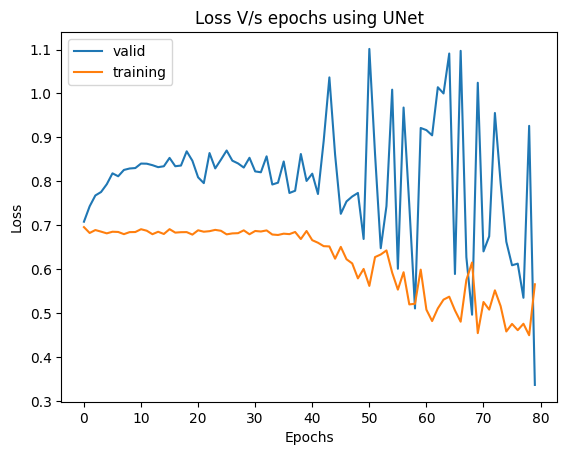

In [ ]:
plt.plot(metrics_dict['valid_loss_list'], label="valid")
plt.plot(metrics_dict['train_loss_list'], label="training")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss V/s epochs using UNet')
plt.legend()
plt.legend()

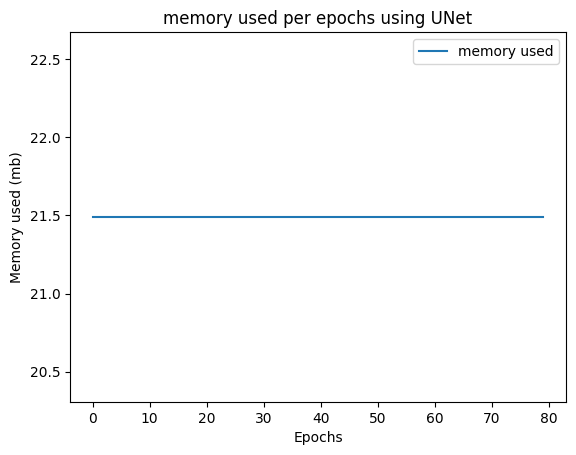

In [ ]:
plt.plot(metrics_dict['memory_used'], label="memory used")
plt.xlabel('Epochs')
plt.ylabel('Memory used (mb)')
plt.title('memory used per epochs using UNet')
plt.legend()

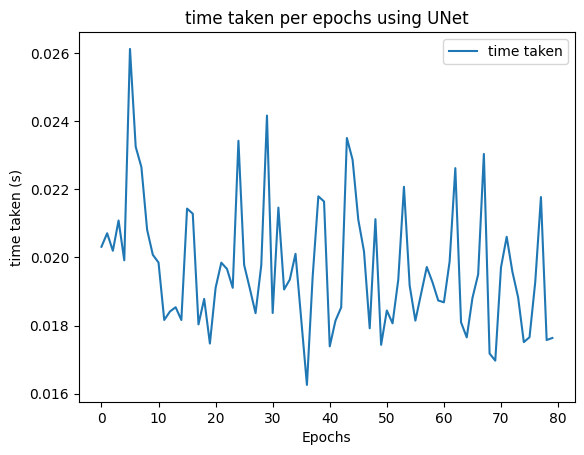

In [ ]:
plt.plot(metrics_dict['time_used'], label="time taken")
plt.xlabel('Epochs')
plt.ylabel('time taken (s)')
plt.title('time taken per epochs using UNet')
plt.legend()

## evaluating

In [ ]:
PATCHES_ = {'LEVEL_0':[], 'LEVEL_non_0':[]}

In [ ]:
from torchvision import transforms, datasets
from cv2 import imread, imwrite, resize, INTER_LINEAR
from skimage.io import imsave
from skimage.draw import polygon as ski_polygon
from sklearn.metrics import roc_auc_score
from skimage.filters import threshold_otsu
from itertools import zip_longest
from math import floor
# import openslide as ops
import warnings as ws
import numpy as np
import random
import torch
import h5py
import math
import cv2
import os
import time
import csv
import logging
import os
import xml.etree.ElementTree as Xml
from collections import OrderedDict, defaultdict, namedtuple
from typing import Sequence, Any, Tuple

import fnmatch
import logging
import os
from collections import namedtuple
from typing import Dict

from PIL import Image
from PIL import ImageDraw
from progress.bar import IncrementalBar

# import openslide
from PIL import Image
class OpenHisto:
    '''
    Read one histopathology image
    '''
    def __init__(self, directory,
                 data_transform=transforms.Compose([
                                transforms.ToPILImage(),
                                transforms.ToTensor(),
                            ])):
        idx = folders.index(directory.split('/')[-1][:-4])
        directory = images_list[idx]
        self.d = directory
        self.img = np.asarray(imread(directory))
        self.data_transform = data_transform

    def read_region(self, pos, level, size):
        '''
        x, y are the cardinality axis: x for column and y for rows
        :param x: x location
        :param y: y location
        :param level: the view we are looking right now
        :param size: size of patch
        :return:
        '''
        x, y = pos
        factor = np.around(2 ** level)
        y1_, y2_ = max(y, 0), min(self.img.shape[0]-1, y+int(size[1]*factor))
        x1_, x2_ = max(x, 0), min(self.img.shape[1]-1, x+int(size[0]*factor))
        # print("in read_region", self.img.shape)
        patch = self.img[max(y, 0) : min(self.img.shape[0]-1, y+int(size[1]*factor)),
                         max(x, 0) : min(self.img.shape[1]-1, x+int(size[0]*factor)), :]
        # print("in read_region patch 1", patch.shape)
        if patch.shape != size:
            patch = np.pad(patch, ((max(0-y, 0), max(min(y+int(size[1]*factor)+1-self.img.shape[0], int(size[1]*factor)), 0)),
                                   (max(0-x, 0), max(min(x+int(size[0]*factor)+1-self.img.shape[1], int(size[0]*factor)), 0)), (0, 0)))
            # y1_, y2_ = max(0-y, 0), max(min(y+int(size[1]*factor)+1-self.img.shape[0], int(size[1]*factor)), 0)
            # x1_, x2_ = max(0-x, 0), max(min(x+int(size[0]*factor)+1-self.img.shape[1], int(size[0]*factor)), 0)
        if level != 0:
            patch = resize(patch, (int(patch.shape[0]//factor), int(patch.shape[1]//factor)), INTER_LINEAR)
            PATCHES_['LEVEL_non_0'].append((y1_, y2_, x1_, x2_, patch))
        else:
          PATCHES_['LEVEL_0'].append((y1_, y2_, x1_, x2_, patch))
        # print("in read_region", patch.shape)
        return patch

    def extract_patches(self, x, y, level=0, size=(50, 50), show_mode='channel_first'):
        '''
        Read patches from one gigapixel image
        Should read the patches from the center
        :return:
        '''
        '''
        return img.read_region((int(x), int(y)), level, size)
        '''

        this_patch = np.asarray(self.read_region((int(x), int(y)), level, size))[:, :, :3].astype(np.uint8)
        if self.data_transform is not None:
            this_patch = self.data_transform(this_patch)
        return this_patch


    def get_mask(self, level=0):
        assert False, "get pixel-level annotationsn is not implemented"
        return

    def get_patches(self, x, y, level=0, size=(0, 0), show_mode='channel_first'):
        '''
        :param x: a list of x-axis for patches. (batch_dim, [num_of_patches for one image])
        :param y: a list of y-axis for patches. (batch_dim, [num_of_patches for one image])
        :param level:
        :param size:
        :return:
        '''
        return self.extract_patches(x, y, level=level, size=size, show_mode=show_mode)

    def get_size(self):
        # display("open_histo ->get_size1", self.d, self.img.shape)
        return self.img.shape

class HistoPatchwiseReader:
    '''
    Reading NCAM Images by Fanjie Kong
    '''
    # Now we only support batch size 1 just for simplicity
    def __init__(self, directory, annotation_name='annotations.csv', batch_size=1, train=False):
        self.batch_size = batch_size
        self.directory = directory
        self.annotations = os.path.join(directory, annotation_name)
        self.cur_batch = None
        self.__cur_name = None
        self.train = train
        self.img_gen = self.generator()
        self.data_list = self._get_data()


    def __len__(self): return int(len(self.data_list)//self.batch_size)

    def _get_data(self):

        data_list = []
        annotations = np.loadtxt(self.annotations, delimiter=None, dtype=str)
        for e_ann in annotations:
            img_dir, label = e_ann.split(',')
            data_list.append((img_dir, int(label)))
        return data_list

    def _batcher(self, inputs, batch_size=1, fillvalue=None):
        inputs = iter(inputs)
        args = [iter(inputs)] * batch_size
        return zip_longest(fillvalue=fillvalue, *args)

    def _get_cur_name(self):
        return self.__cur_name

    def generator(self):
        if self.train:
            np.random.shuffle(self.data_list)
        dataGenerator = self._batcher(self.data_list, self.batch_size)
        while dataGenerator:
            try:
                self.cur_batch = next(dataGenerator)
                self.__cur_name = self.cur_batch[0][0]
                self.cur_batch = self._DataPathtoData(self.cur_batch)
                yield self.cur_batch
            except StopIteration:
                print('Finished this epoch')
                break

    def _DataPathtoData(self, batch):
        '''
        :param batch:
        :return: reading data from the file path in batch
        '''
        new_batch = []
        #print(os.path.join(self.directory, batch[0][0]))
        for e_b in batch:
            if e_b is not None:
                new_batch.append((OpenHisto(os.path.join(self.directory, e_b[0])), e_b[1]))
        return new_batch

In [ ]:
SUB_SAMPLED_PATCHES = []
SAMPLED_PATCHES = []
SUB_ATT_0 = []
SAMPLED_PATCHES_0 = []

In [ ]:
def evaluate_(model_, x_reader):
    print("-------- INSIDE EVALUATE -------")
    accum_feature_list = []
    # print("inside forward->")
    for e_reader in x_reader:
        now_dataReader = e_reader
        print("-------now_dataReader", now_dataReader, sep="\n")
        ## compute locs_array
        #free of size
        locs_array = model_._compute_loc_array(now_dataReader)
        print("-------locs_array", locs_array, sep="\n")
        aoa_list = model_._computing_aoa(locs_array, now_dataReader)
        print("-------aoa_list", aoa_list, sep="\n")
        reg_aoa = MultinomialRegularizer(aoa_list, model_.reg_strength)
        print("-------reg_aoa", reg_aoa, sep="\n")
        # Sampling again implementation

        #print("forloop->", locs_array, aoa_list, reg_aoa, sep="/n")

        target_samples = model_._sample_with_replacement(aoa_list, model_.desired_patches)
        print("-------target_samples", target_samples, sep="\n")
        #print(target_samples)
        target_idx = (target_samples != 0).nonzero()
        print("-------target_idx", target_idx, sep="\n")

        #print(target_idx)
        #print(locs_array.shape)
        num_of_region = target_idx
        target_samples = target_samples[target_idx]
        print("-------target_samples", target_samples, sep="\n")

        #print(target_samples)
        target_aoa = aoa_list[target_idx]
        #print(len(locs_array))
        #print(target_idx.cpu().data.numpy())
        target_locs_array = locs_array[target_idx.detach().cpu().numpy().astype(np.int)].squeeze()
        print("-------target_locs_array", target_locs_array, sep="\n")

        ##############################
        if len(target_locs_array.shape) == 1:
            # add an axis
            target_locs_array = np.expand_dims(target_locs_array, axis=0)

        #print("target_locs_array", target_locs_array)
        print("-------target_locs_array", target_locs_array, sep="\n")

        expected_sub_features_list = []
        ONCE = True
        for idx, loc in enumerate(target_locs_array):
            print(f"\n for location {loc} \n")
            sub_att = model_._computing_attention(loc, now_dataReader)
            print("-------sub_att", sub_att, sep="\n")

            reg_aoa += MultinomialRegularizer(sub_att.view(-1), model_.reg_strength)
            print("-------reg_aoa", reg_aoa, sep="\n")

            sampled_location = model_._sample_without_replacement(sub_att.view(sub_att.shape[0], -1),
                                                int(target_samples[idx].cpu().numpy()))
            print("-------sampled_location", sampled_location, sep="\n")

            sampled_attention = sub_att.view(-1)[sampled_location]
            print("-------sampled_attention", sampled_attention, sep="\n")

            sampled_patches = SamplingPatches(sampled_location.cpu().numpy(), loc,
                                            now_dataReader, sub_att.shape[2:],
                                            model_.low_img_level, model_.high_img_level, model_.patch_size)
            #display("sampled_patches", sampled_patches)
            SAMPLED_PATCHES.append(sampled_patches)
            print("-------sampled_patches", sampled_patches, sep="\n")

            sub_feature = model_.fe(sampled_patches.to(model_.device))
            print("-------sub_feature", sub_feature, sep="\n")

            SUB_SAMPLED_PATCHES.append(sub_feature)

            if ONCE:
                SUB_ATT_0.append(sub_att.view(sub_att.shape[0], -1))
                SAMPLED_PATCHES_0.append(sampled_patches)
                ONCE = False

            if model_.weights is None:
                model_.weights = torch.ones_like(sampled_attention) / sampled_attention.shape[1]
            expected_sub_feature = model_.expected(model_.weights, sampled_attention, sub_feature.unsqueeze(0))
            expected_sub_features_list.append(expected_sub_feature.unsqueeze(0))
            # Re-init weights para
            model_.weights = None
        # Double expectations
        # Repeat aoa based on the target samples
        expected_sub_feature_list = torch.cat(expected_sub_features_list, dim=1)
        weights_accum_f = target_samples.squeeze(1).unsqueeze(0) / model_.desired_patches
        accum_features = model_.expected_accum(weights_accum_f, target_aoa.unsqueeze(0), expected_sub_feature_list)
        accum_feature_list.append(accum_features)
    accum_feature_list = torch.cat(accum_feature_list, dim=0)
    prediction, _ = model_.clf(accum_feature_list.to(model_.device))
    return prediction, reg_aoa

In [ ]:
i = 1
test_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_valid_fold_'+str(i+1)+'.csv',
                                                        batch_size=1, train=False)

0it [00:00, ?it/s]

'/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Classification/img11/img11.bmp'

-------- INSIDE EVALUATE -------
-------now_dataReader
-------locs_array
[[  0   0]
 [250   0]
 [  0 250]
 [250 250]]
-------aoa_list
tensor([0.2516, 0.2524, 0.2499, 0.2461], grad_fn=<SoftmaxBackward0>)
-------reg_aoa
tensor(-0., grad_fn=<DivBackward0>)
-------target_samples
tensor([3., 3., 3., 1.])
-------target_idx
tensor([[0],
        [1],
        [2],
        [3]])
-------target_samples
tensor([[3.],
        [3.],
        [3.],
        [1.]])
-------target_locs_array
[[  0   0]
 [250   0]
 [  0 250]
 [250 250]]
-------target_locs_array
[[  0   0]
 [250   0]
 [  0 250]
 [250 250]]

 for location [0 0] 

-------sub_att
tensor([[[[3.0460e-04, 1.7027e-04, 1.3892e-04,  ..., 1.2410e-04,
           1.5284e-04, 2.2313e-04],
          [2.1457e-04, 7.6999e-05, 5.0344e-05,  ..., 4.1548e-05,
           5.8196e-05, 1.1247e-04],
          [1.6128e-04, 4.5865e-05, 2.8261e-05,  ..., 2.3002e-05,
           3.6257e-05, 8.8440e-05],
          ...,
          [2.8913e-04, 1.7112e-04, 1.3140e-04,  ..., 

<ipython-input-36-91db1c0bdb1e>:70: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if patch.shape != size:
<ipython-input-18-3e98c9c54f82>:131: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  aoa_list = F.softmax(aoa_list)
<ipython-input-38-986d747ca65b>:36: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  target_locs_array = locs_array[target_idx.detach().cpu().numpy().astype(np.int)].squeeze()
<ipython-input-12-70a54cf315ac>:135

'output->'

tensor([[ 1.4460, -0.9030]], grad_fn=<AddmmBackward0>)

tensor(-0., grad_fn=<AddBackward0>)

1it [00:00,  5.95it/s]


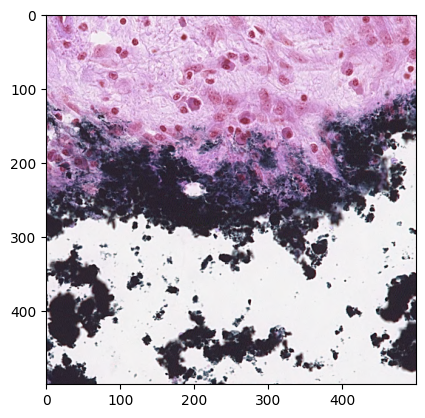

In [ ]:
j=1
for test_batch in tqdm.tqdm(test_loader.generator()):
    if j>1:
        break
    j+=1
    test_input_reader = [e_reader for e_reader, _ in test_batch]
    # display("val_inp->", len(val_input_reader), val_input_reader[0])
    display(test_input_reader[0].d, plt.imshow(test_input_reader[0].img))
    # labels = torch.stack([torch.Tensor([e_label]) for _, e_label in val_batch]).squeeze(1)
    # labels = labels.type(torch.LongTensor).to(device)
    # display("labels->", labels)
    # output, reg_aoa = model_(val_input_reader)
    output, reg_aoa = evaluate_(model_, test_input_reader)
    display("output->", output, reg_aoa)

In [ ]:
PATCHES_

{'LEVEL_0': [(181,
   208,
   191,
   218,
   array([[[177, 146, 196],
           [176, 144, 194],
           [180, 143, 194],
           ...,
           [ 41,  18,  50],
           [ 63,  45,  77],
           [100,  89, 120]],
   
          [[209, 160, 213],
           [214, 165, 218],
           [204, 156, 208],
           ...,
           [ 42,  29,  59],
           [ 37,  29,  58],
           [ 43,  38,  67]],
   
          [[202, 136, 192],
           [208, 145, 199],
           [217, 159, 212],
           ...,
           [ 41,  40,  69],
           [ 43,  45,  73],
           [ 44,  47,  75]],
   
          ...,
   
          [[ 42,  31,  55],
           [ 47,  32,  61],
           [122, 104, 137],
           ...,
           [183, 124, 189],
           [181, 125, 189],
           [200, 147, 210]],
   
          [[ 37,  26,  48],
           [ 26,  15,  39],
           [ 38,  24,  52],
           ...,
           [188, 124, 191],
           [187, 128, 193],
           [204, 150, 213]

In [ ]:
len(PATCHES_['LEVEL_non_0']), len(PATCHES_['LEVEL_non_0'][0]), PATCHES_['LEVEL_non_0'][0][4].shape

(8, 5, (62, 62, 3))

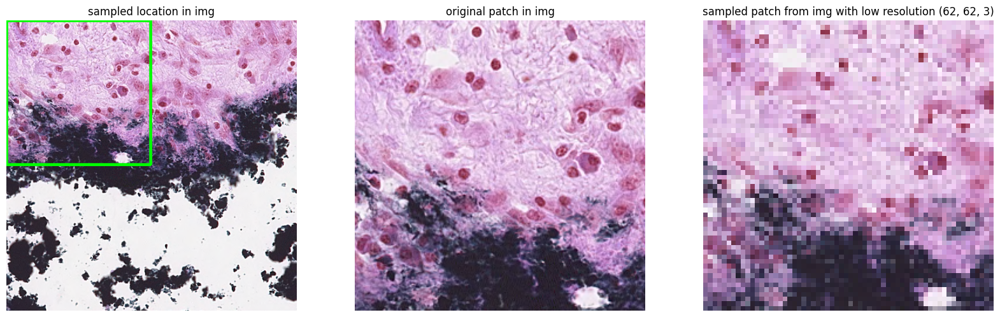

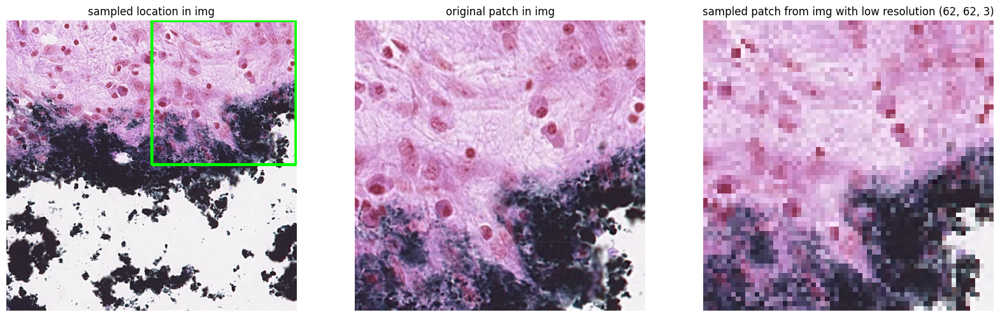

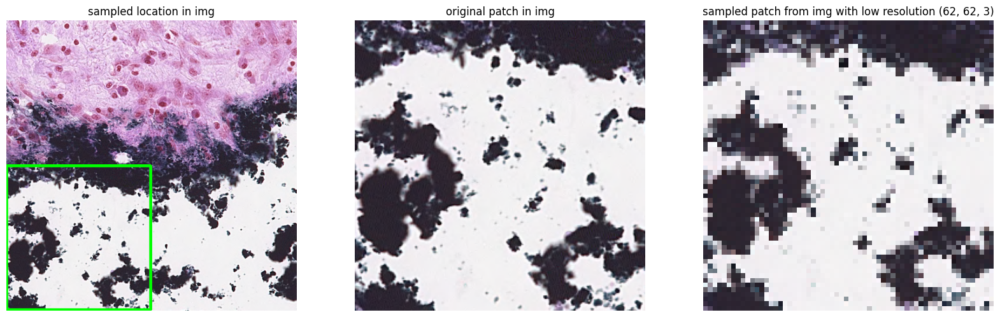

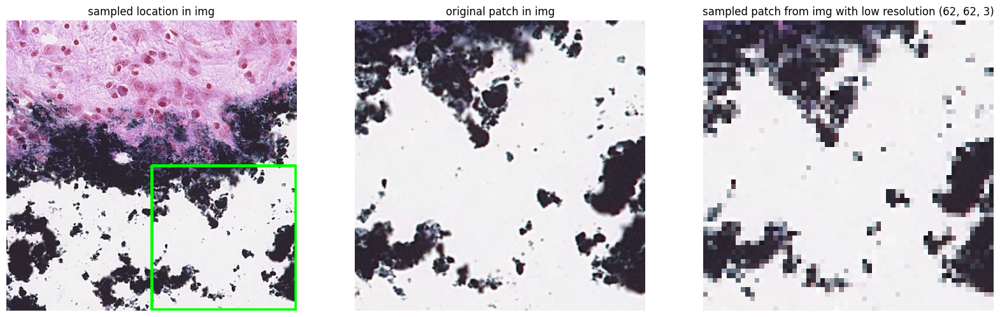

In [ ]:
for i in range(4):
  m_img = test_input_reader[0].img.copy()
  y_1,y_2,x_1,x_2 = PATCHES_['LEVEL_non_0'][i][:4]
  fig = plt.figure(figsize=(20, 20))
  # setting values to rows and column variables
  rows = 1
  columns = 3
  fig.add_subplot(rows, columns, 1)
  plt.imshow(cv.rectangle(m_img, (x_1,y_1), (x_2,y_2), (0, 255, 0), 3))
  plt.axis('off')
  plt.title("sampled location in img")

  m_img = test_input_reader[0].img.copy()
  fig.add_subplot(rows, columns, 2)
  plt.imshow(m_img[y_1:y_2, x_1:x_2, :])
  plt.axis('off')
  plt.title("original patch in img")

  fig.add_subplot(rows, columns, 3)
  plt.imshow(PATCHES_['LEVEL_non_0'][i][4])
  plt.axis('off')
  plt.title(f"sampled patch from img with low resolution {PATCHES_['LEVEL_non_0'][i][4].shape}")

  plt.show()

### sub sampling

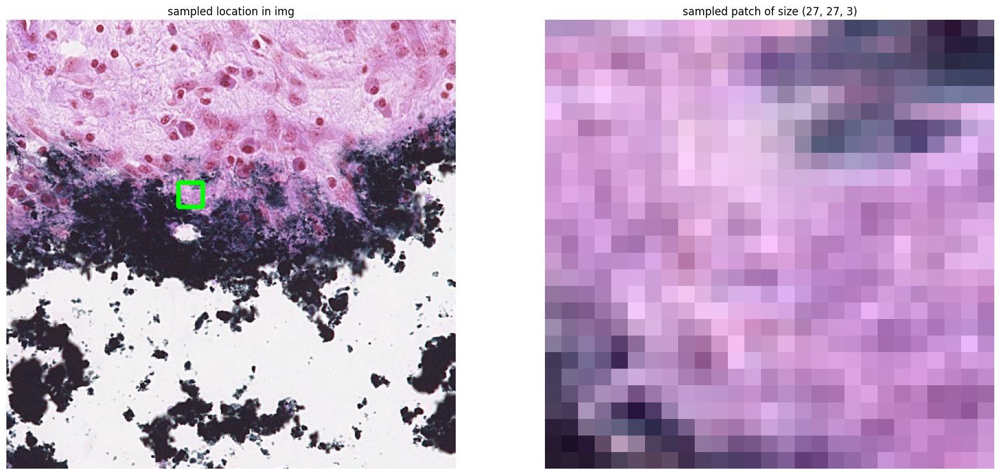

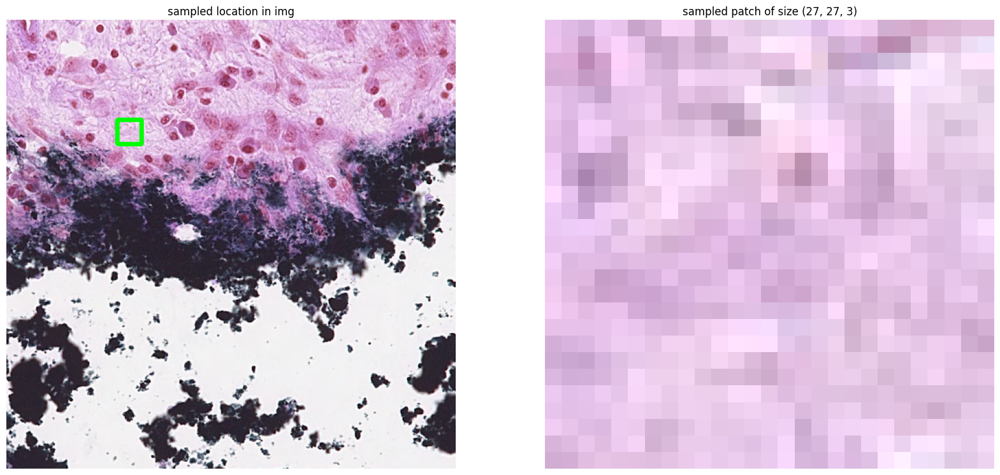

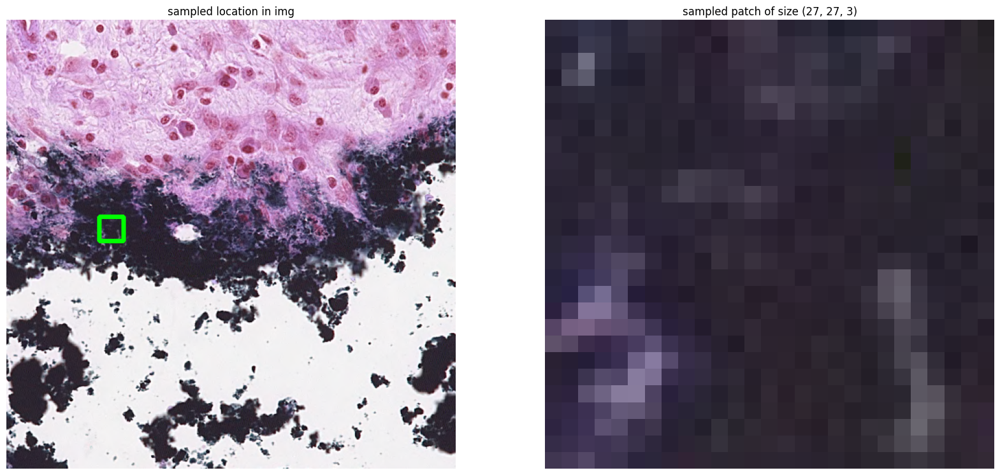

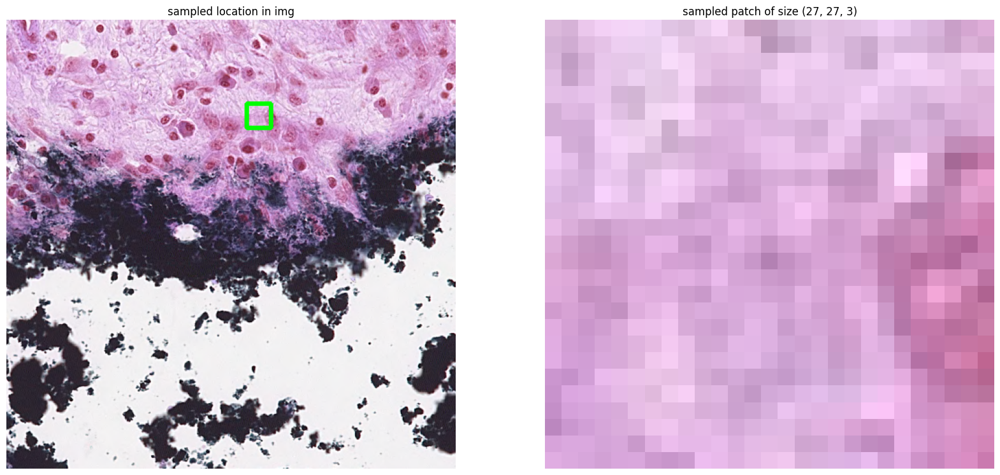

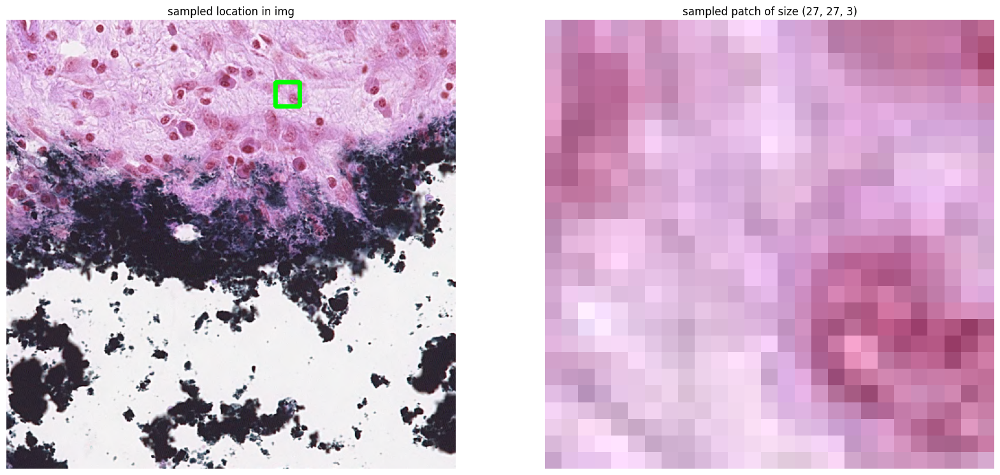

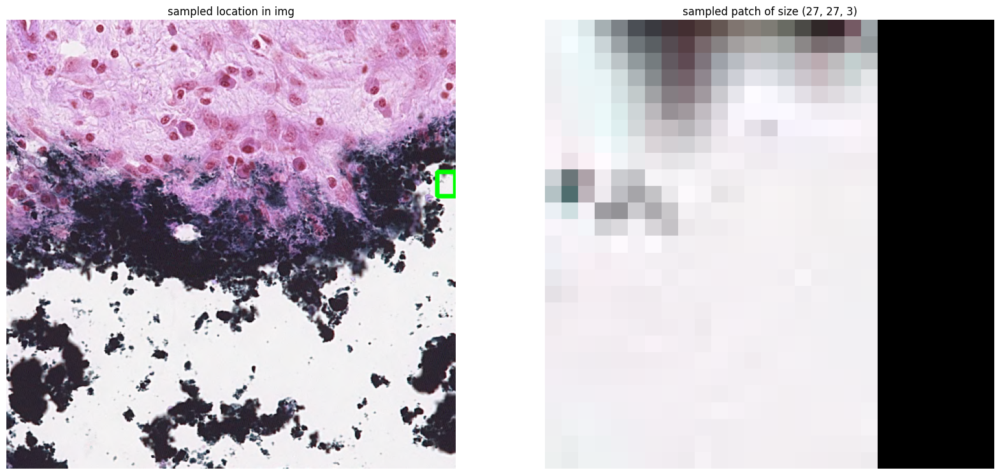

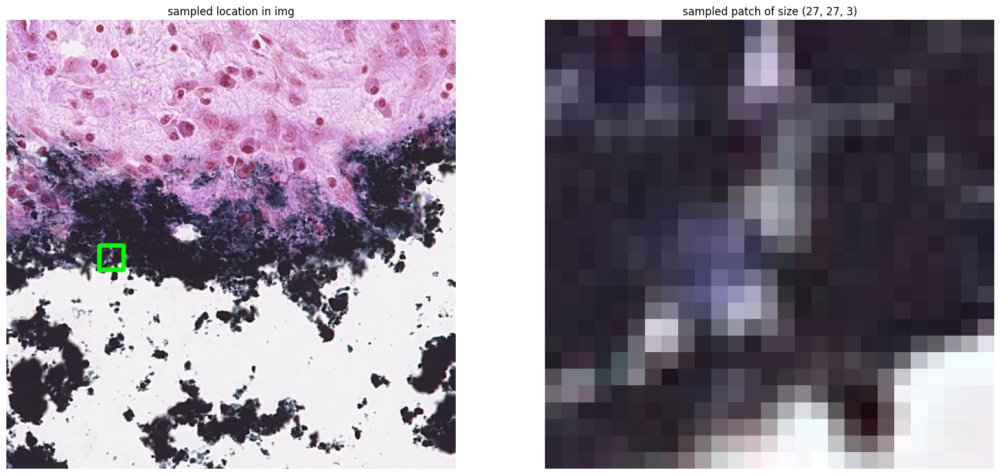

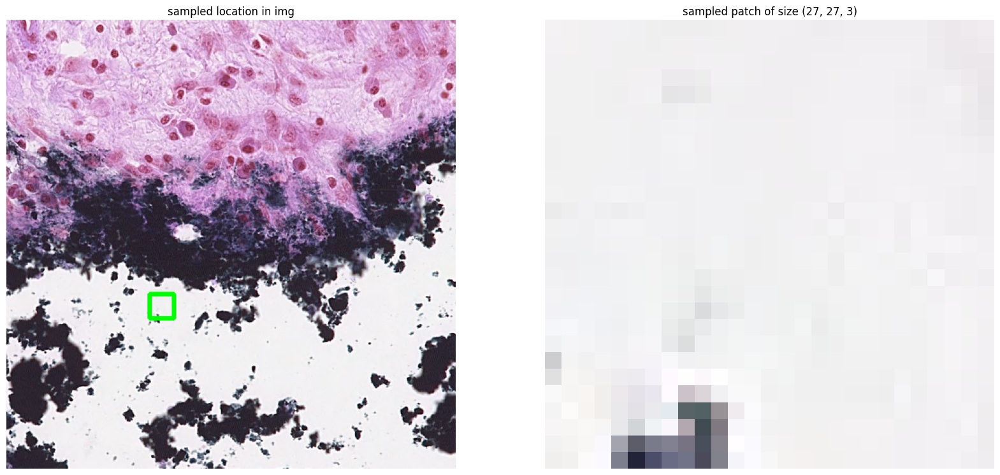

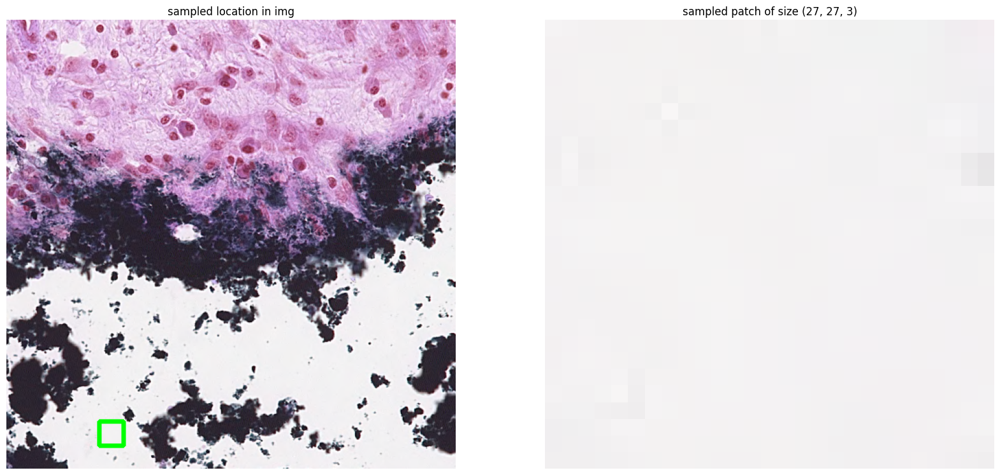

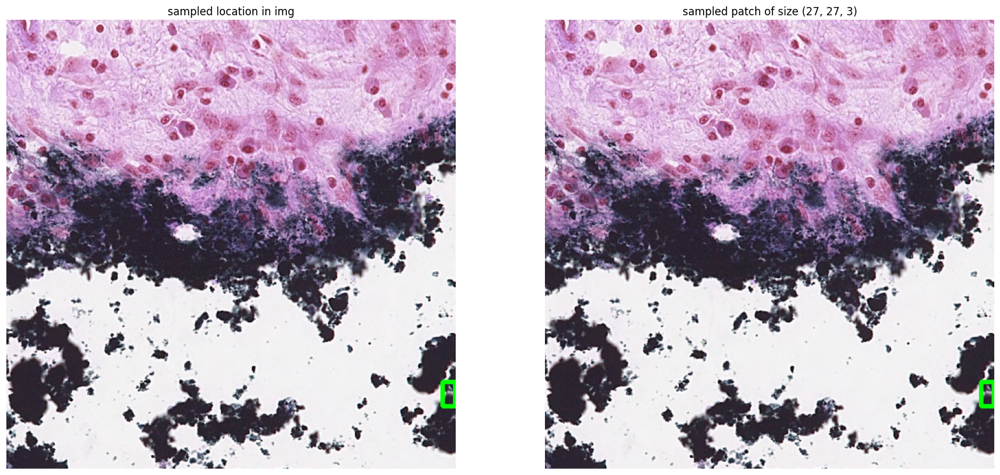

In [ ]:
for i in range(10):
  m_img = test_input_reader[0].img.copy()
  y_1,y_2,x_1,x_2 = PATCHES_['LEVEL_0'][i][:4]
  fig = plt.figure(figsize=(20, 20))
  # setting values to rows and column variables
  rows = 1
  columns = 2
  fig.add_subplot(rows, columns, 1)
  plt.imshow(cv.rectangle(m_img, (x_1,y_1), (x_2,y_2), (0, 255, 0), 3))
  plt.axis('off')
  plt.title("sampled location in img")

  fig.add_subplot(rows, columns, 2)
  plt.imshow(PATCHES_['LEVEL_0'][i][4])
  plt.axis('off')
  plt.title(f"sampled patch of size {PATCHES_['LEVEL_0'][i][4].shape}")
plt.imshow(m_img)

### Categorical output

0it [00:00, ?it/s]<ipython-input-36-91db1c0bdb1e>:70: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if patch.shape != size:
<ipython-input-18-3e98c9c54f82>:131: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  aoa_list = F.softmax(aoa_list)
<ipython-input-18-3e98c9c54f82>:228: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  target_locs_array = locs_array[target_idx.detach().cpu().numpy().astype(np.int)].squeeze()
<ipython-input-1

Finished this epoch


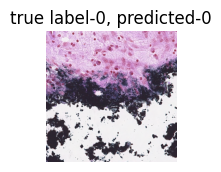

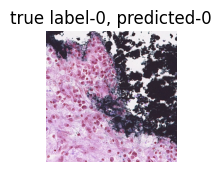

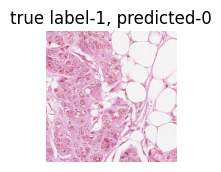

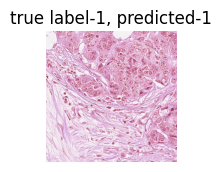

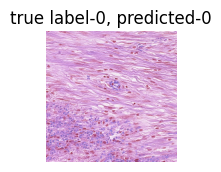

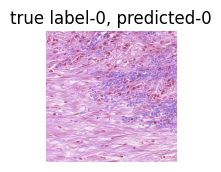

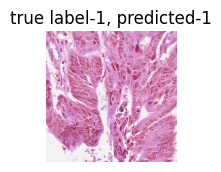

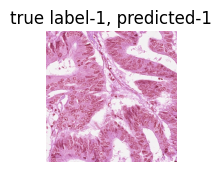

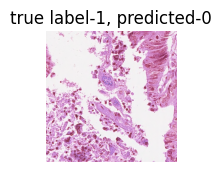

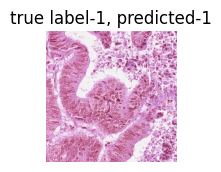

In [ ]:
j = 1
Labels, Outputs = [], []
for test_batch in tqdm.tqdm(test_loader.generator()):
    test_input_reader = [e_reader for e_reader, _ in test_batch]
    # display("val_inp->", len(val_input_reader), val_input_reader[0])
    #display(test_input_reader[0].d, plt.imshow(test_input_reader[0].img))
    labels = torch.stack([torch.Tensor([e_label]) for _, e_label in test_batch]).squeeze(1)
    labels = labels.type(torch.LongTensor).to(device)
    # display("labels->", labels)
    output, _ = model_(test_input_reader)
    #output, reg_aoa = evaluate_(model_, test_input_reader)
    fig = plt.figure(figsize=(20, 20))
    # setting values to rows and column variables
    rows = 10
    columns = 1
    fig.add_subplot(rows, columns, j)
    plt.imshow(test_input_reader[0].img)
    plt.axis('off')
    plt.title(f"true label-{labels.item()}, predicted-{np.argmax(output.detach().cpu())}")
    j+=1
    Labels.append(labels.item())
    Outputs.append(np.argmax(output.detach().cpu()).item())
    # plt.imshow(test_input_reader[0].img)
    # plt.title(f"true label-{labels}, predicted-{output}")
    #display("output->", output, labels)

In [ ]:
Labels, Outputs

([0, 0, 1, 1, 0, 0, 1, 1, 1, 1], [0, 0, 0, 1, 0, 0, 1, 1, 0, 1])

In [ ]:
# A function to evaluate accuracy of binary classification using confusion amatrics and accuracy and f1 score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, f1_score
#various evaluation methods
def evaluate(y_true, y_pred):
    '''Takes in true and predicted values for binary classification
     Plot confusion matrix and gives accuracy and f1 score
    '''
    if isinstance(y_true,(list)):
        y_true = np.array(y_true)

    if isinstance(y_pred,(list)):
        y_pred = np.array(y_pred)

    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['No Pneumonia(0)', 'Pneumonia(1)'])
    disp.plot()
    plt.show()

    #printing stats
    tn, fp, fn, tp = cm.ravel()
    print(f"TP:{tp}, TN:{tn}, FP:{fp}, FN:{fn}")
    print(f"accuracy of model is : {round((sum(y_pred==y_true)/len(y_true)), 3)}")
    print(f"f1 score of model is : {round(f1_score(y_true, y_pred, average='binary'), 3)}")

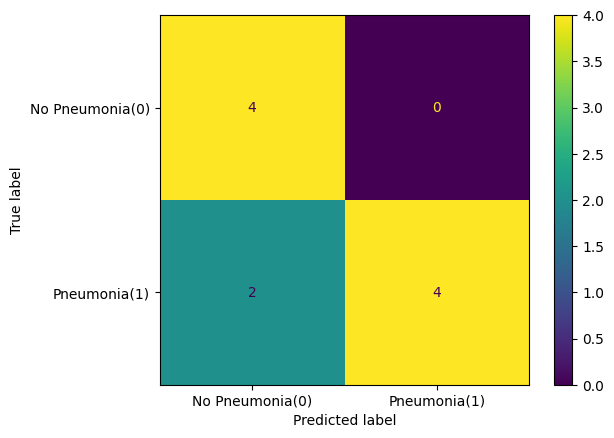

TP:4, TN:4, FP:0, FN:2
accuracy of model is : 0.8
f1 score of model is : 0.8


In [ ]:
evaluate(Labels, Outputs)

#### expanded_v

In [ ]:
m_img = test_input_reader[0].img.copy()

In [ ]:
y_1,y_2,x_1,x_2 = PATCHES_['LEVEL_non_0'][5][:4]
y_1, y_2, x_1, x_2

(0, 250, 250, 499)

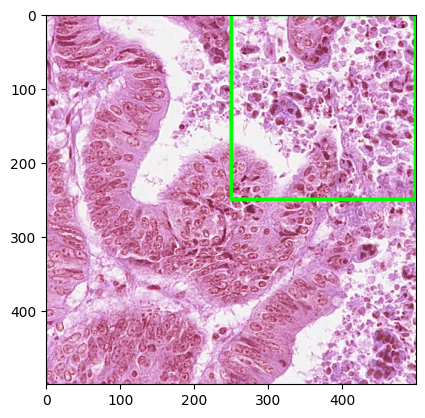

In [ ]:
cv.rectangle(m_img, (x_1,y_1), (x_2,y_2), (0, 255, 0), 3)
plt.imshow(m_img)

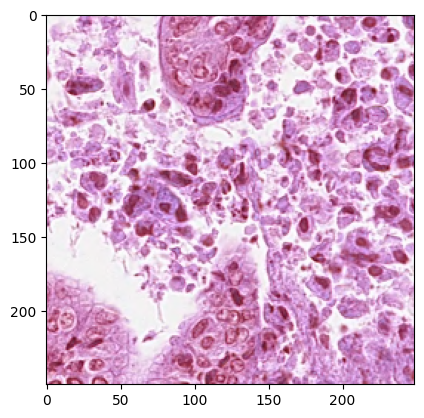

In [ ]:
plt.imshow(test_input_reader[0].img[y_1:y_2, x_1:x_2, :])

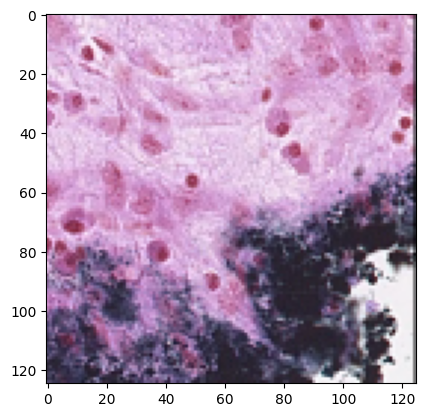

In [ ]:
plt.imshow(PATCHES_['LEVEL_non_0'][5][4])

In [ ]:
len(PATCHES_['LEVEL_0']), len(PATCHES_['LEVEL_0'][0]), PATCHES_['LEVEL_0'][0][4].shape

(110, 5, (27, 27, 3))

In [ ]:
m_img = test_input_reader[0].img.copy()

In [ ]:
y_1,y_2,x_1,x_2 = PATCHES_['LEVEL_0'][1][:4]
y_1, y_2, x_1, x_2

(111, 138, 123, 150)

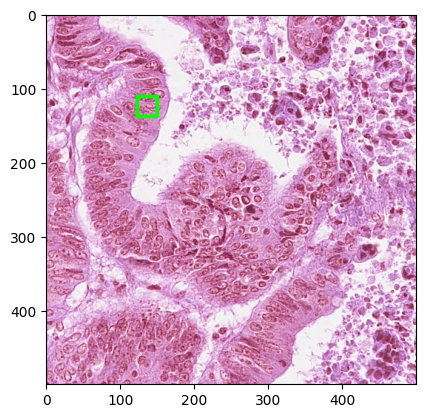

In [ ]:
cv.rectangle(m_img, (x_1,y_1), (x_2,y_2), (0, 255, 0), 3)
plt.imshow(m_img)

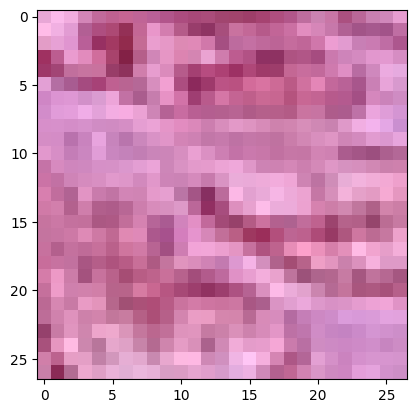

In [ ]:
plt.imshow(test_input_reader[0].img[y_1:y_2, x_1:x_2, :])

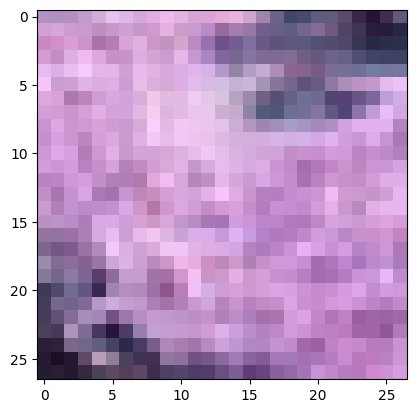

In [ ]:
plt.imshow(PATCHES_['LEVEL_0'][0][4])

In [ ]:
SUB_ATT_0[0].shape, SUB_ATT_0[0]

(torch.Size([1, 15625]),
 tensor([[0.0003, 0.0002, 0.0001,  ..., 0.0003, 0.0003, 0.0003]],
        grad_fn=<ViewBackward0>))

In [ ]:
location = 14358
row = np.floor(location // 125)
col = location % 125
###
low_img_level_ = model_.low_img_level
high_img_level_ = model_.high_img_level
patch_size_ = model_.patch_size
frame_location_ = [0,0]
###
# location - axis switch！ and linear map back
x = col * (np.around(2**low_img_level_)) + frame_location_[0] -int(np.around(2**high_img_level_)* patch_size_[1]//2)
y = row * (np.around(2**low_img_level_)) + frame_location_[1] -int(np.around(2**high_img_level_)* patch_size_[0]//2)
x, y

(203, 215.0)

In [ ]:
SUB_ATT_0[0][0][0].detach().cpu().numpy().max()

0.00030460028

TypeError: ignored

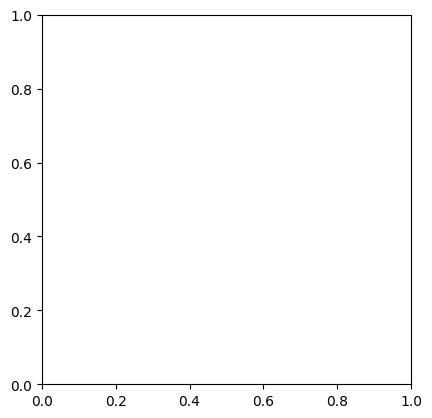

In [ ]:
att_dist = SUB_ATT_0[0][0][0].detach().cpu().numpy()
cv.rectangle(att_dist,(203, 215),(223, 235), (255, 255, 255), 5)
plt.imshow(att_dist, cmap='gray')

In [ ]:
SAMPLED_PATCHES_0[0].shape

In [ ]:
plt.imshow(SAMPLED_PATCHES_0[0][0].permute(1, 2, 0))

In [ ]:
plt.figure(figsize=(20, 20)) # specifying the overall grid size

for i in range(1):
    plt.subplot(2, 2, i+1)    # the number of images in the grid is
    plt.imshow(SAMPLED_PATCHES_0[0][i].permute(1, 2, 0))

plt.show()

In [ ]:
len(SAMPLED_PATCHES), len(SUB_SAMPLED_PATCHES)

In [ ]:
SAMPLED_PATCHES[0].shape, SUB_SAMPLED_PATCHES[0].shape

In [ ]:
plt.figure(figsize=(15, 5)) # specifying the overall grid size

for i in range(3):
    plt.subplot(1, 3, i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(SAMPLED_PATCHES[0][i].permute(1, 2, 0))

plt.show()

In [ ]:
metrices = torch.load('/content/output/metrices.pt')
metrices.keys()

dict_keys(['train_loss_list', 'valid_loss_list', 'global_steps_list', 'memory_used', 'time_used'])

## -p

In [ ]:
now_dataReader = val_input_reader[0]

In [ ]:
locs_array = model._compute_loc_array(now_dataReader)
aoa_list = model._computing_aoa(locs_array, now_dataReader)
reg_aoa = MultinomialRegularizer(aoa_list, model.reg_strength)
# Sampling again implementation

#print("forloop->", locs_array, aoa_list, reg_aoa, sep="/n")

target_samples = model._sample_with_replacement(aoa_list, model.desired_patches)
#print(target_samples)
target_idx = (target_samples != 0).nonzero()
#print(target_idx)
#print(locs_array.shape)
num_of_region = target_idx
target_samples = target_samples[target_idx]
#print(target_samples)
target_aoa = aoa_list[target_idx]
#print(len(locs_array))
#print(target_idx.cpu().data.numpy())
target_locs_array = locs_array[target_idx.detach().cpu().numpy().astype(np.int)].squeeze()

In [ ]:
locs_array

In [ ]:
aoa_list, reg_aoa

In [ ]:
target_samples

In [ ]:
target_aoa, "/n", target_locs_array

In [ ]:
LOCATIONS = []

In [ ]:
for idx, loc in enumerate(target_locs_array):
    sub_att = model._computing_attention(loc, now_dataReader)
    reg_aoa += MultinomialRegularizer(sub_att.view(-1), model.reg_strength)
    sampled_location = model._sample_without_replacement(sub_att.view(sub_att.shape[0], -1),
                                            int(target_samples[idx].cpu().numpy()))
    sampled_attention = sub_att.view(-1)[sampled_location]
    sampled_patches = SamplingPatches(sampled_location.cpu().numpy(), loc,
                                        now_dataReader, sub_att.shape[2:],
                                        model.low_img_level, model.high_img_level, model.patch_size)
    sub_feature = model.fe(sampled_patches.to(model.device))

In [ ]:
sampled_attention

In [ ]:
sampled_location, loc

In [ ]:
sampled_patches.shape

In [ ]:
sub_feature.shape

In [ ]:
LOCATIONS

In [ ]:
X = []
Y = []
for l  in LOCATIONS:
    X.append(l[0])
    Y.append(l[1])

In [ ]:
plt.imshow(val_input_reader[0].img)
plt.scatter(x=X, y=Y)

In [ ]:
plt.imshow(sampled_patches[0].permute(1, 2, 0))

In [ ]:
plt.imshow(sampled_patches[1].permute(1, 2, 0))

In [ ]:
plt.imshow(sampled_patches[2].permute(1, 2, 0))

In [ ]:
attention_model, aoa_model, fe_model, clf_model, model = get_models(args)

In [ ]:
model_dict = torch.load('/content/output/model_1.pt')
model.load_state_dict(model_dict['model_state_dict'])

In [ ]:
attention_model_keys = ['attention.layers.0.weight', 'attention.layers.0.bias', 'attention.layers.2.weight', 'attention.layers.2.bias', 'attention.layers.4.weight', 'attention.layers.4.bias', 'attention.layers2.0.weight', 'attention.layers2.0.bias', 'attention.layers2.2.weight', 'attention.layers2.2.bias', 'attention.layers2.4.weight', 'attention.layers2.4.bias']
attention_dict = {}
for key in attention_model_keys:
    attention_dict[key[10:]]=model_dict['model_state_dict'][key]
attention_model.load_state_dict(attention_dict)

In [ ]:
after_attention = attention_model(torch.tensor(val_input_reader[0].img, dtype=torch.float32))

In [ ]:
after_attention.shape, display(plt.imshow(after_attention.cpu()))

## .

In [ ]:
i=1
for val_batch in tqdm.tqdm(valid_loader.generator()):
    val_input_reader = [e_reader for e_reader, _ in val_batch]
    display("val_inp->", len(val_input_reader), val_input_reader[0])
    display(val_input_reader[0].d, plt.imshow(val_input_reader[0].img))
    # labels = torch.stack([torch.Tensor([e_label]) for _, e_label in val_batch]).squeeze(1)
    # labels = labels.type(torch.LongTensor).to(device)
    # display("labels->", labels)
    output, reg_aoa = model(val_input_reader)
    display("output->", output, reg_aoa)
    if i>1:
        break
    i+=1

In [ ]:
len(SAMPLED_PATCHES), len(SUB_SAMPLED_PATCHES)

In [ ]:
# eval()
# import torch
# import numpy as np
# # from utils.utils import save_checkpoint, load_checkpoint, save_metrics, load_metrics, get_activation

# def eval():
#     sample_count = 0.0
#     running_acc = 0.0
#     running_loss = 0.0
#     valid_running_acc = 0.0
#     valid_running_loss = 0.0
#     global_step = 0
#     best_ACC = 0
#     # load_checkpoint(os.path.join(saved_path, 'con_histo_cross_'+str(i+1)+'_test1.pt'), model)
#     load_checkpoint('/content/model_1.pt', model)
#     model.eval()
#     with torch.no_grad():

#         # validation loop
#         print("Begin Validation")
#         valid_sample_count = 0.0
#         valid_running_loss = 0.0
#         valid_running_acc = 0.0
#         for val_batch in tqdm.tqdm(valid_loader.generator()):
#             val_input_reader = [e_reader for e_reader, _ in val_batch]
#             labels = torch.stack([torch.Tensor([e_label]) for _, e_label in val_batch]).squeeze(1)
#             labels = labels.type(torch.LongTensor).to(device)
#             output, _ = model(val_input_reader)
#             loss = criterion(output, labels)
#             valid_running_loss += loss.item()
#             _, pred_labels = output.data.cpu().topk(1, dim=1)
#             valid_running_acc += torch.sum(pred_labels.t().squeeze() == labels.data.cpu().squeeze()).item()
#             valid_sample_count += labels.shape[0]
#     # evaluation
#     average_valid_loss = valid_running_loss / len(valid_loader)
#     average_valid_acc = valid_running_acc / valid_sample_count

#     # print progress
#     print('Valid Loss: {:.4f}, Valid Acc: {:.4f}'
#           .format(average_valid_loss, average_valid_acc))
#     print("Max memory used: {} Mb ".format(torch.cuda.memory_allocated(device=0)/ (1000 * 1000)))

In [ ]:
len(SAMPLED_PATCHES), len(SUB_SAMPLED_PATCHES)

In [ ]:
SAMPLED_PATCHES[0].shape, SUB_SAMPLED_PATCHES[0].shape

In [ ]:
SAMPLED_PATCHES[0][0].shape

In [ ]:
plt.figure(figsize=(20,20)) # specifying the overall grid size

for i in range(36):
    plt.subplot(6,6,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(SAMPLED_PATCHES[i][0].permute(1, 2, 0))

plt.show()

In [ ]:
model

In [ ]:
img = imread('/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Classification/img92/img92.bmp')
plt.imshow(img)

In [ ]:
 state_dict = torch.load('/content/model_1.pt', map_location=device)
 state_dict

### --

In [ ]:
%%writefile main.py
import argparse
import os

parser = argparse.ArgumentParser(
    description=("Train a model with attention sampling on the "
                    "artificial mnist dataset")
)
parser.add_argument(
    "--dataset", default='/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Detection',
    help="The directory that contains the dataset ",
)
parser.add_argument(
    "--output", default = "/content",
    help="An output directory"
)

parser.add_argument(
"--TenCrossValidation", default=True, action='store_true')

parser.add_argument(
    "--optimizer",
    choices=["sgd", "adam"],
    default="adam",
    help="Choose the optimizer for Q1"
)
parser.add_argument(
    "--models_set",
    choices=["base", "ResNet"],
    default="base",
    help="Choose the different architecture of the zoom-in modules"
)
parser.add_argument(
    "--mode",
    choices=["10CrossValidation", "Training", "Evaluation"],
    default="10CrossValidation",
    help="working mode of the program"
)
parser.add_argument(
    "--lr",
    type=float,
    default=0.0001,
    help="Set the optimizer's learning rate"
)
parser.add_argument(
    "--weight_decay",
    type=float,
    default=1e-5,
    help="Set the optimizer's weight_decay"
)
parser.add_argument(
    "--lr_decay_steps",
    type=int,
    default=30,
    help="Set the decay steps of learning rate scheduler"
)
parser.add_argument(
    "--lr_decay_ratio",
    type=float,
    default=0.9,
    help="Set the decay ratio of learning rate scheduler"
)
parser.add_argument(
    "--clipnorm",
    type=float,
    default=5.0,
    help=("Clip the gradient norm to avoid exploding gradients "
            "towards the end of convergence")
)

parser.add_argument(
    "--tile_size",
    type=lambda x: tuple(int(xi) for xi in x.split("x")),
    default="250x250",
    help="Choose the size of the first-level tile"
)

parser.add_argument(
    "--patch_size",
    type=lambda x: tuple(int(xi) for xi in x.split("x")),
    default="27x27",
    help="Choose the size of the patch(sub-tile) to extract from the high resolution"
)

parser.add_argument(
    "--n_patches",
    type=int,
    default=10,
    help="How many patches to sample"
)
parser.add_argument(
    "--regularizer_strength",
    type=float,
    default=0.01,
    help="How strong should the regularization be for the attention"
)

parser.add_argument(
    "--batch_size",
    type=int,
    default=5,
    help="Choose the batch size for SGD"
)
parser.add_argument(
    "--num_epochs",
    type=int,
    default=100,
    help="How many epochs to train"
)
parser.add_argument(
    "--scale",
    type=float,
    default=0.2,
    help="Scale for downsampling images"
)
parser.add_argument(
    "--contrastive_learning",
    default=False,
    action='store_true')

parser.add_argument(
    "--apply_con_epochs",
    type=int,
    default=10,
    help="when to apply contrastive learning"
)

parser.add_argument(
    "--num_classes",
    default=2,
    help="Number of classes of targets"
)
parser.add_argument(
    "--model_name",
    default=None,
    help="the name of the training/testing model"
)
parser.add_argument(
    "--overlap",
    type=int,
    default=1,
    help="Overlap for eliminating boundary effects"
)
parser.add_argument(
    "--reg_strength",
    type=float,
    default=0,
    help="whether regularize the coefficients for dynamic sampling"
)
parser.add_argument(
    "--valid_step",
    default=1,
    help="how often we do the validation "
)
parser.add_argument(
    "--load_model",
    default='best',
    help="load which model"
)

parser.add_argument(
    "--use_gpu",
    default=True,
    action='store_true')

parser.add_argument(
    "--gpu",
    default=0
)
parser.add_argument(
    "--num_works",
    default=4
)
args = parser.parse_args()

if args.gpu is not None:
    os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'
    os.environ['CUDA_VISIBLE_DEVICES'] = str(args.gpu)
if not os.path.exists(args.output):
    os.makedirs(args.output)

if args.mode == "10CrossValidation":

    total_cross = 10
    ten_cross_acc_list = []
    for i in range(total_cross):
        train_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_train_fold_'+str(i+1)+'.csv',
                                                batch_size=args.batch_size, train=True)
        valid_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_valid_fold_'+str(i+1)+'.csv',
                                                        batch_size=1, train=False)
        _, _, _, _, model = get_models(args)
        configs = load_configuratiton(model, args)
        train_loss, train_acc, valid_loss, valid_acc = train(model, train_loader, valid_loader, configs)
        ten_cross_acc_list.append(valid_acc)
    print("Final 10 Cross Validation Results: ")
    print(ten_cross_acc_list)
    print("Average Accuracy: ", np.mean(ten_cross_acc_list))
elif args.mode == "Training":
    train_loader, valid_loader, test_loader = get_custom_dataset(args)
    _, _, _, _, model = get_models(args)
    train(model, train_loader, valid_loader, configs, args)
    eval(model, test_loader, configs, args)
elif args.mode == "Evaluation":
    test_loader = HistoPatchwiseReader(args.dataset, annotation_name='labels_histo_valid_fold_'+str(i+1)+'.csv',
                                                        batch_size=1, train=False)
    _, _, _, _, model = get_models(args)
    load_checkpoint()
    eval(model, test_loader, configs, args)

In [ ]:
%%writefile my_parser.py
import argparse
import os

def parsing():
    parser = argparse.ArgumentParser(
        description=("Train a model with attention sampling on the "
                        "artificial mnist dataset")
    )
    parser.add_argument(
        "--dataset", default='/content/cancer-detection/data/CRCHistoPhenotypes_2016_04_28/Detection',
        help="The directory that contains the dataset ",
    )
    parser.add_argument(
        "--output", default = "/content",
        help="An output directory"
    )

    parser.add_argument(
    "--TenCrossValidation", default=True, action='store_true')

    parser.add_argument(
        "--optimizer",
        choices=["sgd", "adam"],
        default="adam",
        help="Choose the optimizer for Q1"
    )
    parser.add_argument(
        "--models_set",
        choices=["base", "ResNet"],
        default="base",
        help="Choose the different architecture of the zoom-in modules"
    )
    parser.add_argument(
        "--mode",
        choices=["10CrossValidation", "Training", "Evaluation"],
        default="10CrossValidation",
        help="working mode of the program"
    )
    parser.add_argument(
        "--lr",
        type=float,
        default=0.0001,
        help="Set the optimizer's learning rate"
    )
    parser.add_argument(
        "--weight_decay",
        type=float,
        default=1e-5,
        help="Set the optimizer's weight_decay"
    )
    parser.add_argument(
        "--lr_decay_steps",
        type=int,
        default=30,
        help="Set the decay steps of learning rate scheduler"
    )
    parser.add_argument(
        "--lr_decay_ratio",
        type=float,
        default=0.9,
        help="Set the decay ratio of learning rate scheduler"
    )
    parser.add_argument(
        "--clipnorm",
        type=float,
        default=5.0,
        help=("Clip the gradient norm to avoid exploding gradients "
                "towards the end of convergence")
    )

    parser.add_argument(
        "--tile_size",
        type=lambda x: tuple(int(xi) for xi in x.split("x")),
        default="250x250",
        help="Choose the size of the first-level tile"
    )

    parser.add_argument(
        "--patch_size",
        type=lambda x: tuple(int(xi) for xi in x.split("x")),
        default="27x27",
        help="Choose the size of the patch(sub-tile) to extract from the high resolution"
    )

    parser.add_argument(
        "--n_patches",
        type=int,
        default=10,
        help="How many patches to sample"
    )
    parser.add_argument(
        "--regularizer_strength",
        type=float,
        default=0.01,
        help="How strong should the regularization be for the attention"
    )

    parser.add_argument(
        "--batch_size",
        type=int,
        default=5,
        help="Choose the batch size for SGD"
    )
    parser.add_argument(
        "--num_epochs",
        type=int,
        default=100,
        help="How many epochs to train"
    )
    parser.add_argument(
        "--scale",
        type=float,
        default=0.2,
        help="Scale for downsampling images"
    )
    parser.add_argument(
        "--contrastive_learning",
        default=False,
        action='store_true')

    parser.add_argument(
        "--apply_con_epochs",
        type=int,
        default=10,
        help="when to apply contrastive learning"
    )

    parser.add_argument(
        "--num_classes",
        default=2,
        help="Number of classes of targets"
    )
    parser.add_argument(
        "--model_name",
        default=None,
        help="the name of the training/testing model"
    )
    parser.add_argument(
        "--overlap",
        type=int,
        default=1,
        help="Overlap for eliminating boundary effects"
    )
    parser.add_argument(
        "--reg_strength",
        type=float,
        default=0,
        help="whether regularize the coefficients for dynamic sampling"
    )
    parser.add_argument(
        "--valid_step",
        default=1,
        help="how often we do the validation "
    )
    parser.add_argument(
        "--load_model",
        default='best',
        help="load which model"
    )

    parser.add_argument(
        "--use_gpu",
        default=True,
        action='store_true')

    parser.add_argument(
        "--gpu",
        default=0
    )
    parser.add_argument(
        "--num_works",
        default=4
    )
    args = parser.parse_args()
    return args

if __name__ == "__main__":
    print(parsing())